## Setup, Loading Data and CDFs

In [1]:
DATA_NAME = 'syntheticMRI2D-sagittal' 
TRANSFORM = 'gabor'
CHANNEL = ''
PARAM_CSV = "gabor_new.csv"

In [2]:
path_list = DATA_NAME.split("-") + TRANSFORM.split("-")
if CHANNEL:
    path_list.append(CHANNEL)
print(f"Name the notebook:\n{'_'.join(path_list[::-1])}.ipynb")
FULL_DATA_NAME='-'.join(path_list)

Name the notebook:
gabor_sagittal_syntheticMRI2D.ipynb


In [3]:
import git
from pathlib import Path
import os
import pandas as pd
import numpy as np

ROOT_DIR = Path(git.Repo('.', search_parent_directories=True).working_tree_dir)
CWD = os.path.join(ROOT_DIR, "results", "case-studies", *path_list)

assert CWD == os.getcwd()
Path(os.path.join(CWD, "CSVs")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "plots")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "cache")).mkdir(exist_ok=True)

GROUP = 'layer' if TRANSFORM.split("-")[0] == 'wavelet' else ('band' if TRANSFORM.split("-")[0] == 'fourier' else 'filter_idx')
RERUN = False
SKIP_OPTIMIZE_STEP = False
CWD

'/Users/michaelmurphy/Documents/GitHub/hierarchical-bayesian-model-validation/results/case-studies/syntheticMRI2D/sagittal/gabor'

In [4]:
os.chdir(os.path.join(ROOT_DIR, "utilities"))
from testing import * # If MATLAB is not installed, open utilities and set to False
from plotting import *
from learned import *
os.chdir(CWD)
np.random.seed(0)

In [5]:
group_data_map = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}.pickle'))
group_total_samples = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}-size.pickle'))

# treat all as nonskewed for gabor grouped over frequency
nonskewed_filter_idxs = list(group_data_map.keys())

df = pd.read_csv(os.path.join(ROOT_DIR, "gabor", PARAM_CSV), index_col="index")
df = df.sort_index()

filter_group_map = (df.loc[:, ["wave_number", "aspect_ratio", "frequency"]]
                      .apply(tuple, axis=1)
                      .to_dict())

filter_group_map

{0: (2.0, 0.5, 0.044),
 1: (2.0, 0.5, 0.065),
 2: (2.0, 0.5, 0.096),
 3: (2.0, 0.5, 0.141),
 4: (2.0, 0.5, 0.208),
 5: (2.0, 0.5, 0.306),
 6: (2.0, 0.5, 0.45),
 7: (2.0, 1.0, 0.044),
 8: (2.0, 1.0, 0.065),
 9: (2.0, 1.0, 0.096),
 10: (2.0, 1.0, 0.141),
 11: (2.0, 1.0, 0.208),
 12: (2.0, 1.0, 0.306),
 13: (2.0, 1.0, 0.45),
 14: (3.0, 0.5, 0.044),
 15: (3.0, 0.5, 0.065),
 16: (3.0, 0.5, 0.096),
 17: (3.0, 0.5, 0.141),
 18: (3.0, 0.5, 0.208),
 19: (3.0, 0.5, 0.306),
 20: (3.0, 0.5, 0.45),
 21: (3.0, 1.0, 0.044),
 22: (3.0, 1.0, 0.065),
 23: (3.0, 1.0, 0.096),
 24: (3.0, 1.0, 0.141),
 25: (3.0, 1.0, 0.208),
 26: (3.0, 1.0, 0.306),
 27: (3.0, 1.0, 0.45),
 28: (4.0, 0.5, 0.044),
 29: (4.0, 0.5, 0.065),
 30: (4.0, 0.5, 0.096),
 31: (4.0, 0.5, 0.141),
 32: (4.0, 0.5, 0.208),
 33: (4.0, 0.5, 0.306),
 34: (4.0, 0.5, 0.45),
 35: (4.0, 1.0, 0.044),
 36: (4.0, 1.0, 0.065),
 37: (4.0, 1.0, 0.096),
 38: (4.0, 1.0, 0.141),
 39: (4.0, 1.0, 0.208),
 40: (4.0, 1.0, 0.306),
 41: (4.0, 1.0, 0.45)}

In [6]:
if 'fourier' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)[::3]
elif 'wavelet' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)
elif 'learned' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters
elif 'gabor' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters

cdfs_dir = os.path.join(ROOT_DIR, "results", "CDFs")
cdfs_list = sorted([os.path.join(cdfs_dir, i) for i in os.listdir(cdfs_dir)])
all_cdfs = combine_pickles(cdfs_list[0])
for cdf_dir in cdfs_list[:6]: # TODO For quick testing purposes. Currently excluding 20000 CDFs. Use cdfs_list[5:6] to access CDFs/_test
    all_cdfs = all_cdfs | combine_pickles(cdf_dir)
    
# group_data_map = {g : group_data_map[g][::100] for g in GROUPS} # TODO For quick testing purposes
group_total_samples

{0: 97416000,
 1: 97416000,
 2: 97416000,
 3: 97416000,
 4: 97416000,
 5: 97416000,
 6: 97416000,
 7: 97416000,
 8: 97416000,
 9: 97416000,
 10: 97416000,
 11: 97416000,
 12: 97416000,
 13: 97416000,
 14: 97416000,
 15: 97416000,
 16: 97416000,
 17: 97416000,
 18: 97416000,
 19: 97416000,
 20: 97416000,
 21: 97416000,
 22: 97416000,
 23: 97416000,
 24: 97416000,
 25: 97416000,
 26: 97416000,
 27: 97416000,
 28: 97416000,
 29: 97416000,
 30: 97416000,
 31: 97416000,
 32: 97416000,
 33: 97416000,
 34: 97416000,
 35: 97416000,
 36: 97416000,
 37: 97416000,
 38: 97416000,
 39: 97416000,
 40: 97416000,
 41: 97416000}

Running 12760 CDFs


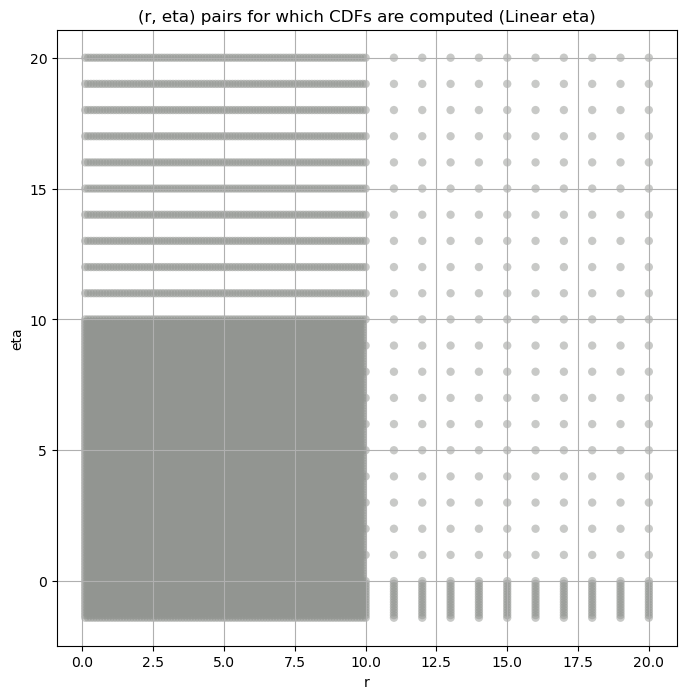

,"(r,eta),cdf",r,eta,cdf,variance,kurtosis
0,"((0.1, -1.4), <scipy.interpolate._fitpack2.Int...",0.1,-1.4,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.628800e+06,554265.000000
1,"((0.1, -1.3), <scipy.interpolate._fitpack2.Int...",0.1,-1.3,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.991680e+07,96192.272727
2,"((0.1, -1.2), <scipy.interpolate._fitpack2.Int...",0.1,-1.2,<scipy.interpolate._fitpack2.InterpolatedUniva...,2.395008e+08,29390.000000
3,"((0.1, -1.1), <scipy.interpolate._fitpack2.Int...",0.1,-1.1,<scipy.interpolate._fitpack2.InterpolatedUniva...,1.037837e+09,11997.692308
4,"((0.1, -1.0), <scipy.interpolate._fitpack2.Int...",0.1,-1.0,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.632429e+09,5874.890110


In [7]:
warnings.filterwarnings('ignore', category=RuntimeWarning)

all_cdfs_df = create_kurt_var_ksstat_df(all_cdfs)
fine_cdfs_df = all_cdfs_df.copy()
all_cdfs_df = all_cdfs_df[(np.round(all_cdfs_df['r'], 1) == all_cdfs_df['r']) & (np.round(all_cdfs_df['eta'], 1) == all_cdfs_df['eta'])]
all_cdfs_df = all_cdfs_df.reset_index(drop=True)
all_cdfs = {x[0] : x[1] for x in all_cdfs_df["(r,eta),cdf"]}
                                             
var_values_dict = dict()
kurt_values_dict = dict()
master_df = pd.DataFrame(columns=[GROUP]).set_index(GROUP)
temp_cdf = all_cdfs_df
print(f"Running {all_cdfs_df.shape[0]} CDFs")
create_scatter_plot(all_cdfs_df);
all_cdfs_df.head()

## Bootstrapping the Variance and Kurtosis

In [8]:
n_bootstrap = int(1e3) # TODO For quick testing purposes
bootstrap_size = int(1e3) # TODO For quick testing purposes
ci = 0.99

In [9]:
bootstrap_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))
master_df_var_kurt_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

if True or not master_df_var_kurt_path.exists(): # TODO For quick testing purposes
    for group in GROUPS:
        print(f'{GROUP.capitalize()} {group}: {str(filter_group_map[group])}')
        obs_var, var_lower, var_upper, var_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                n_bootstrap=n_bootstrap, 
                                                                                bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                metric= np.var, 
                                                                                ci=ci)
        obs_kurt, kurt_lower, kurt_upper, kurt_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                    n_bootstrap=n_bootstrap, 
                                                                                    bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                    metric= stats.kurtosis, ci=ci)  
        master_df.loc[group, 'obs_var'], master_df.loc[group, 'var_lower'], master_df.loc[group, 'var_upper'] = obs_var, var_lower, var_upper
        master_df.loc[group, 'obs_kurt'], master_df.loc[group, 'kurt_lower'], master_df.loc[group, 'kurt_upper'] = obs_kurt, kurt_lower, kurt_upper
        master_df.loc[group, 'total_samples'] = group_total_samples[group]
        master_df.loc[group, 'filter_group'] = str(filter_group_map[group])

    master_df.to_csv(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

master_df = pd.read_csv(master_df_var_kurt_path, index_col=GROUP)
var_kurt_df = pd.read_csv(bootstrap_path, index_col=GROUP)
master_df

Filter_idx 0: (2.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 1: (2.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 2: (2.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 3: (2.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 4: (2.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 5: (2.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 6: (2.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 7: (2.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 8: (2.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 9: (2.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 10: (2.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 11: (2.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 12: (2.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 13: (2.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 14: (3.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 15: (3.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 16: (3.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 17: (3.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 18: (3.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 19: (3.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 20: (3.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 21: (3.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 22: (3.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 23: (3.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 24: (3.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 25: (3.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 26: (3.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 27: (3.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 28: (4.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 29: (4.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 30: (4.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 31: (4.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 32: (4.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 33: (4.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 34: (4.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 35: (4.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 36: (4.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 37: (4.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 38: (4.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 39: (4.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 40: (4.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 41: (4.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group
filter_idx,,,,,,,,
0,17819.649815,14133.666151,22397.163289,5.220748,2.292364,18.383724,97416000.0,"(2.0, 0.5, 0.044)"
1,9613.998902,7362.581520,12698.829090,8.201643,3.945241,18.094728,97416000.0,"(2.0, 0.5, 0.065)"
2,5046.436757,3639.541954,6941.209191,14.557165,6.848337,22.125476,97416000.0,"(2.0, 0.5, 0.096)"
3,1729.833284,1220.814882,2365.257483,15.329418,7.572456,24.007473,97416000.0,"(2.0, 0.5, 0.141)"
4,404.015546,281.860747,555.373326,15.687551,7.403454,60.714712,97416000.0,"(2.0, 0.5, 0.208)"
5,69.997681,47.011946,117.319540,29.976179,5.976963,184.701280,97416000.0,"(2.0, 0.5, 0.306)"
6,33.089132,22.658990,72.773299,48.875998,5.926791,289.257781,97416000.0,"(2.0, 0.5, 0.45)"
7,22268.466854,18051.940989,28577.944689,6.060725,2.436149,35.173910,97416000.0,"(2.0, 1.0, 0.044)"
8,10992.351839,8276.177786,14739.030290,9.817106,3.688564,32.816411,97416000.0,"(2.0, 1.0, 0.065)"


## Initial Grid Search and Hypothesis Test Plots

In [10]:
EXCLUDE_CUTOFFS = [0, 50, 100, 200] # TODO For quick testing purposes
SCALE_CAP = 1e5

In [11]:
augmented_var_df_path = Path(os.path.join(CWD, "CSVs", "augmented_var_df.csv"))
augmented_var_df = var_kurt_df[['obs_var']].copy()
augmented_var_df
for val in EXCLUDE_CUTOFFS:
    temp_arr = []
    for group in GROUPS:
        if val != 0:
            temp_arr.append(np.var(group_data_map[group][val:-val]))
        else:
            temp_arr.append(np.var(group_data_map[group]))

    augmented_var_df[f"var_exclude_{val}"] = temp_arr
augmented_var_df

,obs_var,var_exclude_0,var_exclude_50,var_exclude_100,var_exclude_200
filter_idx,,,,,
0,17819.649815,17819.649815,17073.099237,16600.600121,15877.592900
1,9613.998902,9613.998902,9128.053836,8815.167675,8312.686016
2,5046.436757,5046.436757,4706.135684,4451.919145,4071.529150
3,1729.833284,1729.833284,1610.310250,1523.008337,1390.376966
4,404.015546,404.015546,374.611119,355.156170,325.870044
5,69.997681,69.997681,62.497838,59.183832,54.403100
6,33.089132,33.089132,29.011194,27.584424,25.508501
7,22268.466854,22268.466854,21222.575950,20643.084660,19775.732156
8,10992.351839,10992.351839,10331.210280,9908.062708,9278.983262


####
Filter_idx, 0: (2.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 0 0.0034768289176119183 17819.649814859404


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 50 0.00433761902803112 17073.09923695834


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 100 0.0043343518784748625 16600.600121054824


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 200 0.005420264633823418 15877.592900445587
Number of samples: 100000, Without approximation : 97416000.0


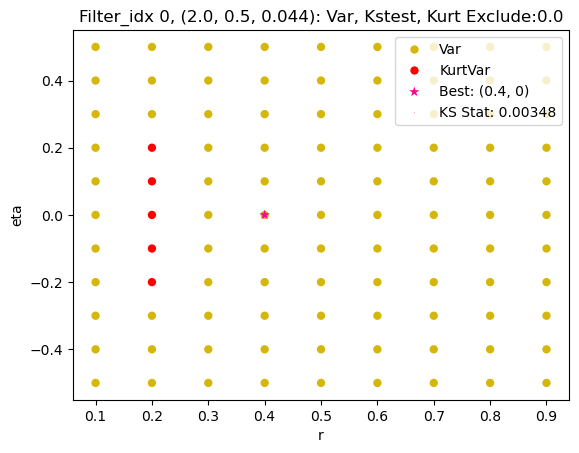

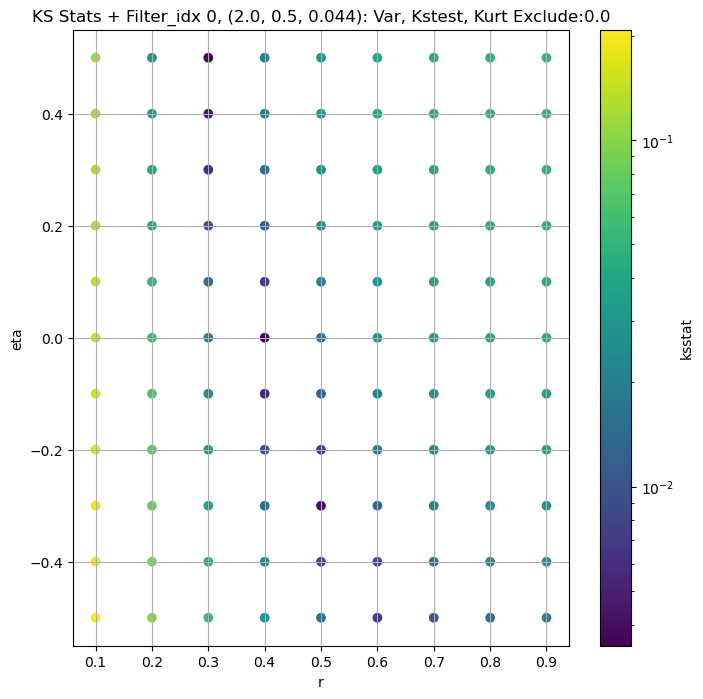

####
Filter_idx, 1: (2.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 0 0.0024667560778557363 9613.998901525669


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 50 0.0024520446744697843 9128.053836039287


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 100 0.00316843333914121 8815.16767535757


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 200 0.004190493488702042 8312.686015955658
Number of samples: 100000, Without approximation : 97416000.0


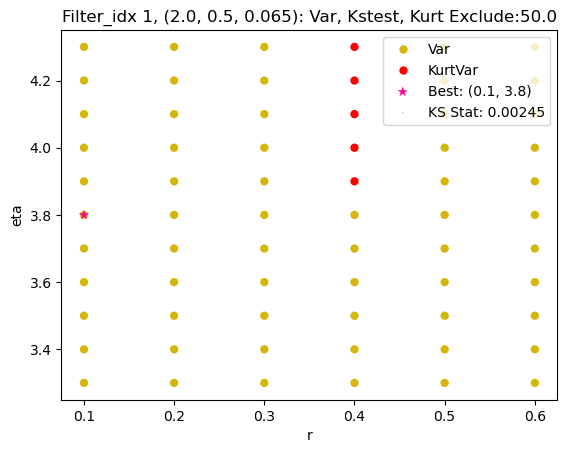

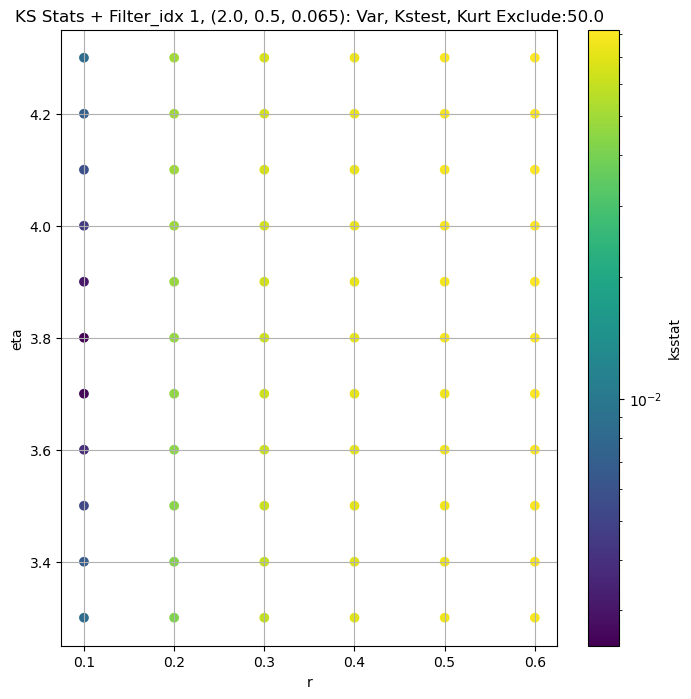

####
Filter_idx, 2: (2.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 0 0.007976862189254086 5046.436757298134


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 50 0.006580901797710315 4706.13568402371


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 100 0.005153842552133109 4451.919145159676


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 200 0.004264490595287662 4071.52914952204
Number of samples: 100000, Without approximation : 97416000.0


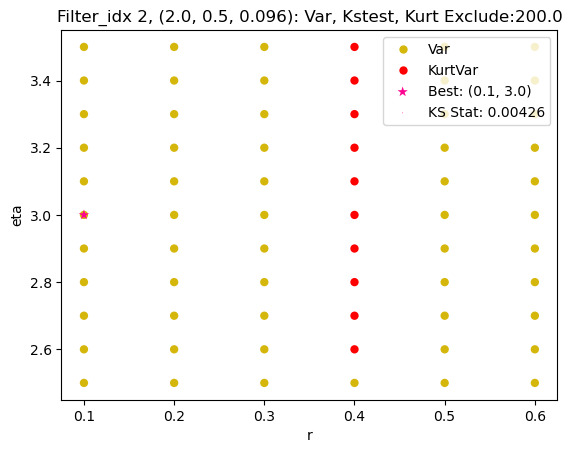

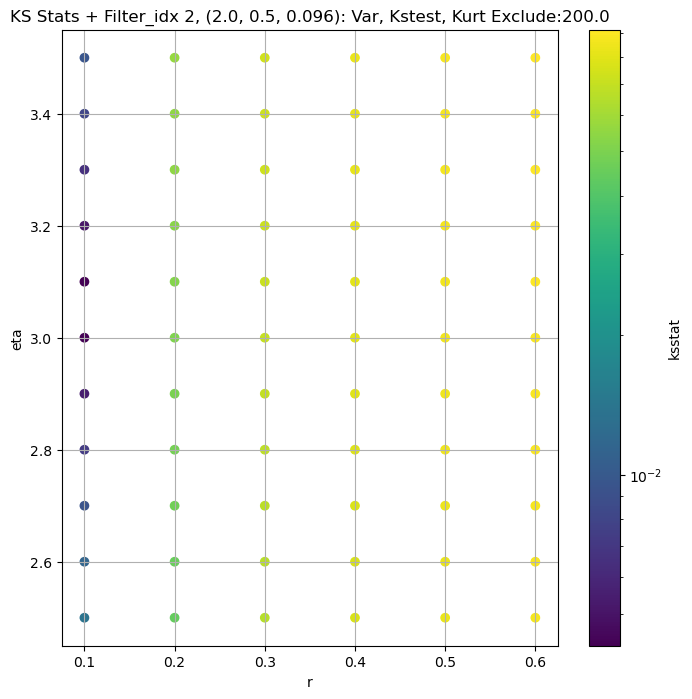

####
Filter_idx, 3: (2.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 0 0.007813388893528062 1729.8332841714628


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 50 0.0064712998638749575 1610.3102504188523


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 100 0.00539267032635235 1523.0083373985833


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 200 0.004407315885155194 1390.376966261277
Number of samples: 100000, Without approximation : 97416000.0


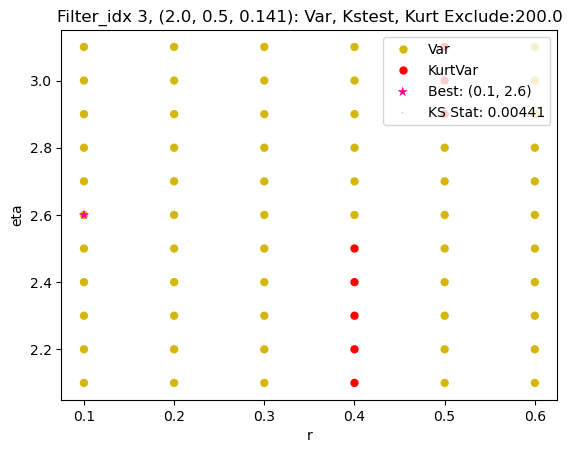

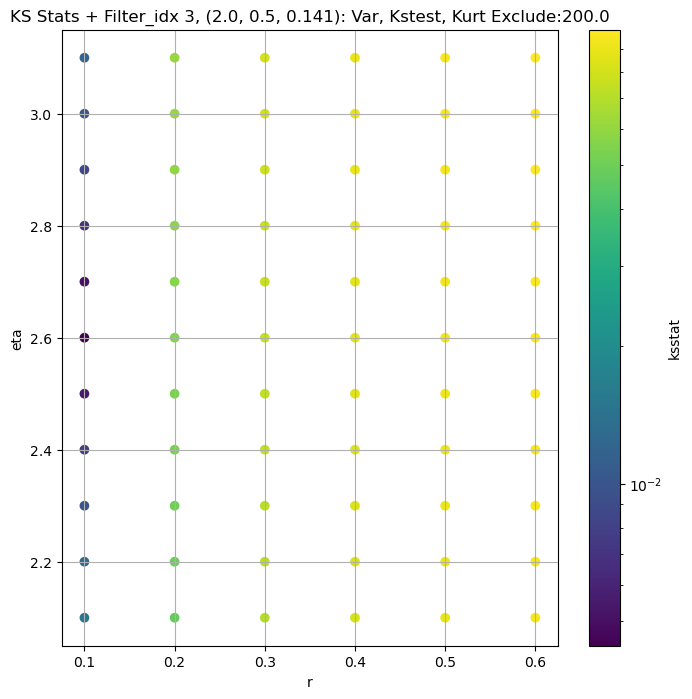

####
Filter_idx, 4: (2.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 0 0.007257648914908155 404.0155458055259


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 50 0.005618440969541005 374.61111893883736


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 100 0.004851056883257043 355.1561695546772


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 200 0.004552416716123386 325.87004355895516
Number of samples: 100000, Without approximation : 97416000.0


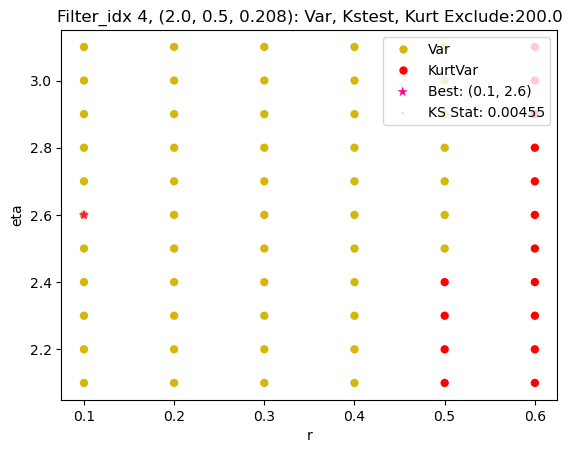

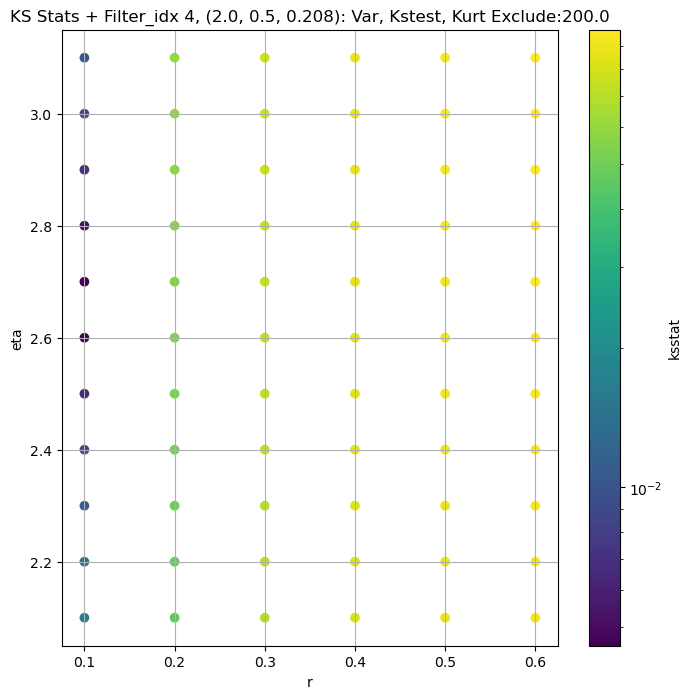

####
Filter_idx, 5: (2.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 0 0.007471910782016256 69.99768141064843


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 50 0.00473104432817209 62.497838358702296


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 100 0.004261589665074145 59.183832303143326


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 200 0.0050563680630605345 54.40309982036937
Number of samples: 100000, Without approximation : 97416000.0


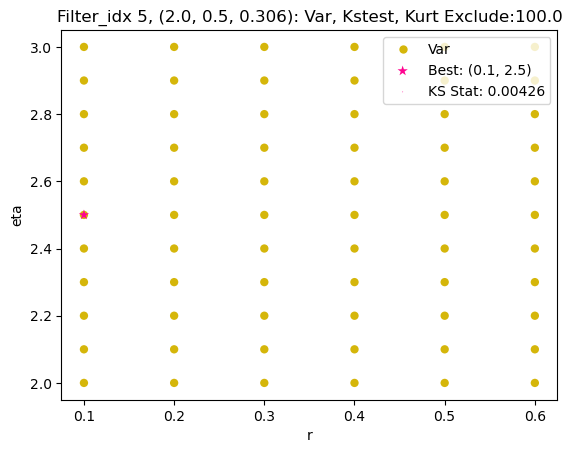

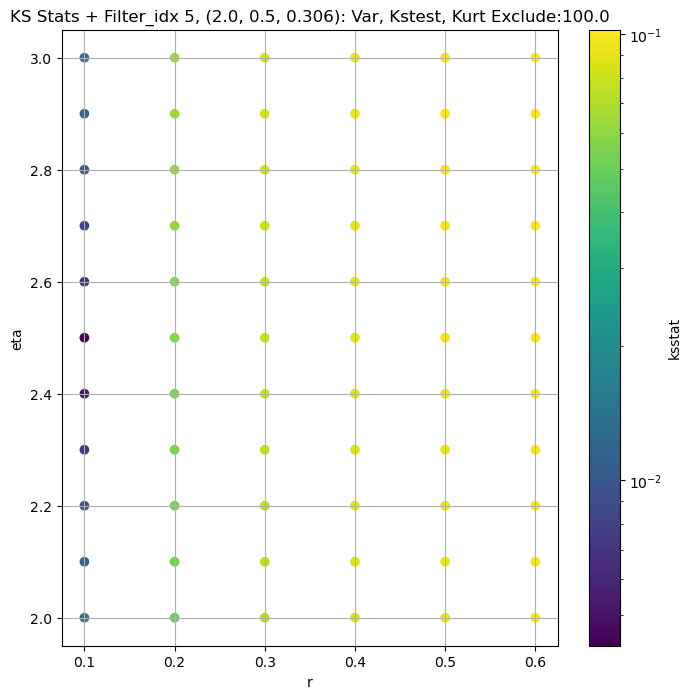

####
Filter_idx, 6: (2.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 0 0.006372536771164283 33.08913231058852


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 50 0.004065883618975641 29.011194484107378


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 100 0.003932248376982583 27.58442379207999


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 200 0.005063555914700722 25.50850082344185
Number of samples: 100000, Without approximation : 97416000.0


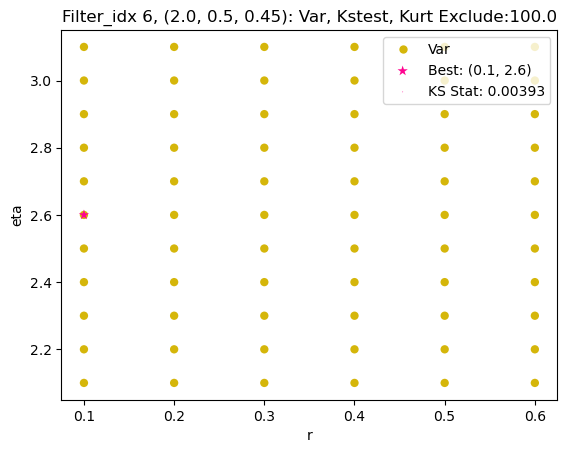

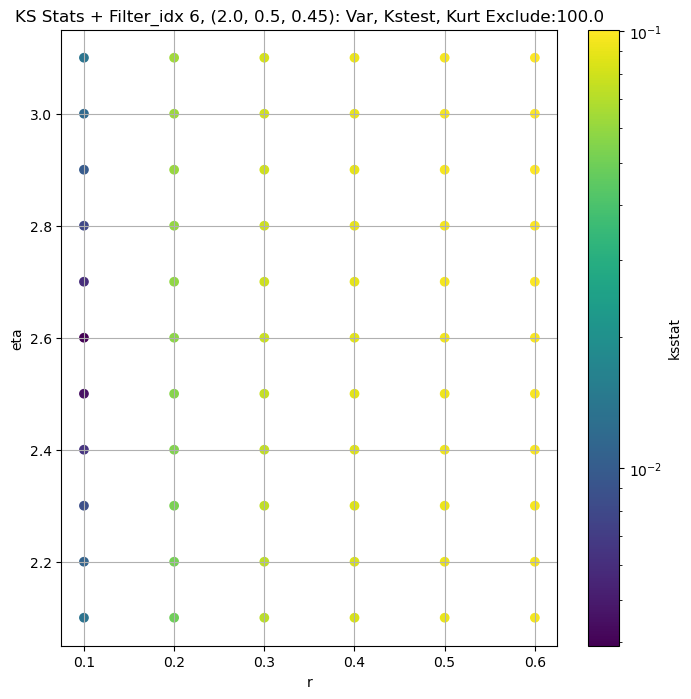

####
Filter_idx, 7: (2.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 0 0.0037692405925174866 22268.46685407241


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 50 0.004634879209569509 21222.57595032618


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 100 0.0044739229455431 20643.08465963476


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 200 0.006018891324052311 19775.73215565852
Number of samples: 100000, Without approximation : 97416000.0


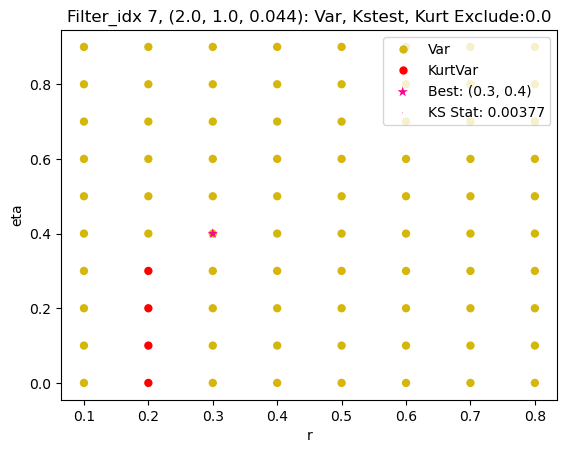

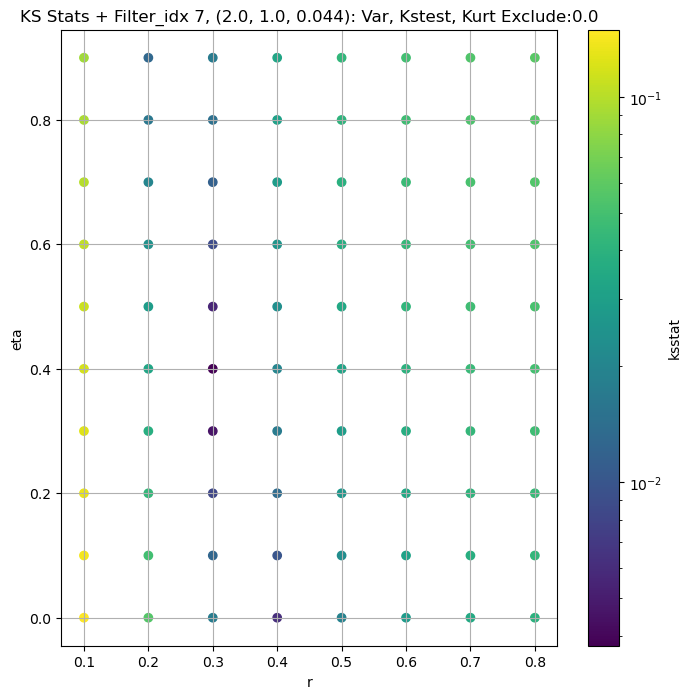

####
Filter_idx, 8: (2.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 0 0.003075464980504594 10992.351838833945


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 50 0.0022873058988322204 10331.210280484811


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 100 0.0030906674630547526 9908.06270785474


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 200 0.0041139196850070725 9278.983261551513
Number of samples: 100000, Without approximation : 97416000.0


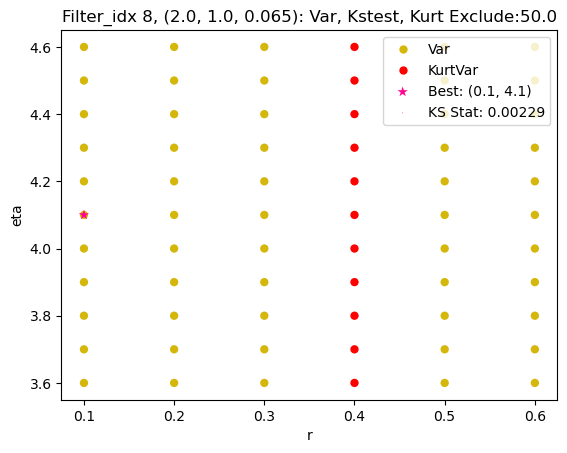

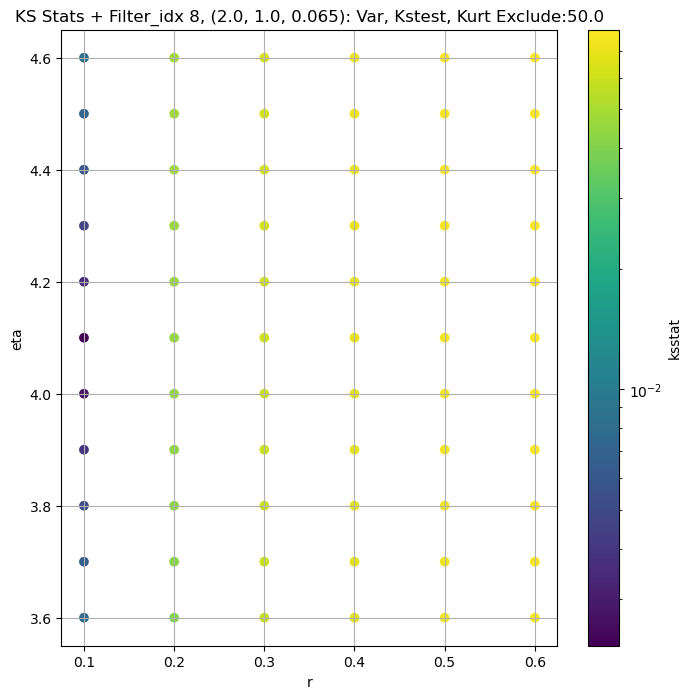

####
Filter_idx, 9: (2.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 0 0.008637421104046528 6058.278152974794


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 50 0.006185855457433609 5512.494813798668


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 100 0.004646650014934167 5191.033947203585


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 200 0.0034973506970178425 4742.190611718667
Number of samples: 100000, Without approximation : 97416000.0


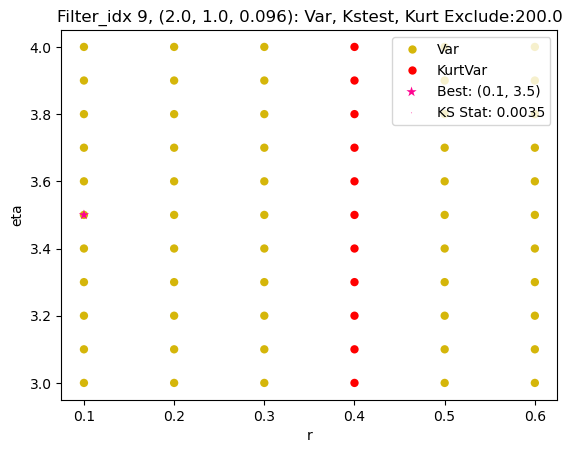

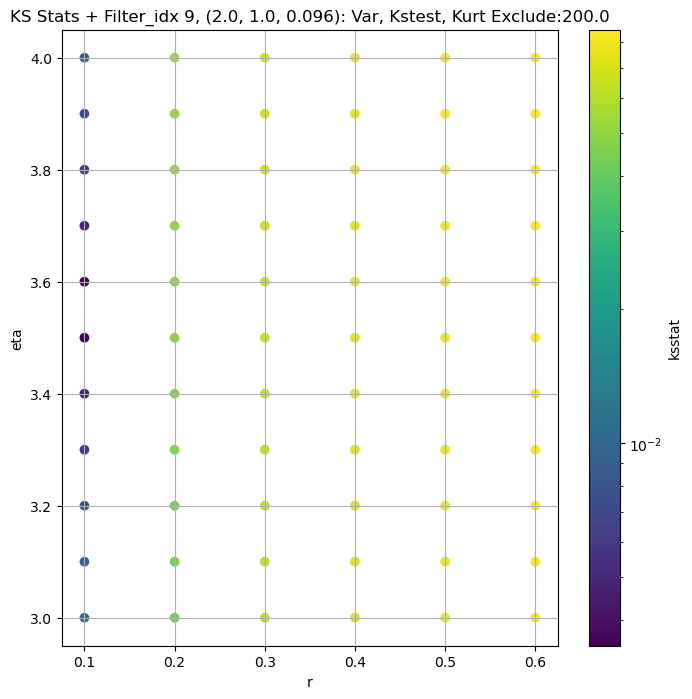

####
Filter_idx, 10: (2.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 0 0.010612176377510829 2588.4419785368195


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 50 0.008434283523678143 2372.2771597390347


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 100 0.006862245219822927 2223.229418854002


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 200 0.005076207319843706 2006.4522660370426
Number of samples: 100000, Without approximation : 97416000.0


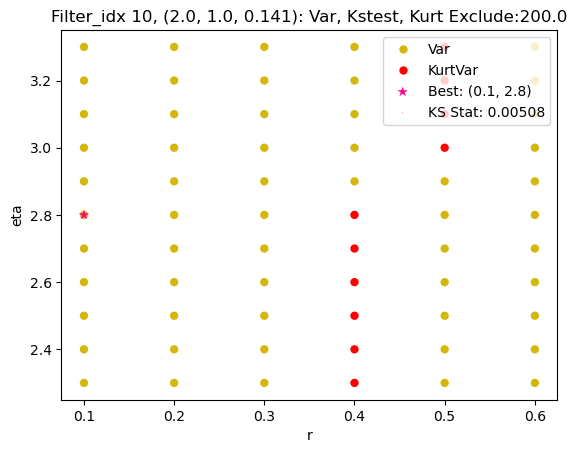

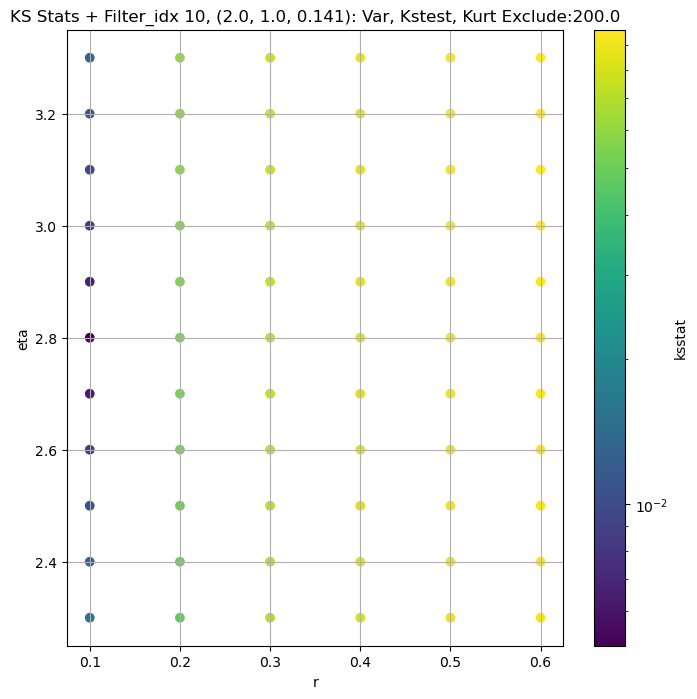

####
Filter_idx, 11: (2.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 0 0.00987031864502308 701.1605966157001


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 50 0.0076135299241499865 648.9474948015143


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 100 0.00671413406118615 614.109687174626


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 200 0.004574931193662701 561.8632210918523
Number of samples: 100000, Without approximation : 97416000.0


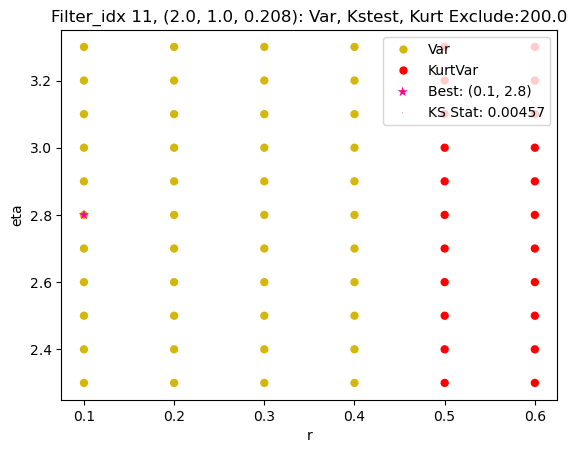

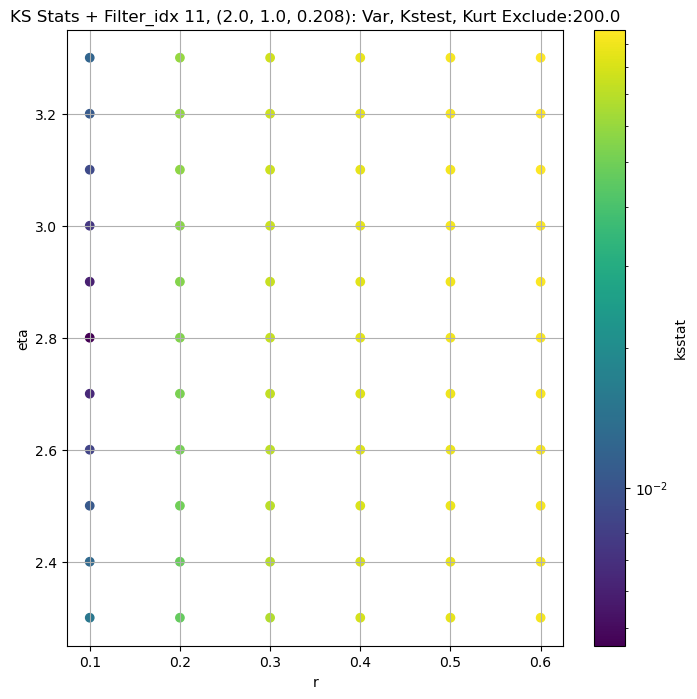

####
Filter_idx, 12: (2.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 0 0.008217250248800961 143.18810022439942


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 50 0.006208624555601755 129.8744276171017


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 100 0.005433055195906866 123.07520864061804


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 200 0.004812167212133511 113.12230962934582
Number of samples: 100000, Without approximation : 97416000.0


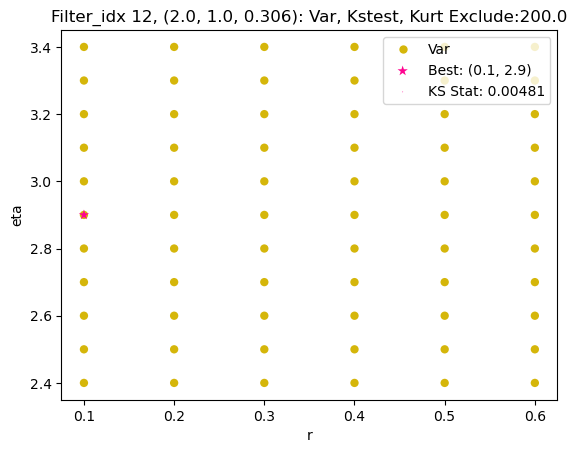

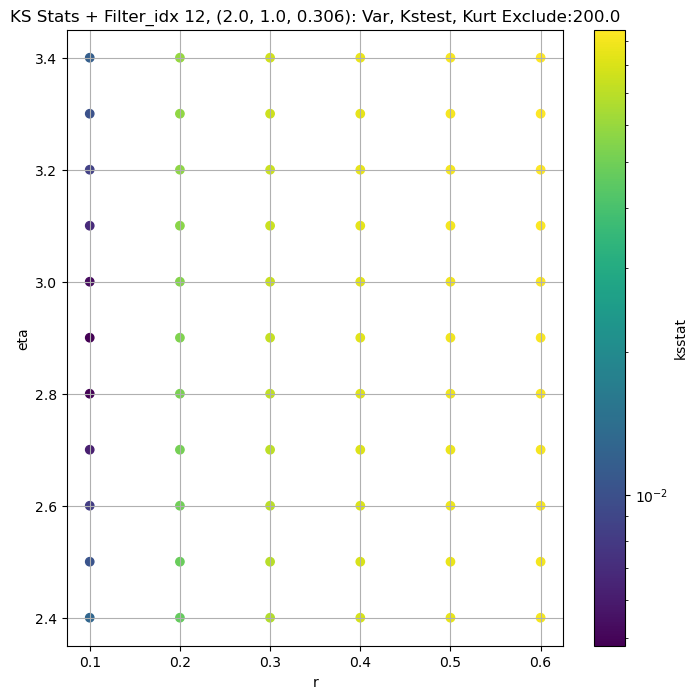

####
Filter_idx, 13: (2.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 0 0.00870539803463588 37.364078359463335


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 50 0.005915834585079743 32.13805821457728


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 100 0.005200176807630352 30.2288152466905


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 200 0.005413920759310131 27.655154475092704
Number of samples: 100000, Without approximation : 97416000.0


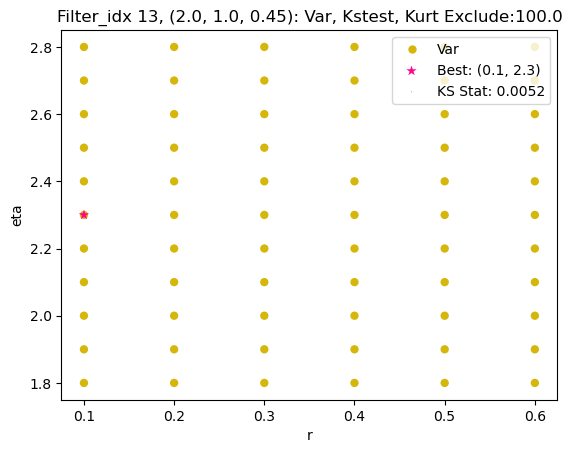

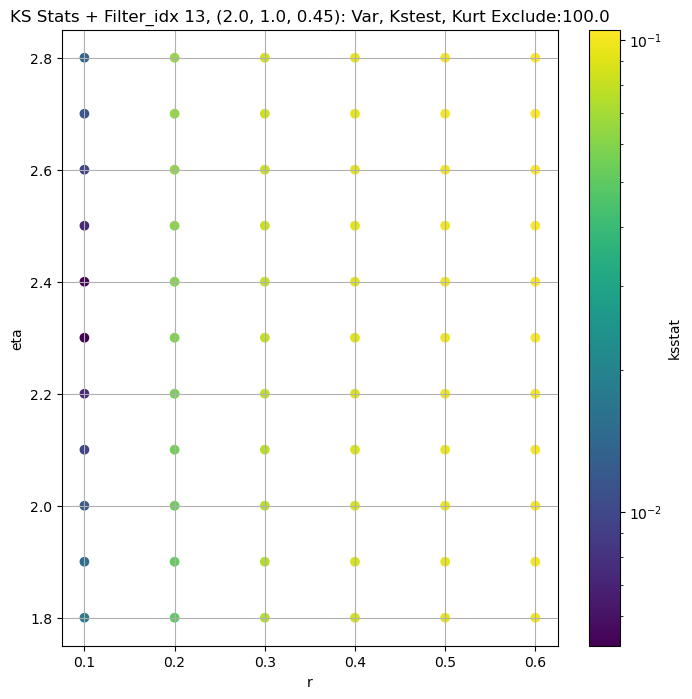

####
Filter_idx, 14: (3.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 0 0.004884114038200993 16054.87645139801


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 50 0.005935545762886851 15398.608496333367


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 100 0.005339230229294389 15008.439013730573


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 200 0.006290794498686261 14407.399929225883
Number of samples: 100000, Without approximation : 97416000.0


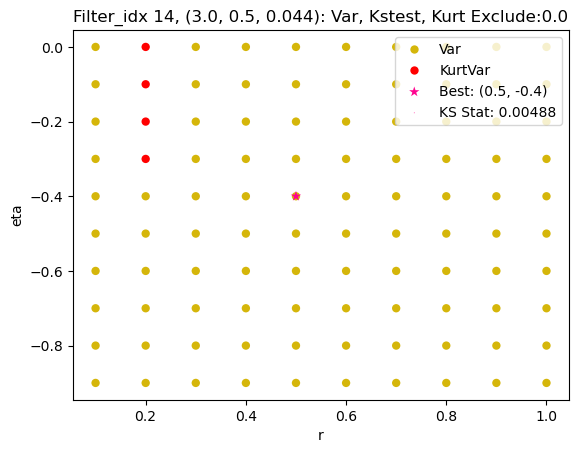

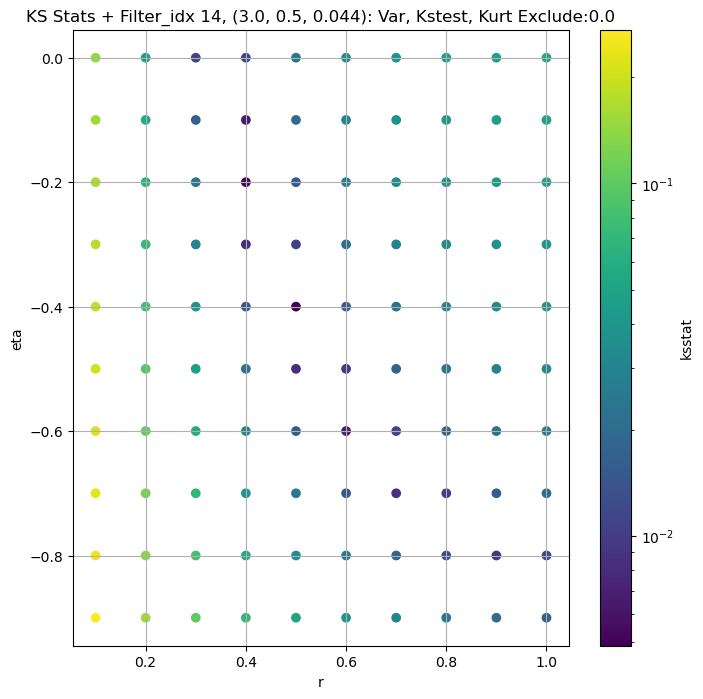

####
Filter_idx, 15: (3.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 0 0.002153312329463475 6784.055426653286


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 50 0.003332953328205268 6395.776300715608


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 100 0.00399402057559084 6178.821393229562


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 200 0.005526171553397907 5865.603558770251
Number of samples: 100000, Without approximation : 97416000.0


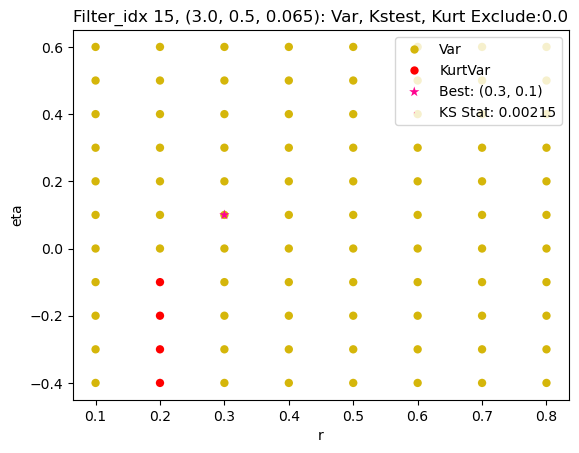

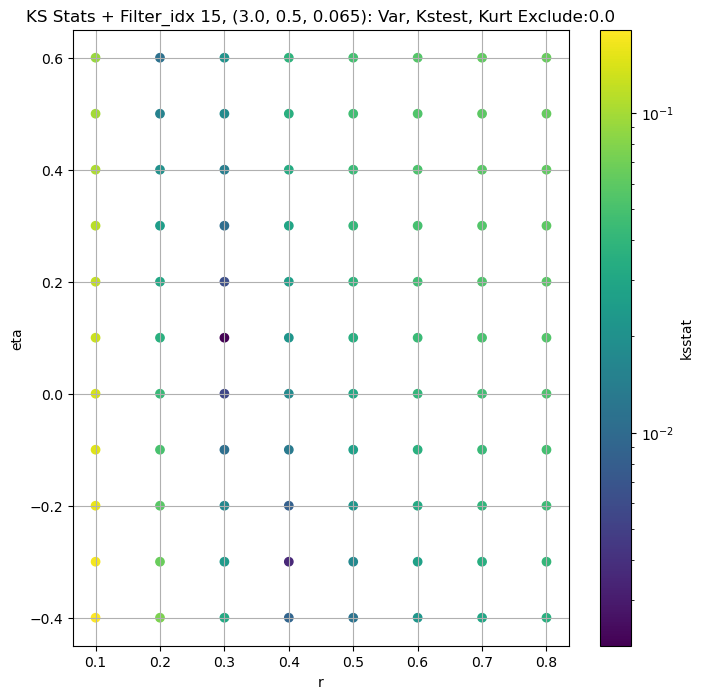

####
Filter_idx, 16: (3.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 0 0.0023073143667625695 3359.2172695191507


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 50 0.0012191375431911343 3100.7004501580564


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 100 0.0025960596502414557 2924.5571974605705


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 200 0.0030720057588461414 2661.985746206751
Number of samples: 100000, Without approximation : 97416000.0


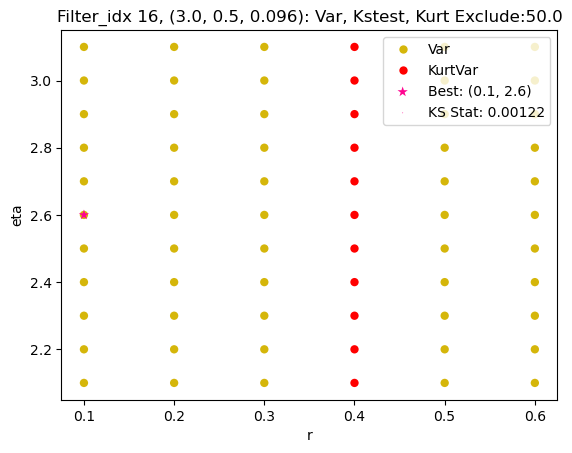

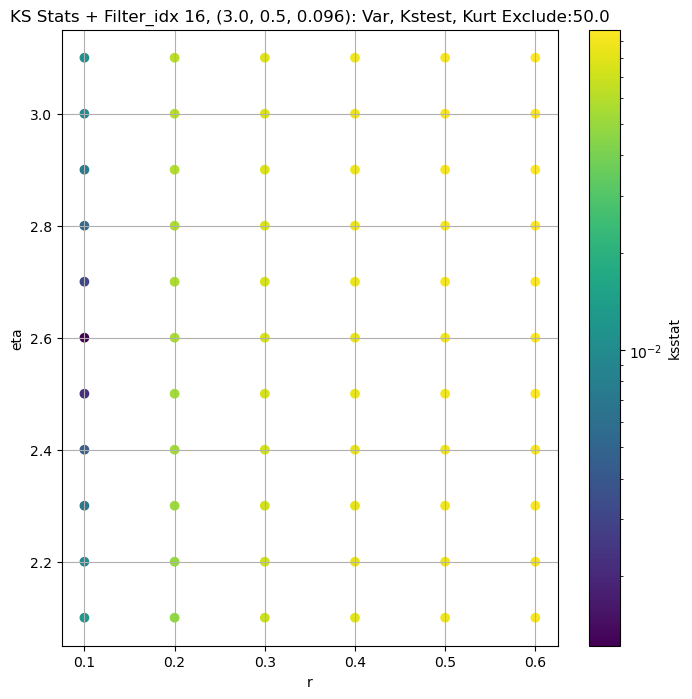

####
Filter_idx, 17: (3.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 0 0.009471499022985719 1231.115686042695


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 50 0.006345280365176911 1109.9870959925372


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 100 0.004863962830577329 1030.4215849100203


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 200 0.0035840681686150067 914.8199985436313
Number of samples: 100000, Without approximation : 97416000.0


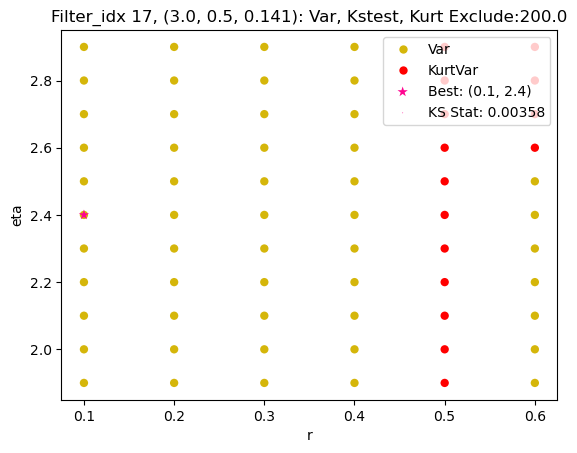

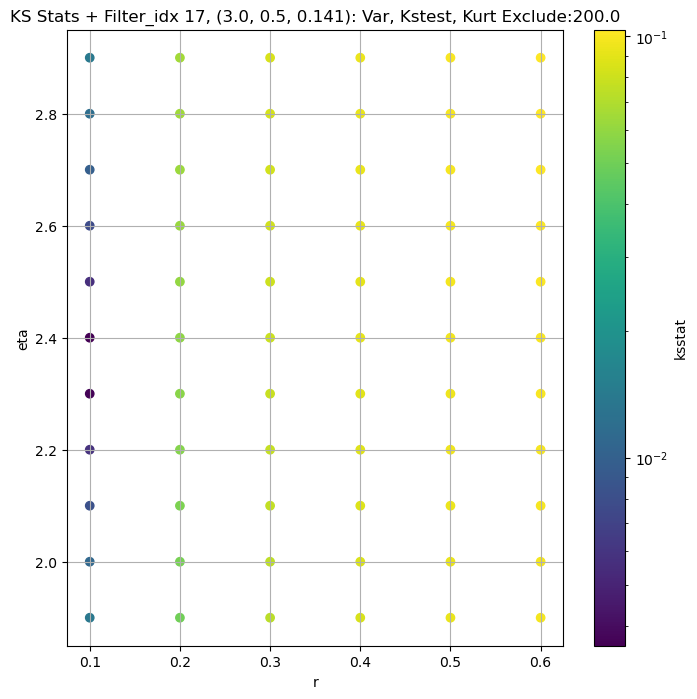

####
Filter_idx, 18: (3.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 0 0.009730620164506487 237.76462060417208


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 50 0.007308491470104178 212.43916602047528


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 100 0.006161106229959495 198.4594383137327


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 200 0.004353274601444079 177.9566191723994
Number of samples: 100000, Without approximation : 97416000.0


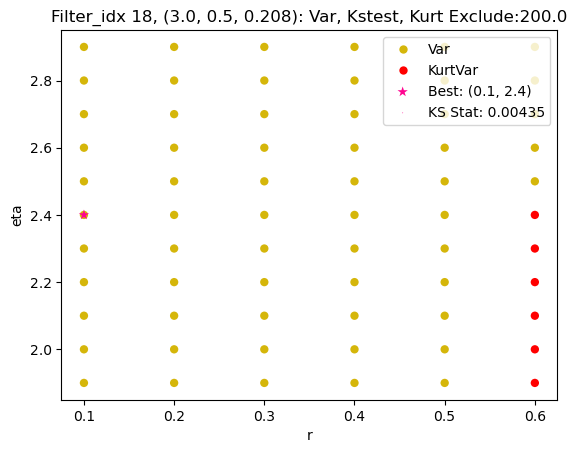

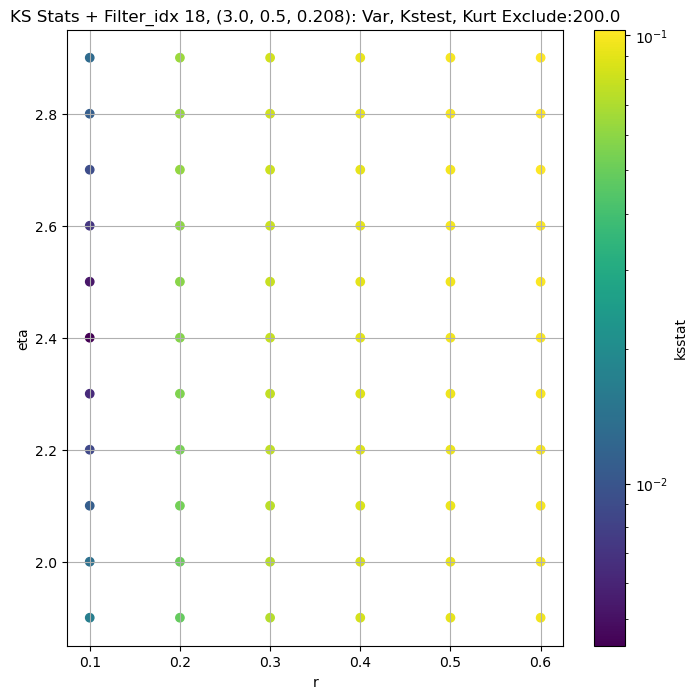

####
Filter_idx, 19: (3.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 0 0.011651390983345222 37.06332202425726


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 50 0.007427245647089797 29.463021775596246


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 100 0.006170706916410473 27.617194903959884


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 200 0.004537063825036491 25.12120094064649
Number of samples: 100000, Without approximation : 97416000.0


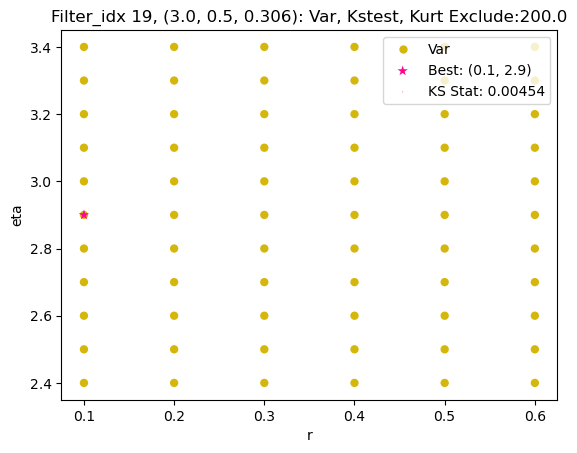

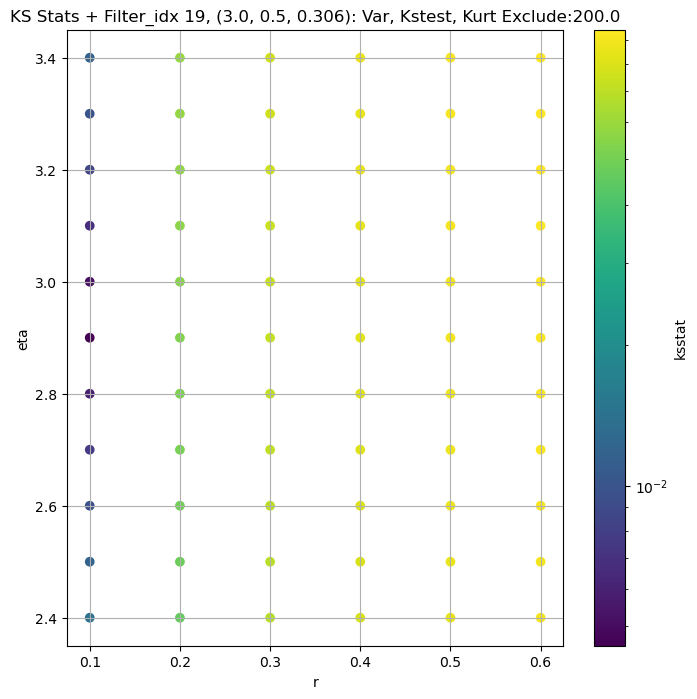

####
Filter_idx, 20: (3.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 0 0.010642148037798949 16.5231127422582


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 50 0.008183830536143355 13.932968424602409


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 100 0.006729911235592301 13.066948117102886


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 200 0.005477387402030853 11.888228593099846
Number of samples: 100000, Without approximation : 97416000.0


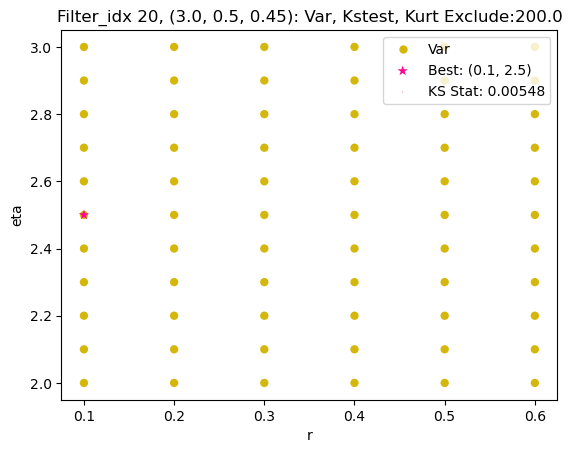

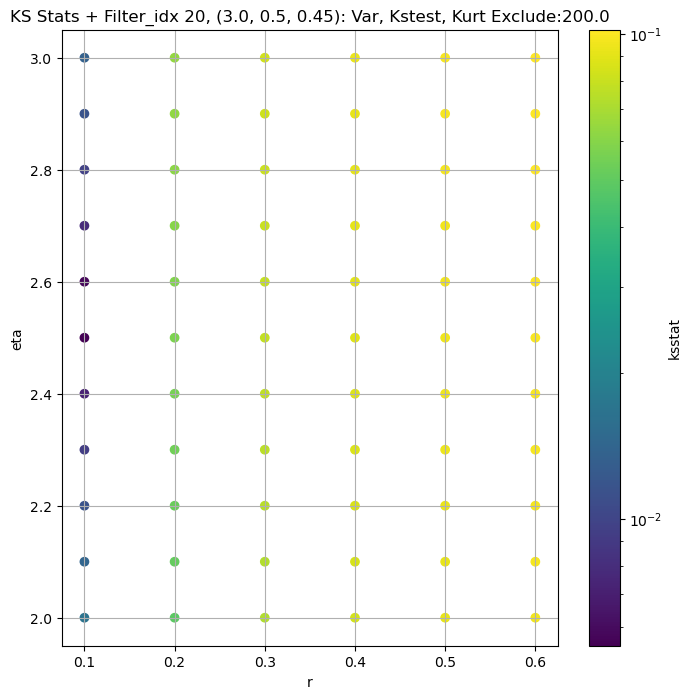

####
Filter_idx, 21: (3.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 0 0.003819450216377529 19461.664975436302


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 50 0.004684627608208793 18672.24988496827


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 100 0.005705028422207881 18191.512556446218


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 200 0.0064208184949117175 17436.42832398192
Number of samples: 100000, Without approximation : 97416000.0


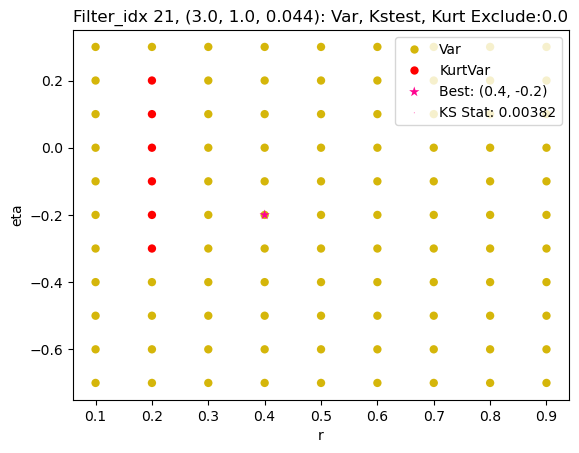

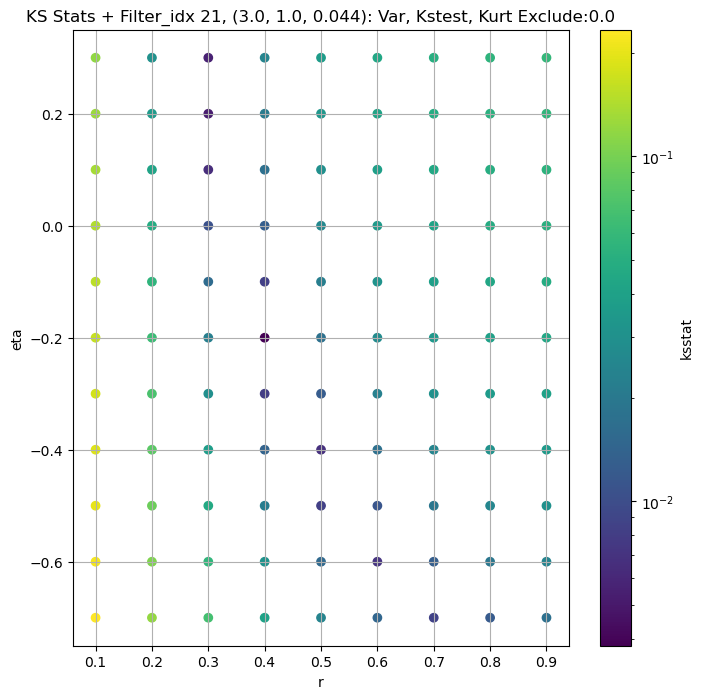

####
Filter_idx, 22: (3.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 0 0.0033315500416160673 7502.823644872465


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 50 0.0041235519318117975 7070.19921116048


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 100 0.0043925790392664865 6838.241950354838


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 200 0.005264092798258291 6485.931382732932
Number of samples: 100000, Without approximation : 97416000.0


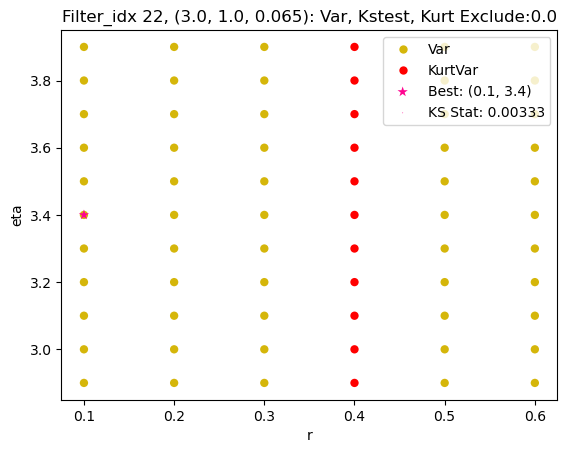

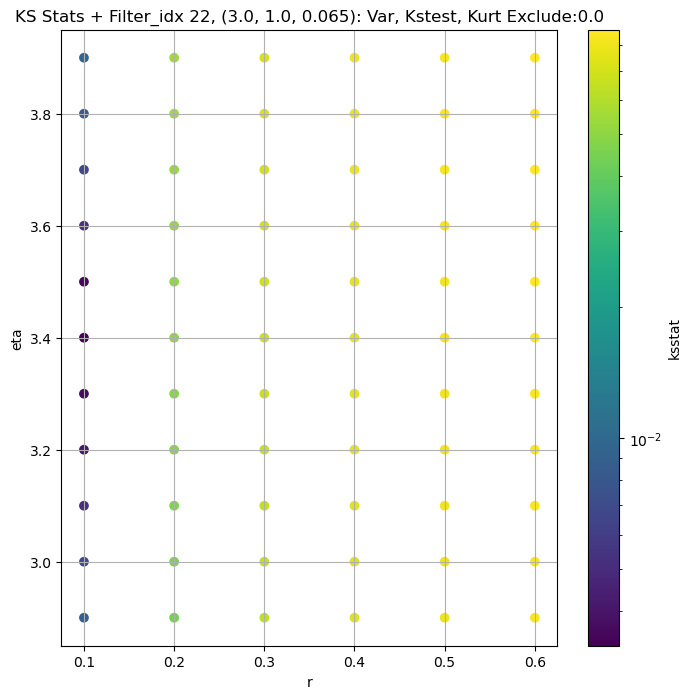

####
Filter_idx, 23: (3.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 0 0.003986235801887894 3292.0979166151396


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 50 0.002798141003030552 2944.9424610912633


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 100 0.00357288242732523 2772.2137947564306


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 200 0.005133678901642735 2564.046199146581
Number of samples: 100000, Without approximation : 97416000.0


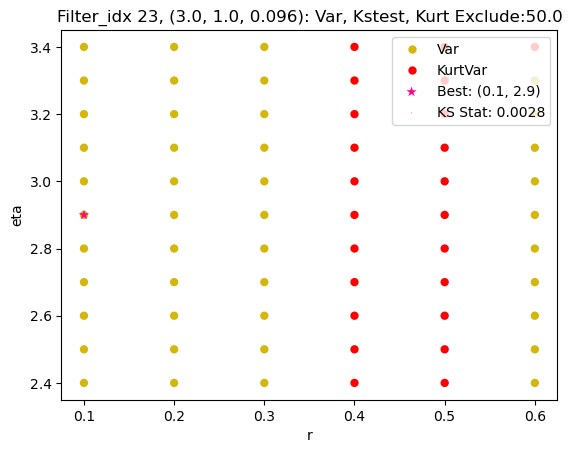

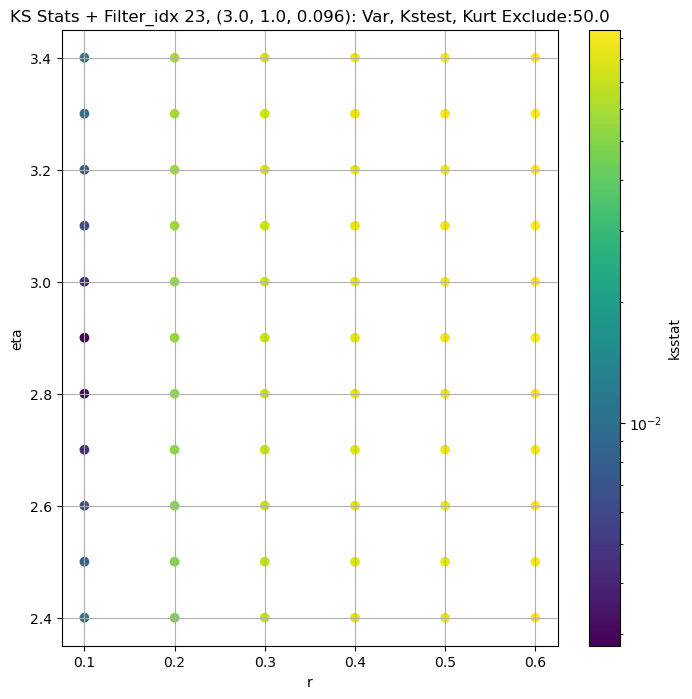

####
Filter_idx, 24: (3.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 0 0.011122731742588002 1365.8419203504109


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 50 0.008206865341457203 1187.2574870530455


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 100 0.006148150734201829 1083.7082380663176


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 200 0.0040558922949313625 949.6490696768172
Number of samples: 100000, Without approximation : 97416000.0


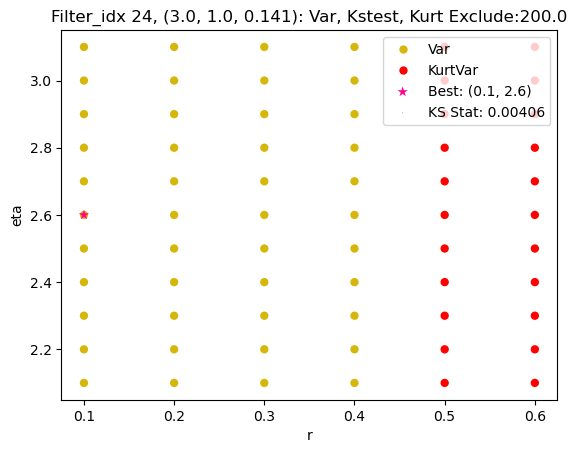

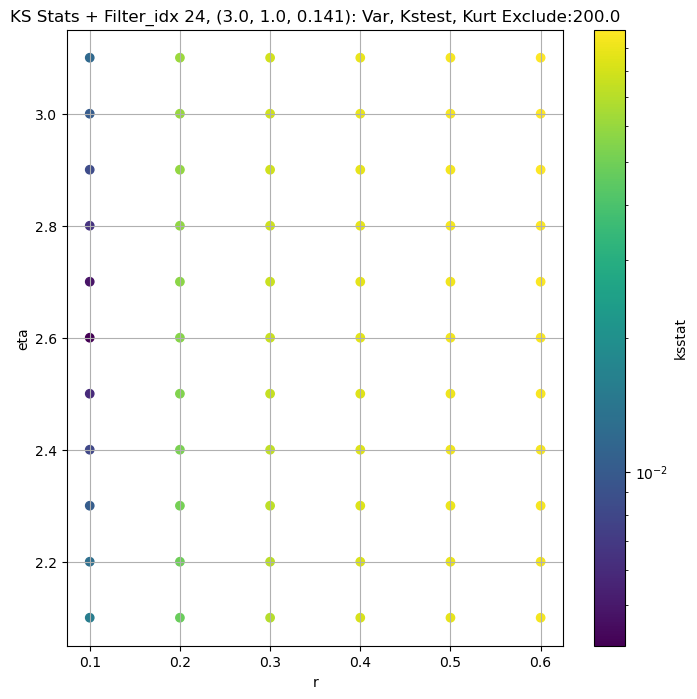

####
Filter_idx, 25: (3.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 0 0.012932365471255869 319.8684880461592


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 50 0.010125990235185012 281.0123099380844


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 100 0.009007406963545295 258.47909919466144


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 200 0.006572257697692874 226.9690110688713
Number of samples: 100000, Without approximation : 97416000.0


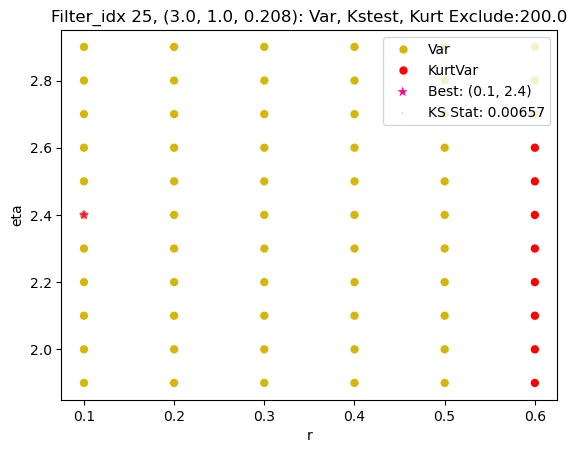

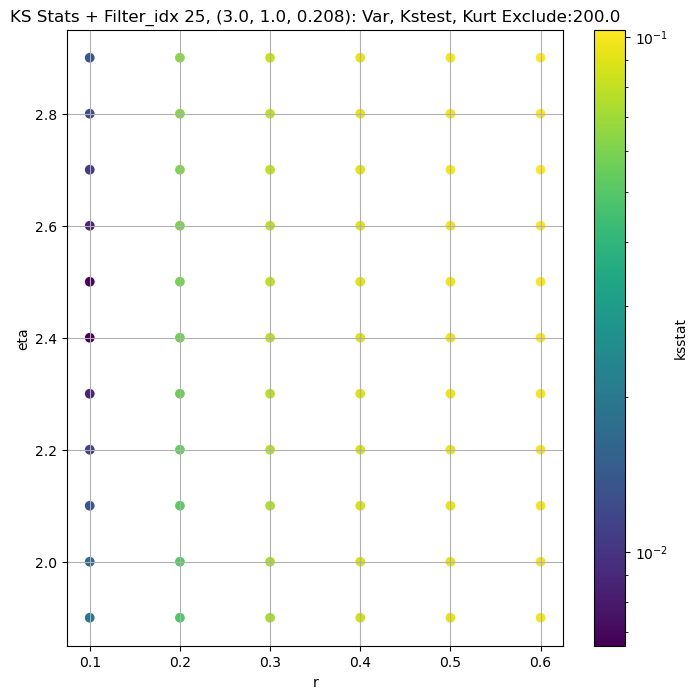

####
Filter_idx, 26: (3.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 0 0.01344847505811353 53.2279287280532


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 50 0.008928738920811308 42.61598274243361


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 100 0.007692591781248703 39.646210474248186


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 200 0.005495676293615415 35.64720801703816
Number of samples: 100000, Without approximation : 97416000.0


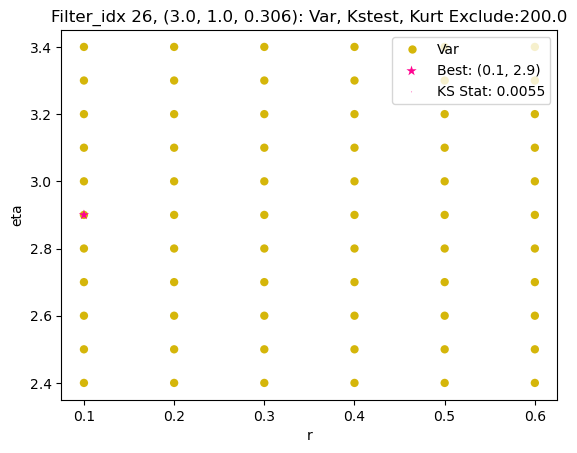

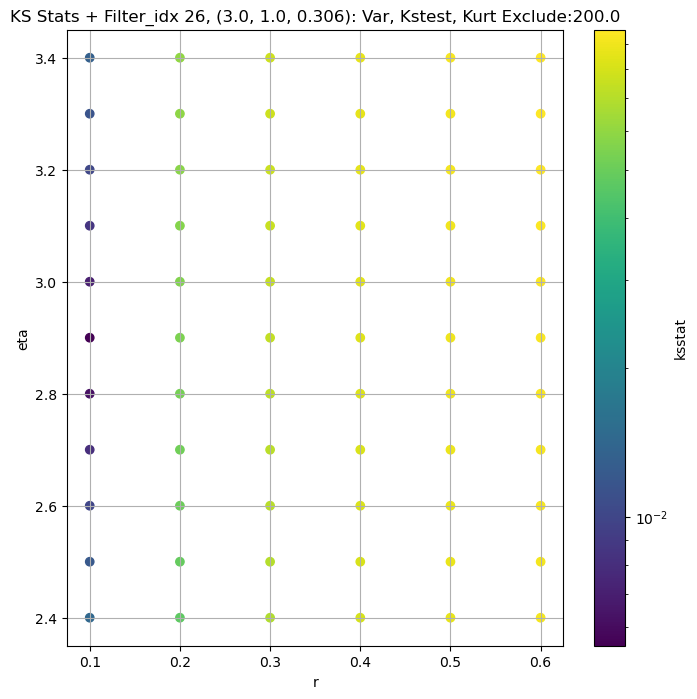

####
Filter_idx, 27: (3.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 0 0.014814018011359065 17.517926231223736


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 50 0.010653936128975028 14.029176205405797


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 100 0.008882379367283866 12.954611661678335


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 200 0.006367422575919046 11.61416459339954
Number of samples: 100000, Without approximation : 97416000.0


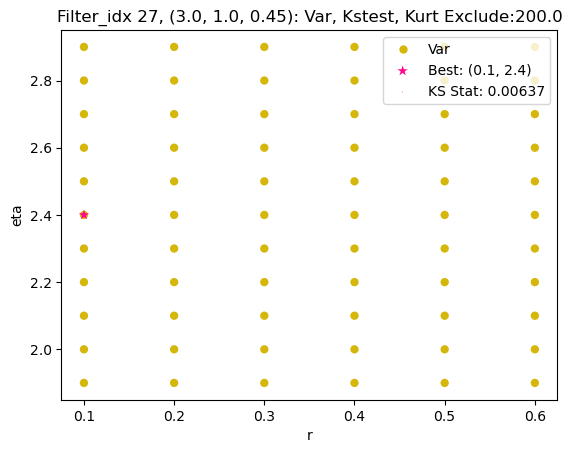

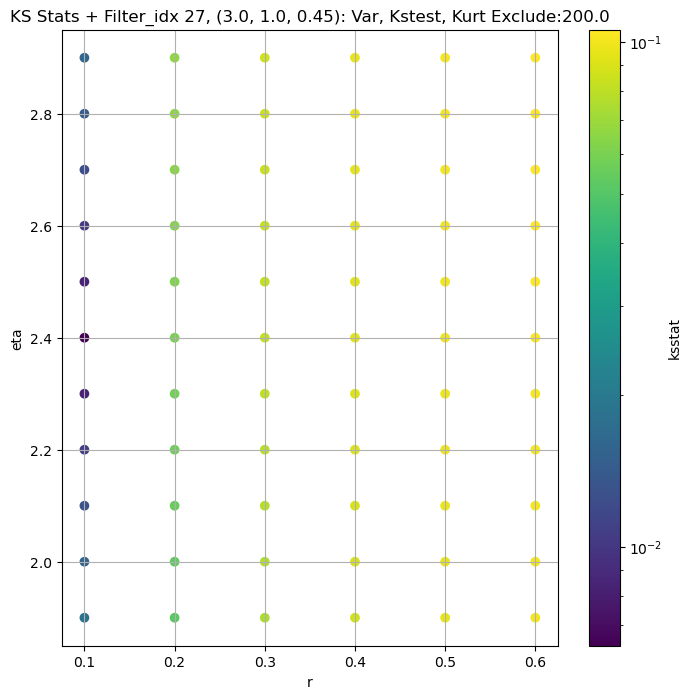

####
Filter_idx, 28: (4.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 0 0.0031057763327489996 15959.524379806357


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 50 0.004422741805061026 15339.433814716229


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 100 0.0045717481650845715 14983.790858818911


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 200 0.0053957360863705825 14429.41692528831
Number of samples: 100000, Without approximation : 97416000.0


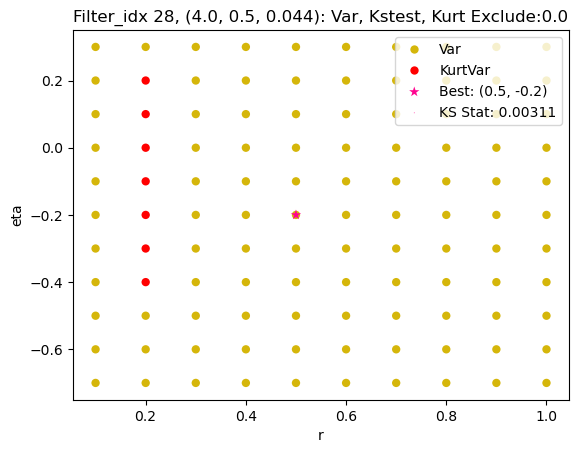

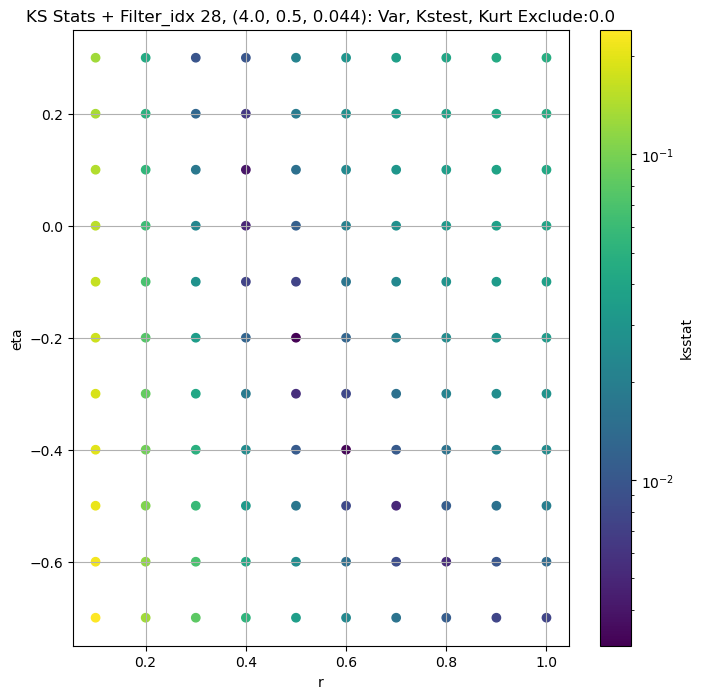

####
Filter_idx, 29: (4.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 0 0.0020875392171538776 6084.367494549321


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 50 0.0024141246443590836 5786.552070277564


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 100 0.0036350345249909974 5621.989691412358


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 200 0.004478517237940904 5369.693476278144
Number of samples: 100000, Without approximation : 97416000.0


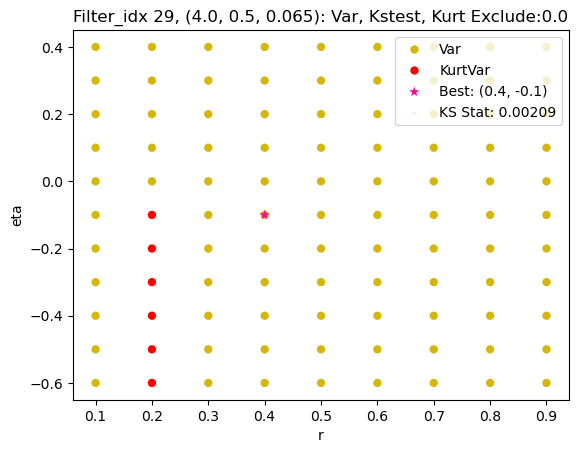

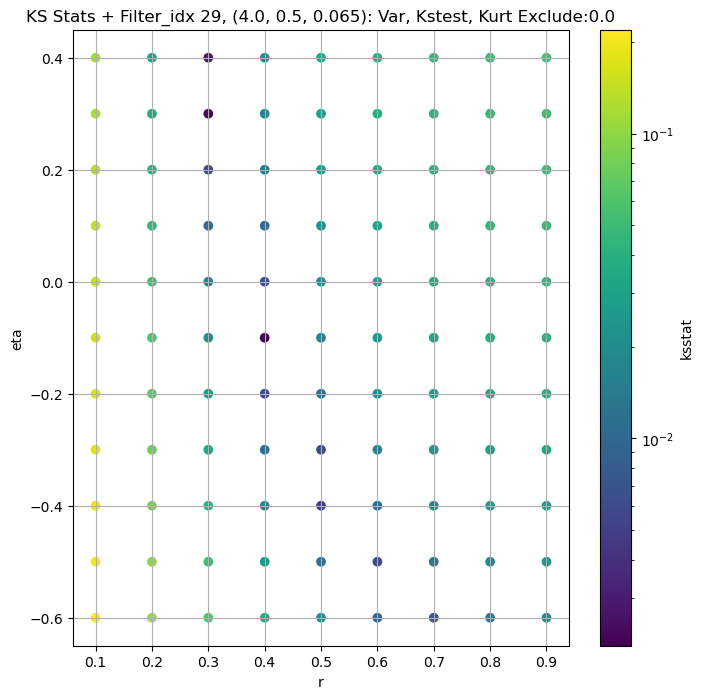

####
Filter_idx, 30: (4.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 0 0.0019824839330202515 2342.4910108625904


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 50 0.0025575478421350217 2186.7402905299086


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 100 0.0030172566508593138 2108.150250858724


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 200 0.004607942085128602 1992.5475470778777
Number of samples: 100000, Without approximation : 97416000.0


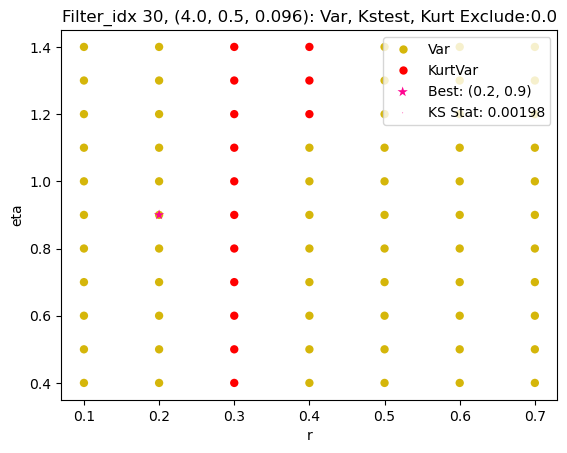

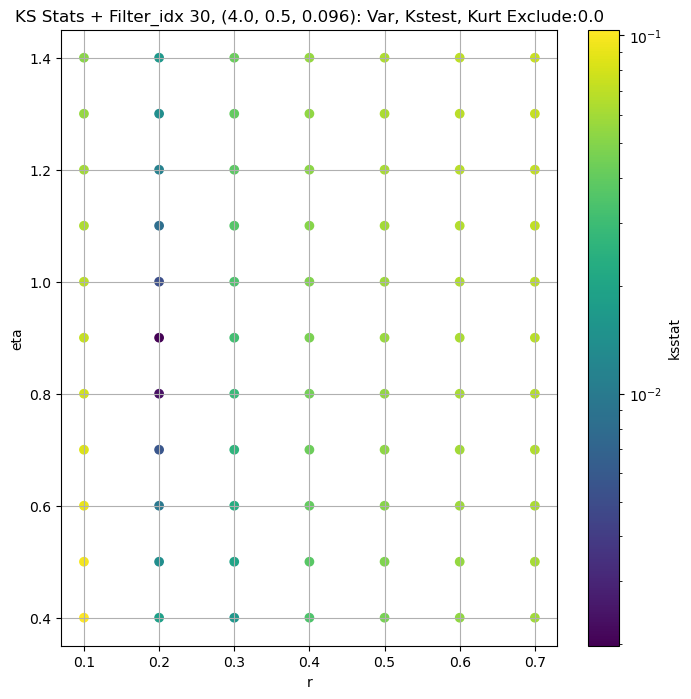

####
Filter_idx, 31: (4.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 0 0.0064566919515032795 816.9889181116595


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 50 0.003799457376361448 732.7362010654392


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 100 0.0029946282234737664 684.8335323470283


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 200 0.004036875424245134 621.8594976690248
Number of samples: 100000, Without approximation : 97416000.0


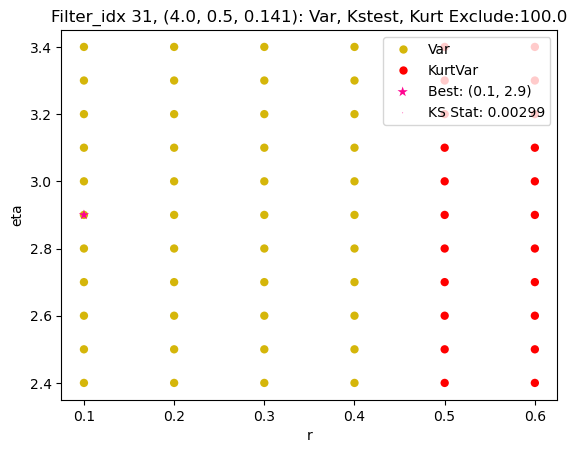

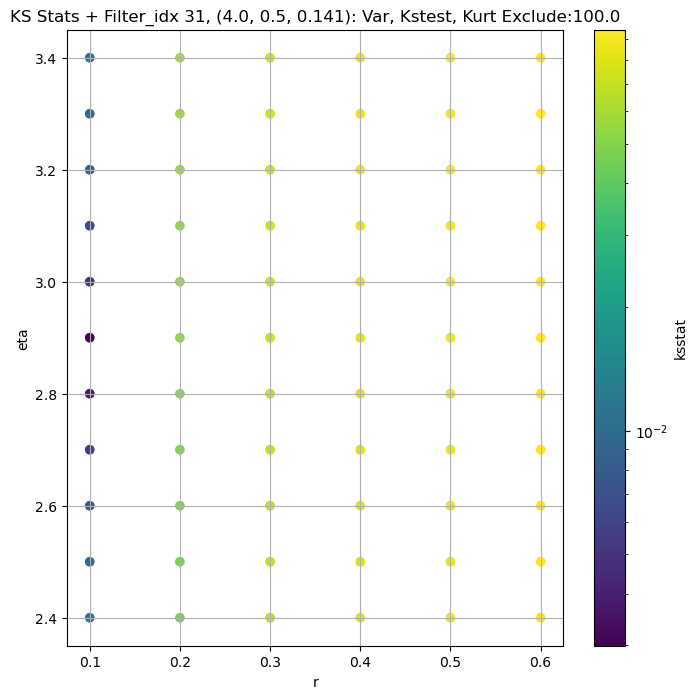

####
Filter_idx, 32: (4.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 0 0.010988547943260707 154.54519936715363


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 50 0.007598582269897514 133.70005864211947


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 100 0.005626401438273504 124.49362956360899


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 200 0.003935524156814557 111.8490808828572
Number of samples: 100000, Without approximation : 97416000.0


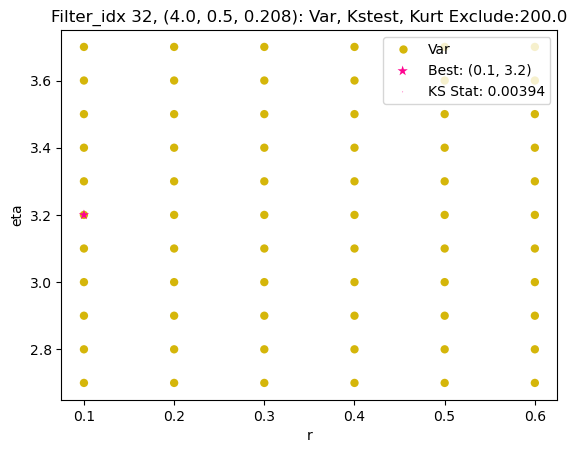

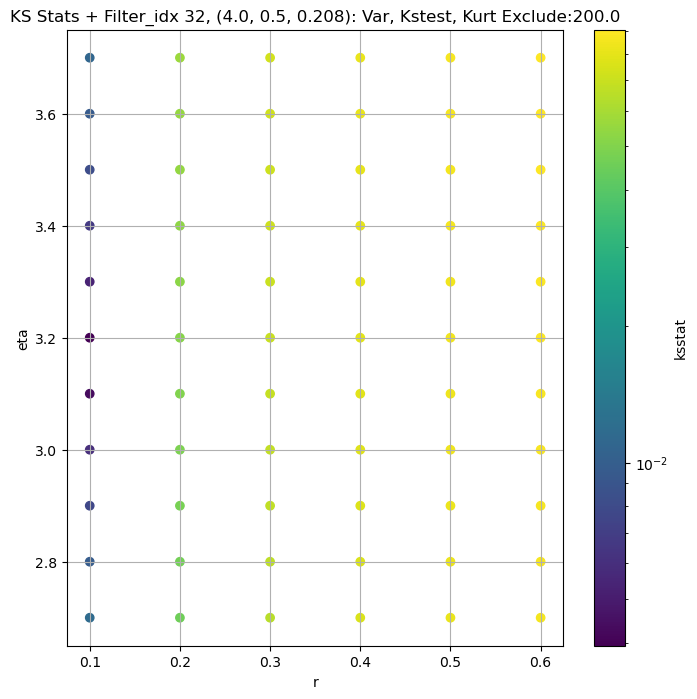

####
Filter_idx, 33: (4.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 0 0.016820735548466526 20.975535856776574


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 50 0.00643893527098216 13.576732056719965


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 100 0.005043584308786375 12.723865546210664


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 200 0.004205705761846867 11.686811879972183
Number of samples: 100000, Without approximation : 97416000.0


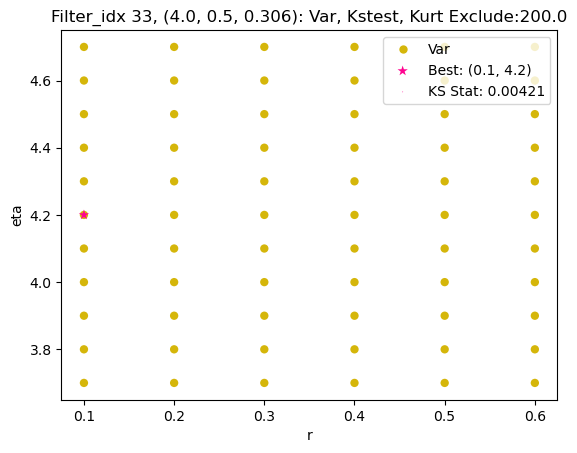

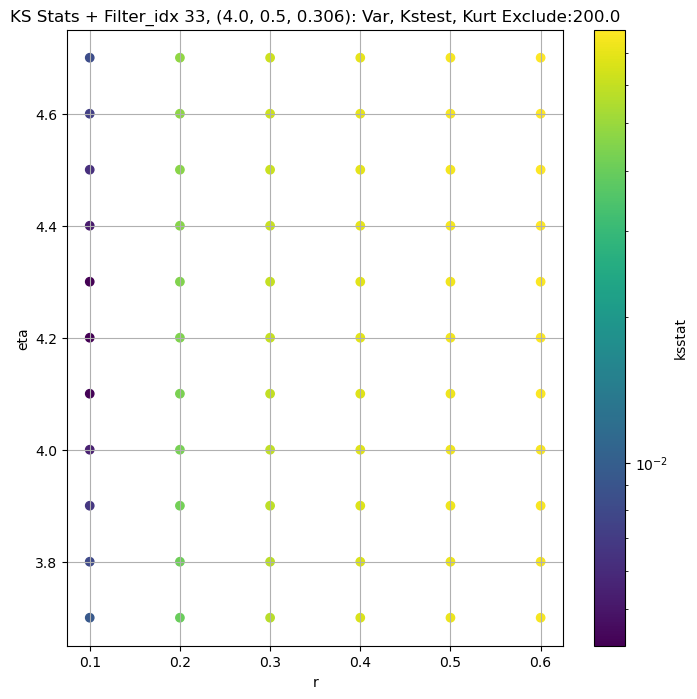

####
Filter_idx, 34: (4.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 0 0.01108212518773577 15.951136987494607


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 50 0.008344633435828142 13.809655590197233


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 100 0.007211860925518954 12.947061588160338


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 200 0.005565681117690624 11.755219815401201
Number of samples: 100000, Without approximation : 97416000.0


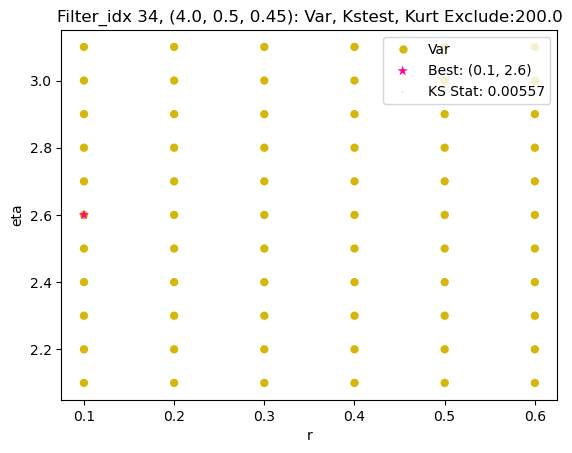

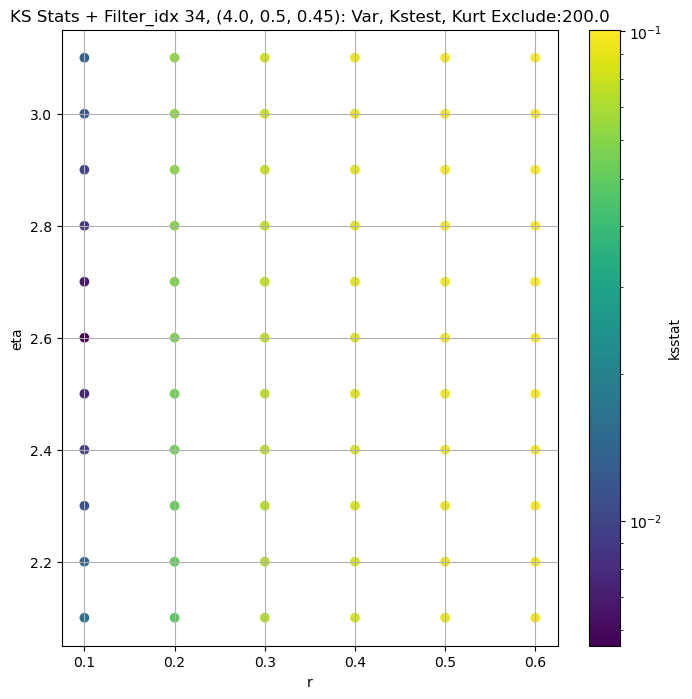

####
Filter_idx, 35: (4.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 0 0.0027248369698470998 19069.550394195438


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 50 0.003575611376488541 18407.101118804818


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 100 0.0035288394974225534 17999.83943532078


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 200 0.004767971723215636 17359.55785105297
Number of samples: 100000, Without approximation : 97416000.0


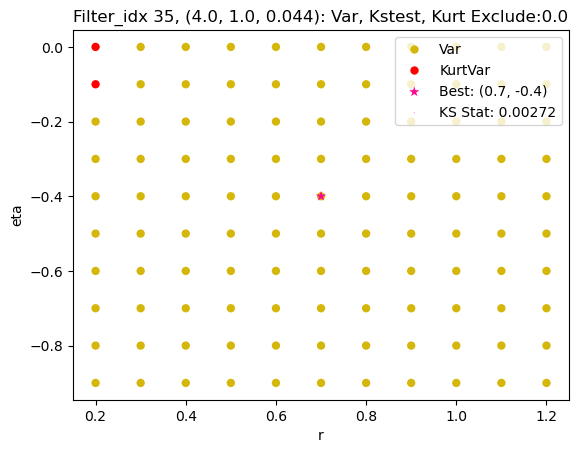

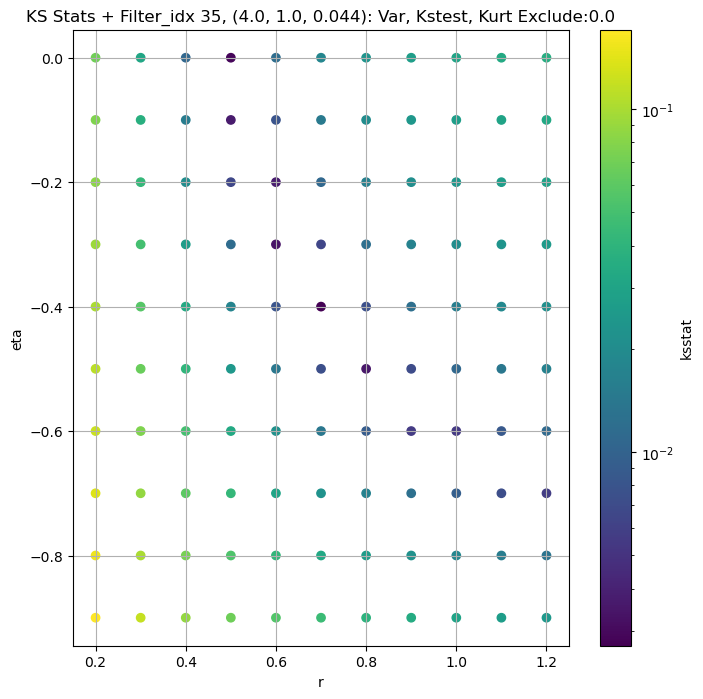

####
Filter_idx, 36: (4.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 0 0.0016842907963384168 6604.594914861366


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 50 0.0028085114527227895 6281.005340109118


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 100 0.003504382302948139 6087.951811984357


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 200 0.004548746770955757 5791.195055244963
Number of samples: 100000, Without approximation : 97416000.0


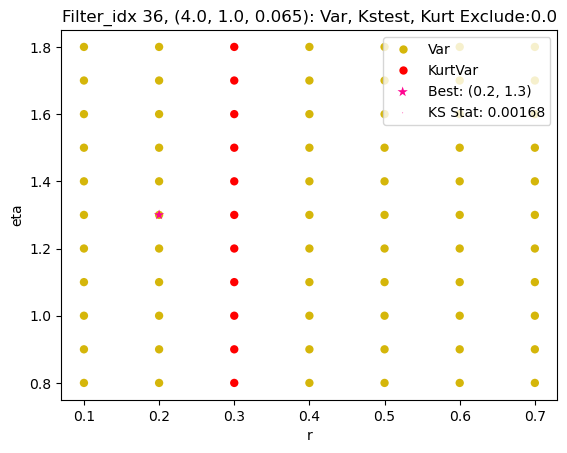

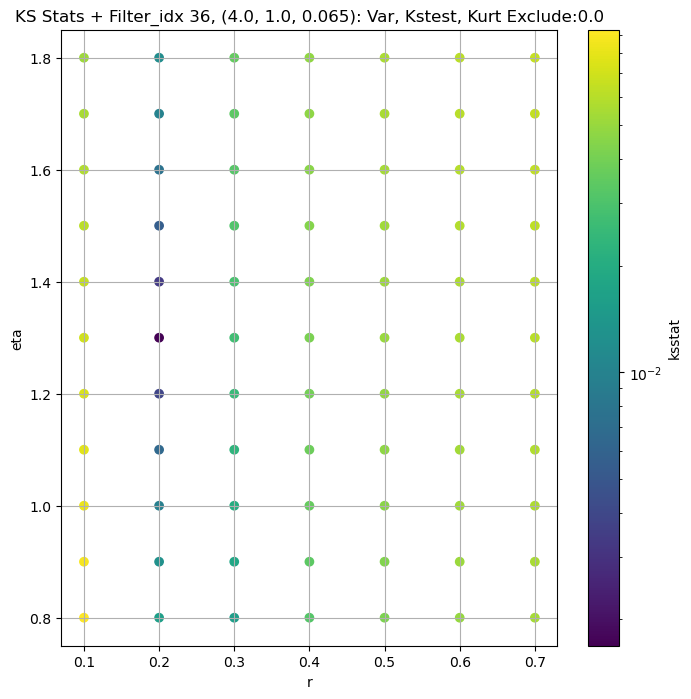

####
Filter_idx, 37: (4.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 0 0.0014856848832985048 2429.823945449952


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 50 0.002639274311637352 2270.871661597697


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 100 0.0031063744997266163 2187.4746829760684


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 200 0.004295397103574874 2065.1777688371094
Number of samples: 100000, Without approximation : 97416000.0


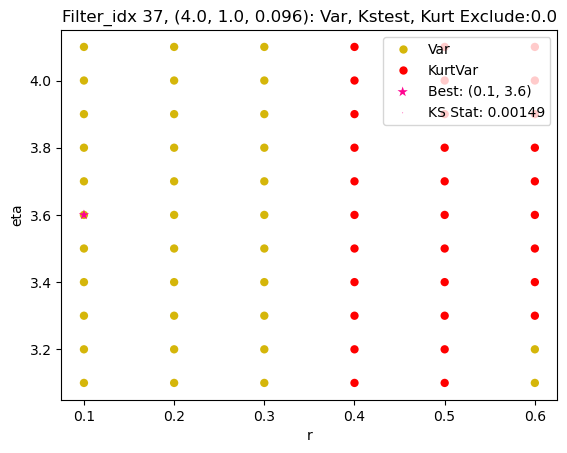

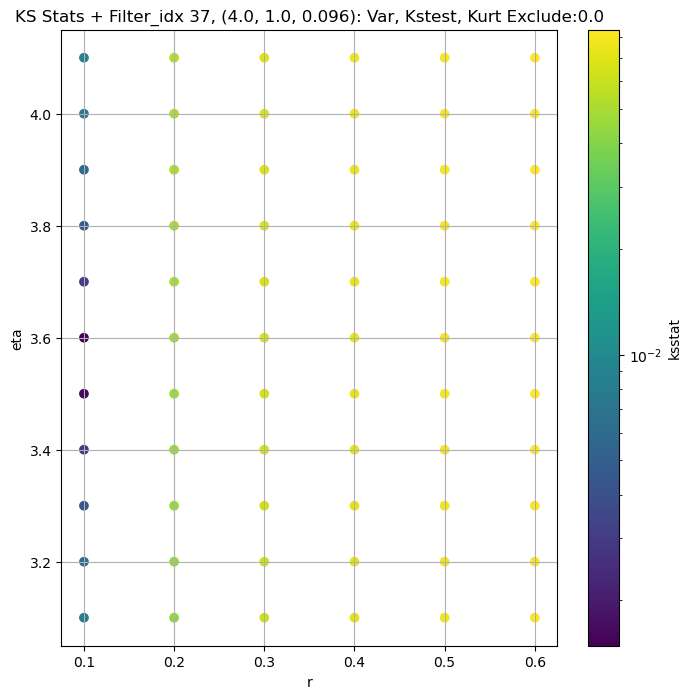

####
Filter_idx, 38: (4.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 0 0.008213671854208515 818.5766002915587


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 50 0.005144948880625555 711.9505025434802


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 100 0.004073304598901872 667.7756238507421


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 200 0.004649030174807445 613.161315029407
Number of samples: 100000, Without approximation : 97416000.0


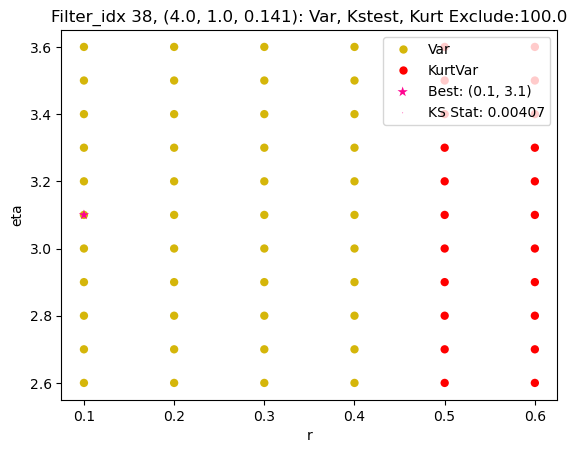

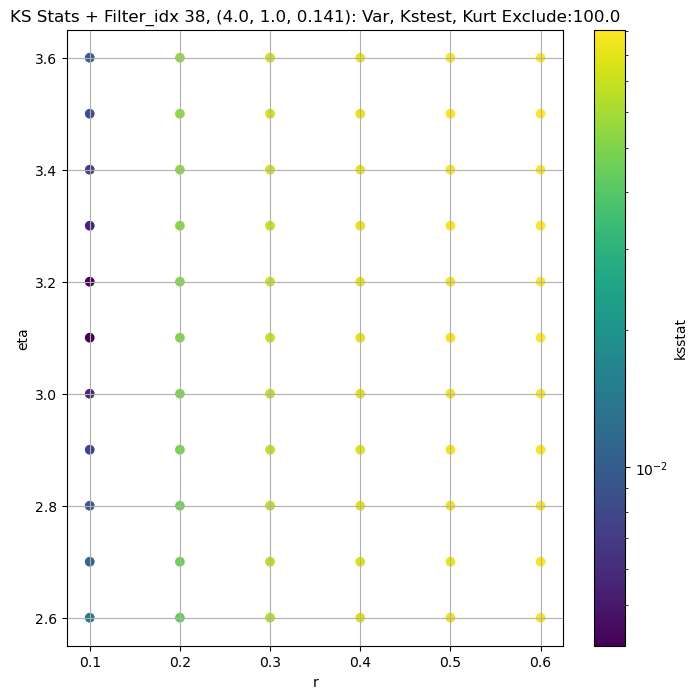

####
Filter_idx, 39: (4.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 0 0.01322082391410806 177.22569628610339


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 50 0.009912095873777838 149.52189672806773


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 100 0.007702933728628014 137.4529097026278


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 200 0.004765392429481541 122.29492913228287
Number of samples: 100000, Without approximation : 97416000.0


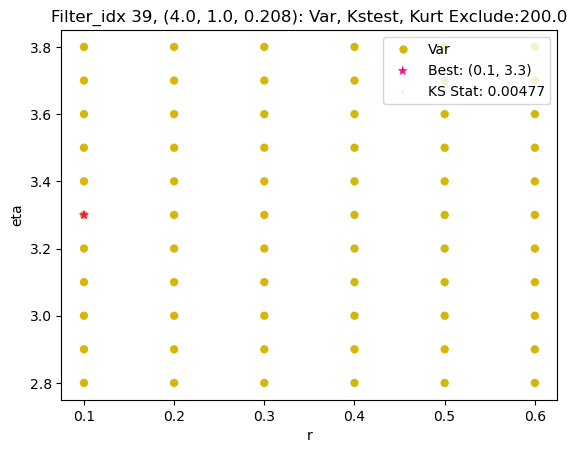

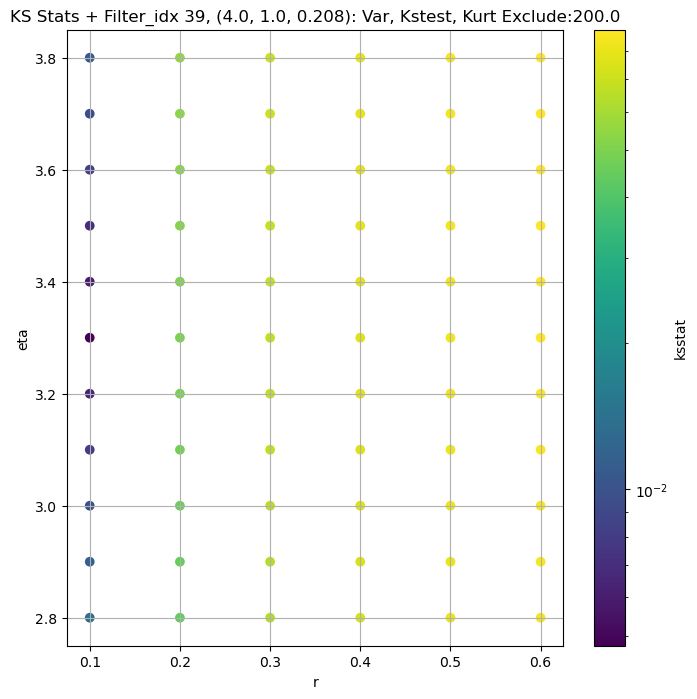

####
Filter_idx, 40: (4.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 0 0.017903139790896028 25.24986899890313


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 50 0.008138980277852648 16.643767869681174


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 100 0.00615237370305749 15.393014018312115


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 200 0.003768994717603391 13.934427727040662
Number of samples: 100000, Without approximation : 97416000.0


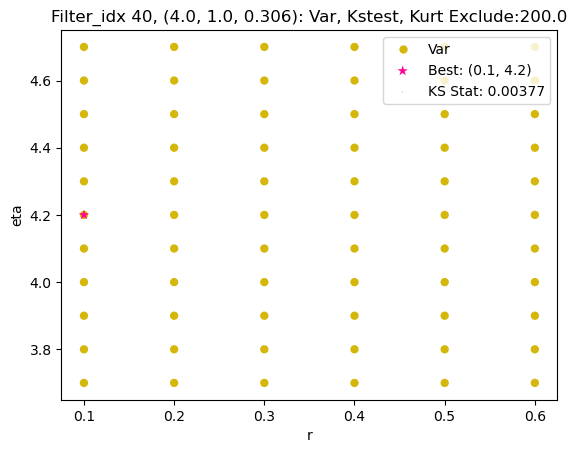

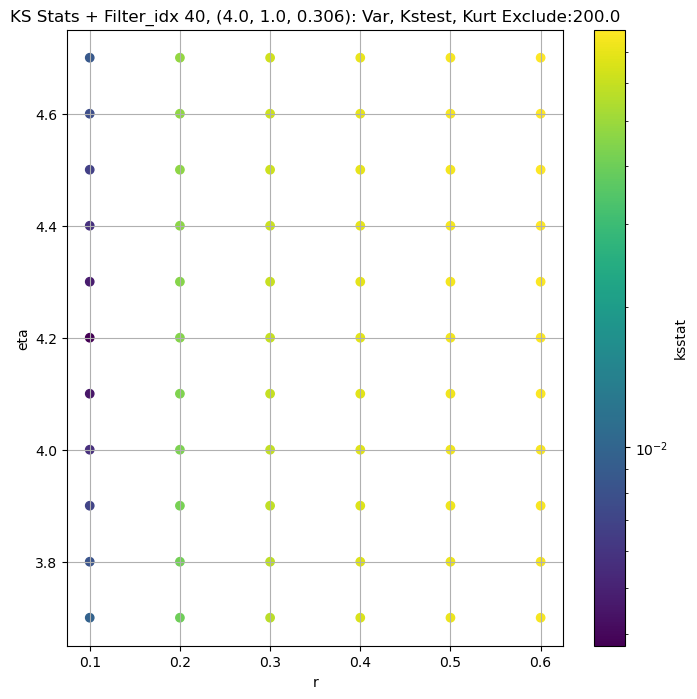

####
Filter_idx, 41: (4.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 0 0.02234128429077349 15.45489255147552


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 50 0.017411099506842442 12.316279953428356


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 100 0.015342221941154935 10.997314081692126


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 200 0.012510837466505387 9.39956658002136
Number of samples: 100000, Without approximation : 97416000.0


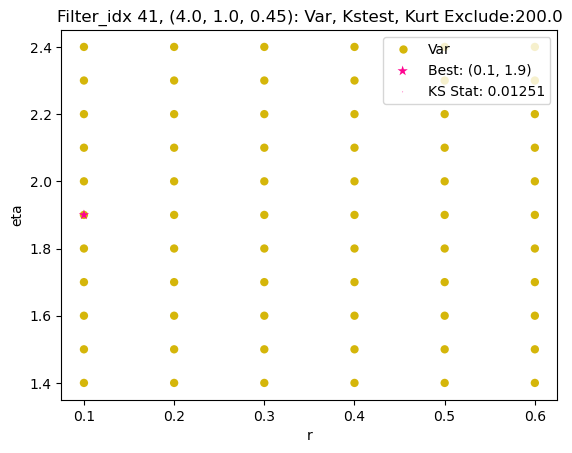

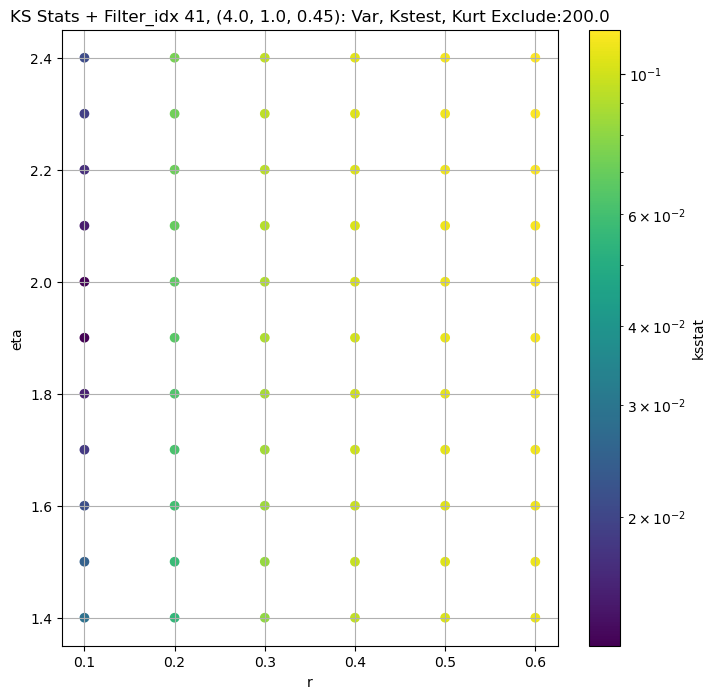

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,initial_eta,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05
filter_idx,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",17819.649815,14133.666151,22397.163289,5.220748,2.292364,18.383724,97416000.0,"(2.0, 0.5, 0.044)",0.003477,0.4,0.0,4.263534e+02,0.0,17819.649815,0.000138
1,"(2.0, 0.5, 0.065)",9613.998902,7362.581520,12698.829090,8.201643,3.945241,18.094728,97416000.0,"(2.0, 0.5, 0.065)",0.002452,0.1,3.8,2.339539e-14,50.0,9128.053836,0.000138
2,"(2.0, 0.5, 0.096)",5046.436757,3639.541954,6941.209191,14.557165,6.848337,22.125476,97416000.0,"(2.0, 0.5, 0.096)",0.004264,0.1,3.0,4.688553e-14,200.0,4071.529150,0.000138
3,"(2.0, 0.5, 0.141)",1729.833284,1220.814882,2365.257483,15.329418,7.572456,24.007473,97416000.0,"(2.0, 0.5, 0.141)",0.004407,0.1,2.6,3.729948e-14,200.0,1390.376966,0.000138
4,"(2.0, 0.5, 0.208)",404.015546,281.860747,555.373326,15.687551,7.403454,60.714712,97416000.0,"(2.0, 0.5, 0.208)",0.004552,0.1,2.6,8.742077e-15,200.0,325.870044,0.000138
5,"(2.0, 0.5, 0.306)",69.997681,47.011946,117.319540,29.976179,5.976963,184.701280,97416000.0,"(2.0, 0.5, 0.306)",0.004262,0.1,2.5,1.984647e-15,100.0,59.183832,0.000138
6,"(2.0, 0.5, 0.45)",33.089132,22.658990,72.773299,48.875998,5.926791,289.257781,97416000.0,"(2.0, 0.5, 0.45)",0.003932,0.1,2.6,7.400041e-16,100.0,27.584424,0.000138
7,"(2.0, 1.0, 0.044)",22268.466854,18051.940989,28577.944689,6.060725,2.436149,35.173910,97416000.0,"(2.0, 1.0, 0.044)",0.003769,0.3,0.4,2.765610e+01,0.0,22268.466854,0.000138
8,"(2.0, 1.0, 0.065)",10992.351839,8276.177786,14739.030290,9.817106,3.688564,32.816411,97416000.0,"(2.0, 1.0, 0.065)",0.002287,0.1,4.1,1.590383e-14,50.0,10331.210280,0.000138


In [12]:
master_df_combo_path = Path(os.path.join(CWD, "CSVs", "master_df_combo.csv"))
rEtaKsstats_dict_path = Path(os.path.join(CWD, "cache", "rEtaKsstats_dict.pickle"))

rEtaKsstats_dict = dict()

if RERUN or not master_df_combo_path.exists():
    sorted_params = sorted(all_cdfs)
    ksstats_dict = dict()

    for i, group in enumerate(GROUPS): # TODO For quick testing purposes
        print(f"####\n{GROUP.capitalize()}, {group}: {str(filter_group_map[group])}")
        sample = group_data_map[group]
        if len(sample) == 0:
            continue
        group_cdfs_df = all_cdfs_df.copy()
        master_df.loc[group, 'kstest_stat_initial'] = 1

        for j in range(len(EXCLUDE_CUTOFFS)):

            exclude_cutoff = EXCLUDE_CUTOFFS[j]
            exclude_cutoff = int(exclude_cutoff)

            if exclude_cutoff == 0:
                augmented_var = np.var(group_data_map[group]) 
            else:
                augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])
                if augmented_var == np.var(group_data_map[group]):
                    continue 
                
            group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
            ksstats, initial_param, min_stat = gridsearch(sample, all_cdfs, debug=True, scales=group_cdfs_df['scale'])
            augmented_var_df.loc[group, f"kstest_stat_{exclude_cutoff}"] = min_stat
            group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] = ksstats
            
            print(group, exclude_cutoff, min_stat, augmented_var)
            
            if (min_stat < master_df.loc[group, 'kstest_stat_initial']) and not np.isclose(min_stat, master_df.loc[group, 'kstest_stat_initial'], 1e-6):
                inital_min_stat = min_stat
                inital_best_param = initial_param
                master_df.loc[group, 'kstest_stat_initial'] = min_stat
                initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                master_df.loc[group, 'initial_r'], master_df.loc[group, 'initial_eta'] = initial_param
                master_df.loc[group, 'initial_scale'] = initial_scale
                master_df.loc[group, 'initial_exclude_cutoff'] = exclude_cutoff
                master_df.loc[group, 'best_augmented_var'] = augmented_var
        
        ksstats = group_cdfs_df[f"ksstat_exclude_{int(master_df.loc[group, 'initial_exclude_cutoff'])}"]
            
        print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
        
        cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
        master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

        best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

        group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
        group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

        group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

        group_dict = {'r' : group_cdfs_df['r'], 'eta' : group_cdfs_df['eta']}
        group_dict.update({f'ksstat_exclude_{exclude_cutoff}' : group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] for exclude_cutoff in EXCLUDE_CUTOFFS[:j+1]})
        rEtaKsstats_dict[group] = group_dict

        cols = ['pass_var', 'pass_kstest', 'pass_kurt']

        fig = combo_test_plot(group_cdfs_df, cols, 
                            plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: {', '.join([col[5:].capitalize() for col in cols])} Exclude:{master_df.loc[group, 'initial_exclude_cutoff']}", 
                            target_var = None,
                            best_param = inital_best_param,
                            best_ksstat=inital_min_stat
                            )
        
        fig.figure.savefig(os.path.join(CWD, "plots", f"full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)

        # Optional: 
        # Create plots of bootstrapped variance and kurtosis for varying confidence intervals
        # fig_var = create_ci_scatter_plot(group_cdfs_df, var_values_dict, metric='variance', group=group)
        # fig_kurt = create_ci_scatter_plot(group_cdfs_df, kurt_values_dict, metric='kurtosis', group=group)

        # fig_var.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_var)
        # fig_kurt.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_kurt)

    # new: add parameter information
    master_df.insert(0, 'params', master_df.index.map(filter_group_map))

    master_df.to_csv(master_df_combo_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)
    augmented_var_df.to_csv(augmented_var_df_path)

augmented_var_df = pd.read_csv(augmented_var_df_path, index_col=GROUP)
master_df = pd.read_csv(master_df_combo_path, index_col=GROUP)
rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df

## Optimization

In [13]:
master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
master_df[f'best_r'] = master_df['initial_r']
master_df[f'best_eta'] = master_df['initial_eta']
master_df[f'best_scale'] = master_df['initial_scale']
master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

Filter_idx 0, (2.0, 0.5, 0.044):


  0%|          | 0/1152 [00:00<?, ?it/s]

Finding Minimum after computing 1152 CDFs
filter_idx 0, 0.0 + 100 = 100, ksstat: 0.004109093898283178, var: 16600.600121054824


  0%|          | 0/1152 [00:00<?, ?it/s]

Finding Minimum after computing 1152 CDFs
filter_idx 0, 0.0 + 75 = 75, ksstat: 0.0037796524104496687, var: 16822.817545830036


  0%|          | 0/1152 [00:00<?, ?it/s]

Finding Minimum after computing 1152 CDFs
filter_idx 0, 0.0 + 50 = 50, ksstat: 0.0035119039359108872, var: 17073.09923695834


  0%|          | 0/1152 [00:00<?, ?it/s]

Finding Minimum after computing 1152 CDFs
filter_idx 0, 0.0 + 25 = 25, ksstat: 0.0033669531818559875, var: 17367.677028632446


  0%|          | 0/1152 [00:00<?, ?it/s]

Finding Minimum after computing 1152 CDFs
filter_idx 0, 0.0 + 0 = 0, ksstat: 0.0026633745850483947, var: 17819.649814859404
Number of samples: 100000, Without approximation : 97416000.0


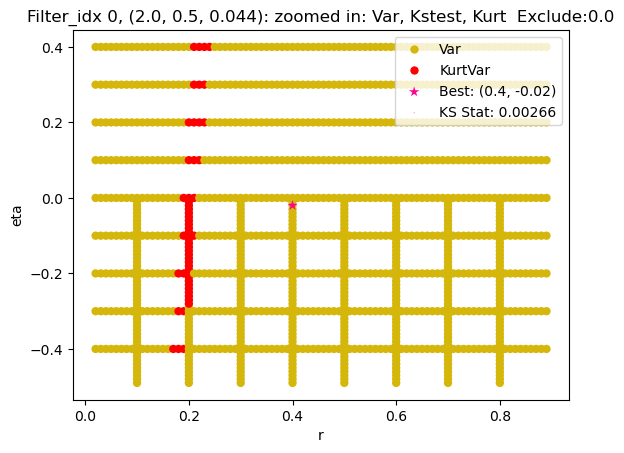

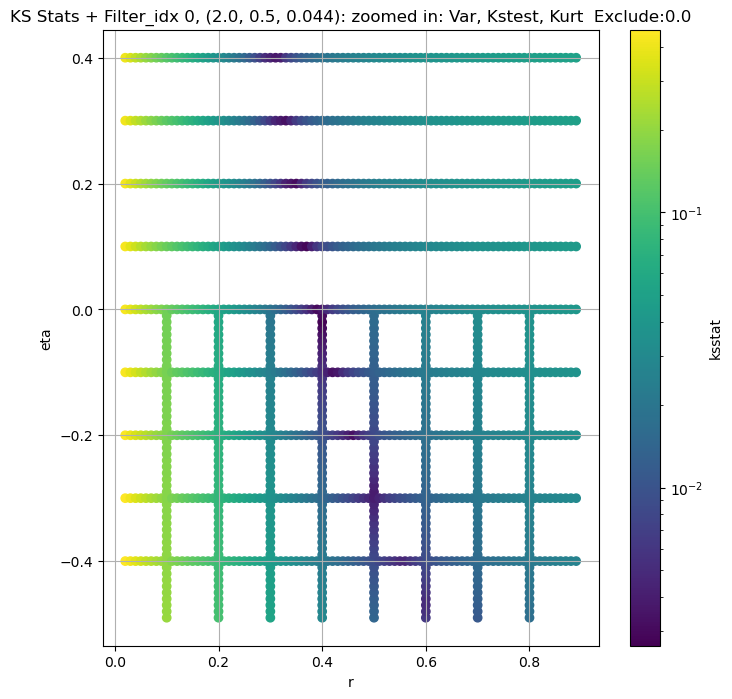

Filter_idx 1, (2.0, 0.5, 0.065):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 1, 50.0 + 100 = 150, ksstat: 0.0038779548215656726, var: 8549.127391614204


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 1, 50.0 + 75 = 125, ksstat: 0.003506105141194815, var: 8677.793502490918


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 1, 50.0 + 50 = 100, ksstat: 0.0031543712657275957, var: 8815.16767535757


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 1, 50.0 + 25 = 75, ksstat: 0.002808344789496606, var: 8963.710723286566


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 1, 50.0 + 0 = 50, ksstat: 0.0024520446744697843, var: 9128.053836039287


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 1, 50.0 + -25 = 25, ksstat: 0.0021380208150744706, var: 9320.731672170841


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 1, 50.0 + -50 = 0, ksstat: 0.0022005895286248967, var: 9613.998901525669
Number of samples: 100000, Without approximation : 97416000.0


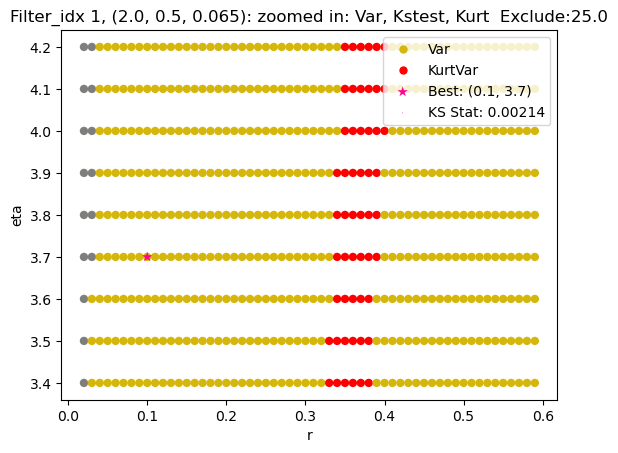

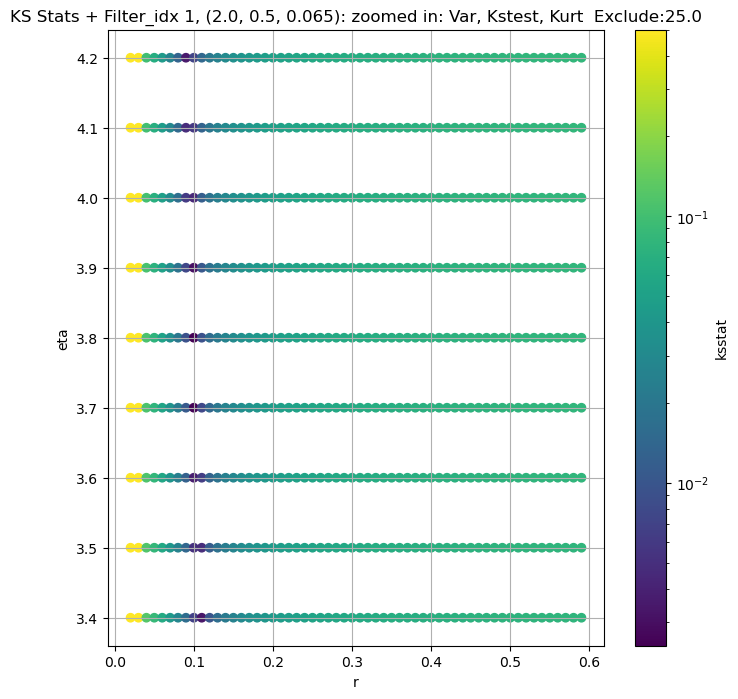

Filter_idx 2, (2.0, 0.5, 0.096):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 200.0 + 100 = 300, ksstat: 0.005244412513479395, var: 3788.972725103855


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 200.0 + 75 = 275, ksstat: 0.0049849482798247635, var: 3853.6096356025437


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 200.0 + 50 = 250, ksstat: 0.004758488959490492, var: 3921.8629770476578


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 200.0 + 25 = 225, ksstat: 0.00449186314863137, var: 3994.2771096662345


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 200.0 + 0 = 200, ksstat: 0.004264490595287662, var: 4071.52914952204


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 200.0 + -25 = 175, ksstat: 0.004037538453269374, var: 4154.635489149325


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 200.0 + -50 = 150, ksstat: 0.0037590341462721, var: 4244.786754183705


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 200.0 + -75 = 125, ksstat: 0.004315653667900987, var: 4343.376060335543


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 200.0 + -100 = 100, ksstat: 0.00497487780352418, var: 4451.919145159676
Number of samples: 100000, Without approximation : 97416000.0


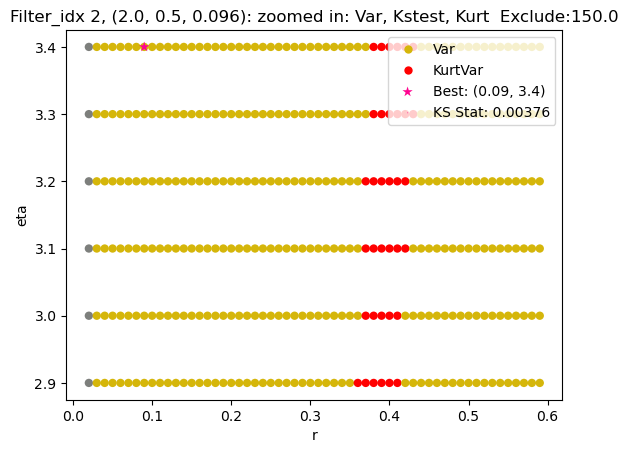

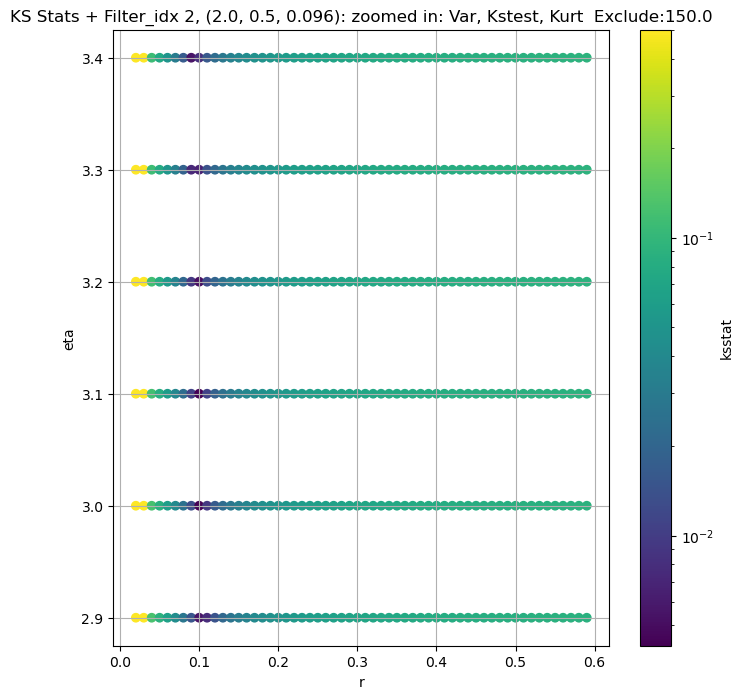

Filter_idx 3, (2.0, 0.5, 0.141):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 3, 200.0 + 100 = 300, ksstat: 0.005492246975435627, var: 1289.6871823060171


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 3, 200.0 + 75 = 275, ksstat: 0.005196604177873487, var: 1312.7944586696588


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 3, 200.0 + 50 = 250, ksstat: 0.004936831391331095, var: 1337.1567752445235


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 3, 200.0 + 25 = 225, ksstat: 0.004665421480056109, var: 1362.9508629138215


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 3, 200.0 + 0 = 200, ksstat: 0.0043866507003992306, var: 1390.376966261277


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 3, 200.0 + -25 = 175, ksstat: 0.0041389911072385755, var: 1419.7141753043231


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 3, 200.0 + -50 = 150, ksstat: 0.00417946090654242, var: 1451.310849974102


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 3, 200.0 + -75 = 125, ksstat: 0.004850147534487981, var: 1485.5724472314798


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 3, 200.0 + -100 = 100, ksstat: 0.00539267032635235, var: 1523.0083373985833
Number of samples: 100000, Without approximation : 97416000.0


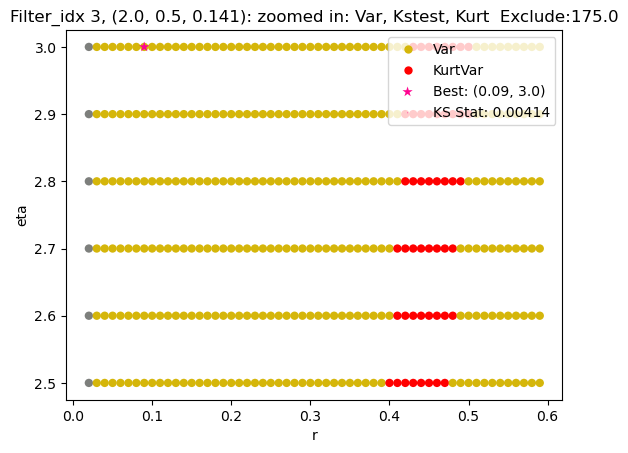

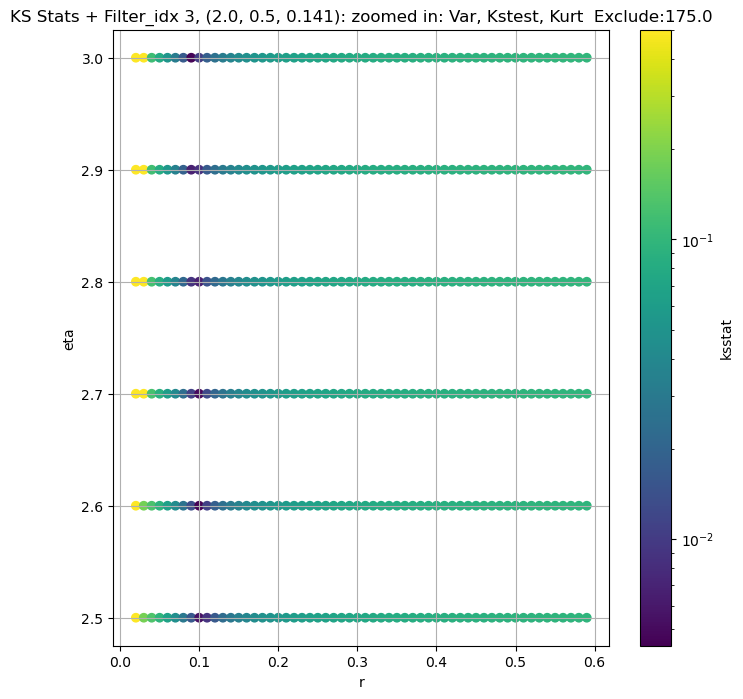

Filter_idx 4, (2.0, 0.5, 0.208):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 4, 200.0 + 100 = 300, ksstat: 0.005868755009929803, var: 303.5161673576844


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 4, 200.0 + 75 = 275, ksstat: 0.0055227745508854564, var: 308.6539842672821


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 4, 200.0 + 50 = 250, ksstat: 0.00521168180900311, var: 314.0670732267284


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 4, 200.0 + 25 = 225, ksstat: 0.00486013087707593, var: 319.79126278122874


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 4, 200.0 + 0 = 200, ksstat: 0.004520845144921237, var: 325.87004355895516


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 4, 200.0 + -25 = 175, ksstat: 0.0041708571607939355, var: 332.36091777395677


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 4, 200.0 + -50 = 150, ksstat: 0.0038952603792439255, var: 339.3354871465396


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 4, 200.0 + -75 = 125, ksstat: 0.004251050574436532, var: 346.88952825122027


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 4, 200.0 + -100 = 100, ksstat: 0.004851056883257043, var: 355.1561695546772
Number of samples: 100000, Without approximation : 97416000.0


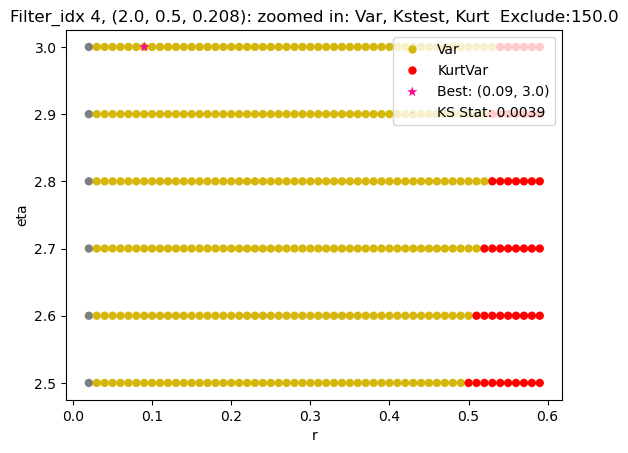

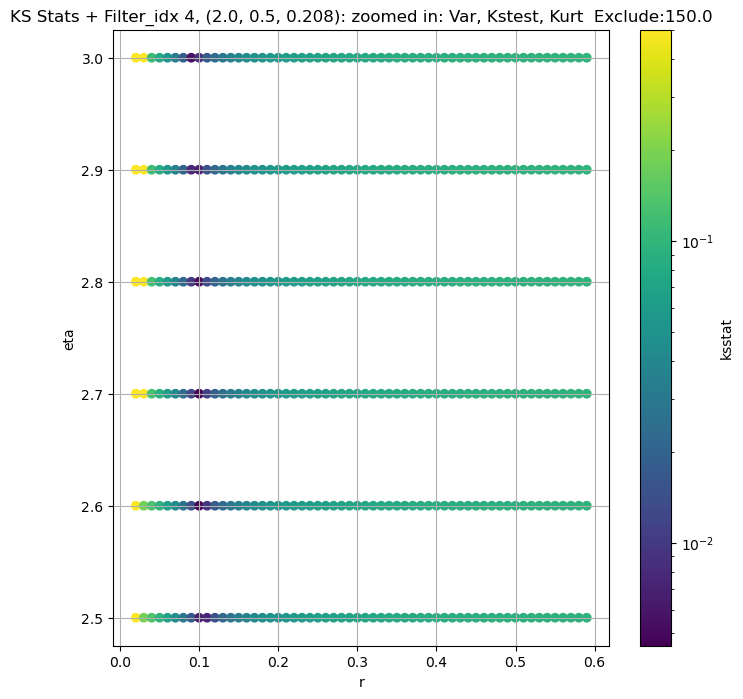

Filter_idx 5, (2.0, 0.5, 0.306):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 100.0 + 100 = 200, ksstat: 0.004939376717741362, var: 54.40309982036937


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 100.0 + 75 = 175, ksstat: 0.004606493476623563, var: 55.451494606166285


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 100.0 + 50 = 150, ksstat: 0.0041779851510999055, var: 56.584335390455244


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 100.0 + 25 = 125, ksstat: 0.004205972207205644, var: 57.81971026303132


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 100.0 + 0 = 100, ksstat: 0.004074657746826527, var: 59.183832303143326


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 100.0 + -25 = 75, ksstat: 0.0043882787568783055, var: 60.71809487604125


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 100.0 + -50 = 50, ksstat: 0.00473104432817209, var: 62.497838358702296


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 100.0 + -75 = 25, ksstat: 0.005329887291125546, var: 64.70926637184593


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 100.0 + -100 = 0, ksstat: 0.006292757771473284, var: 69.99768141064843
Number of samples: 100000, Without approximation : 97416000.0


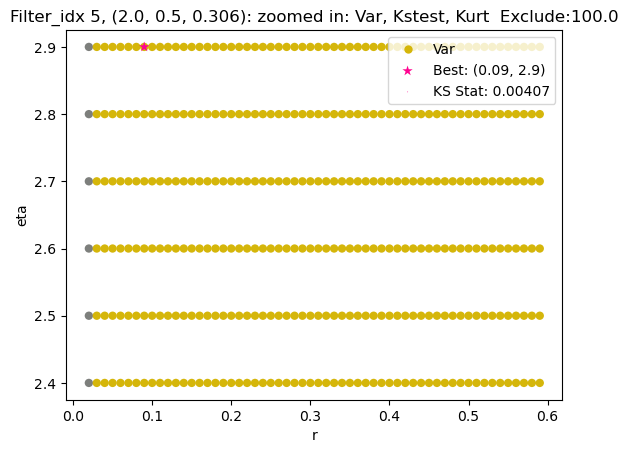

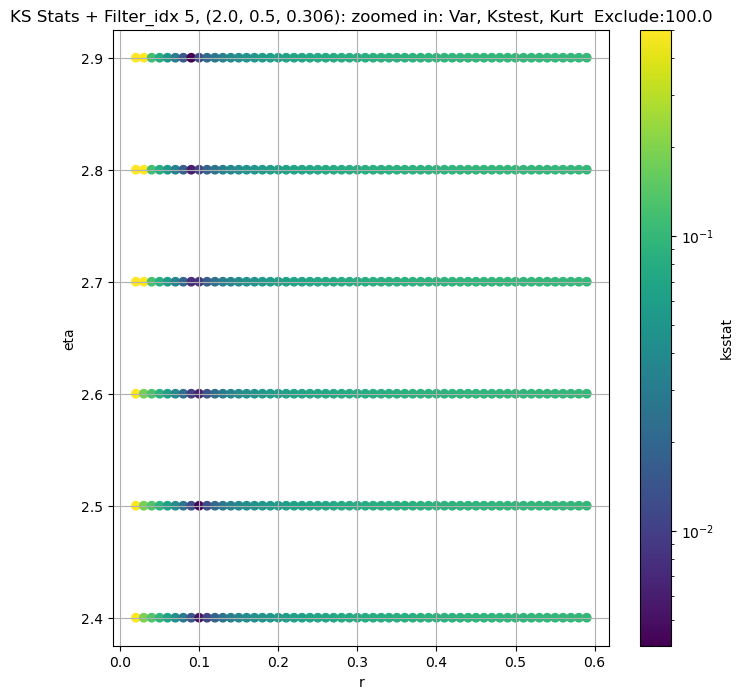

Filter_idx 6, (2.0, 0.5, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 100.0 + 100 = 200, ksstat: 0.005637089482537255, var: 25.50850082344185


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 100.0 + 75 = 175, ksstat: 0.005355785908480709, var: 25.96515214072101


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 100.0 + 50 = 150, ksstat: 0.0048311931005691755, var: 26.45794962302974


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 100.0 + 25 = 125, ksstat: 0.004346813081524514, var: 26.99427327786719


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 100.0 + 0 = 100, ksstat: 0.003932248376982583, var: 27.58442379207999


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 100.0 + -25 = 75, ksstat: 0.0038518445450884675, var: 28.246008987971837


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 100.0 + -50 = 50, ksstat: 0.004065883618975641, var: 29.011194484107378


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 100.0 + -75 = 25, ksstat: 0.004542719597039058, var: 29.964511134174828


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 100.0 + -100 = 0, ksstat: 0.006403634760146271, var: 33.08913231058852
Number of samples: 100000, Without approximation : 97416000.0


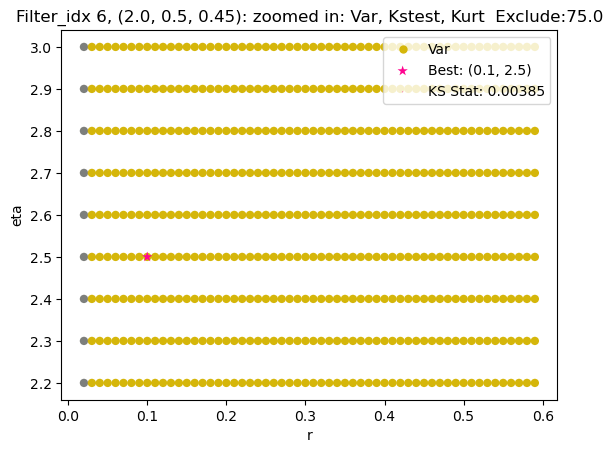

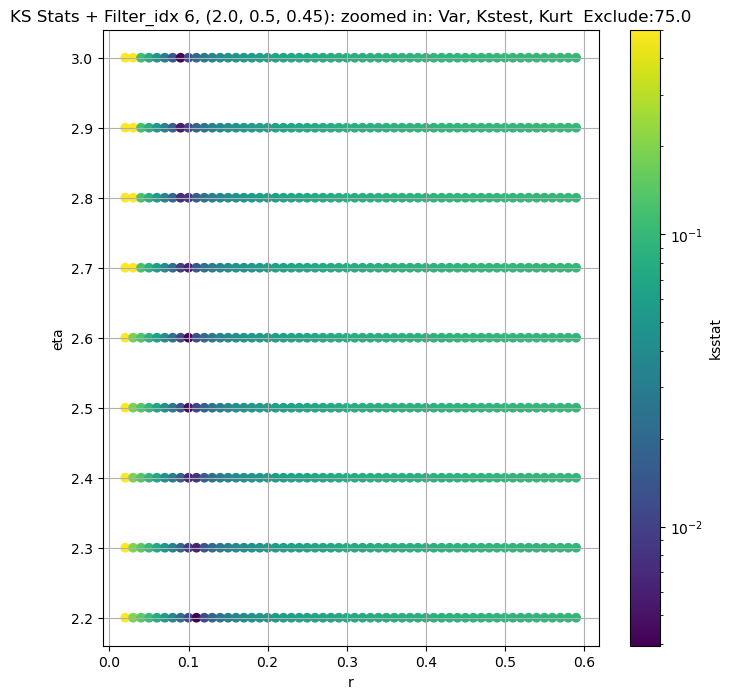

Filter_idx 7, (2.0, 1.0, 0.044):


  0%|          | 0/765 [00:00<?, ?it/s]

Finding Minimum after computing 765 CDFs
filter_idx 7, 0.0 + 100 = 100, ksstat: 0.005380895609853095, var: 20643.08465963476


  0%|          | 0/765 [00:00<?, ?it/s]

Finding Minimum after computing 765 CDFs
filter_idx 7, 0.0 + 75 = 75, ksstat: 0.0050307762593103655, var: 20912.65787082871


  0%|          | 0/765 [00:00<?, ?it/s]

Finding Minimum after computing 765 CDFs
filter_idx 7, 0.0 + 50 = 50, ksstat: 0.004576926601613414, var: 21222.57595032618


  0%|          | 0/765 [00:00<?, ?it/s]

Finding Minimum after computing 765 CDFs
filter_idx 7, 0.0 + 25 = 25, ksstat: 0.0039003516981710035, var: 21600.835856851838


  0%|          | 0/765 [00:00<?, ?it/s]

Finding Minimum after computing 765 CDFs
filter_idx 7, 0.0 + 0 = 0, ksstat: 0.00289906056680711, var: 22268.46685407241
Number of samples: 100000, Without approximation : 97416000.0


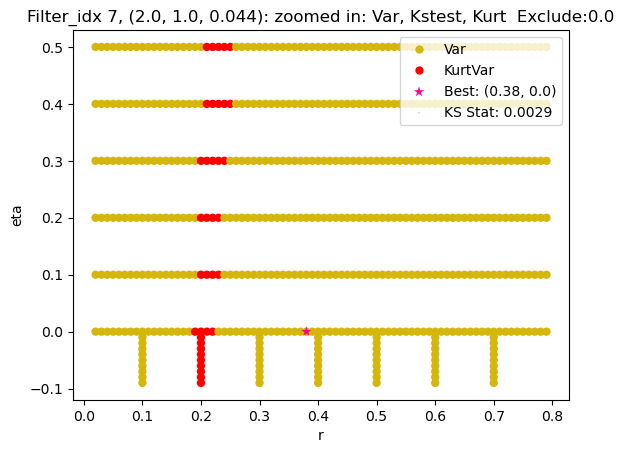

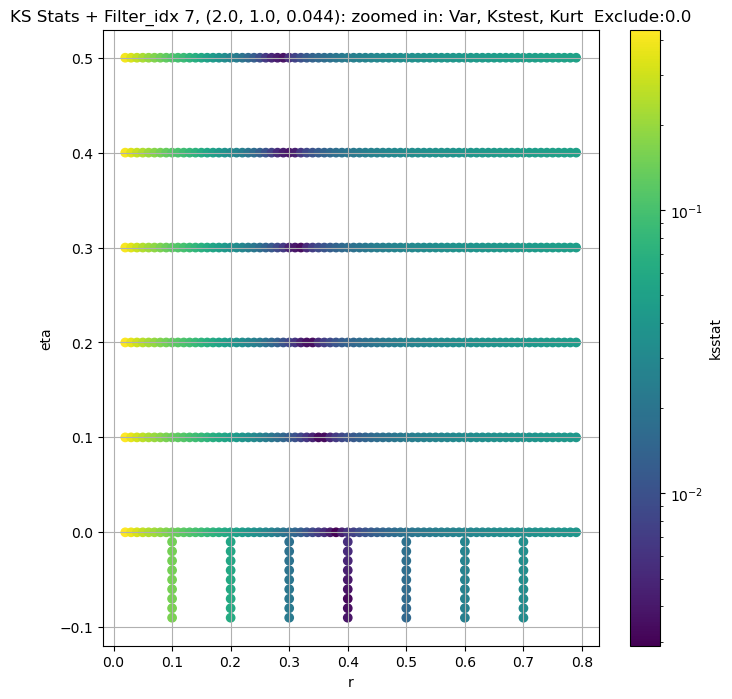

Filter_idx 8, (2.0, 1.0, 0.065):


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 8, 50.0 + 100 = 150, ksstat: 0.004011749872588469, var: 9566.626343755066


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 8, 50.0 + 75 = 125, ksstat: 0.0035732077804121465, var: 9729.385655022672


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 8, 50.0 + 50 = 100, ksstat: 0.0029841590632242662, var: 9908.06270785474


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 8, 50.0 + 25 = 75, ksstat: 0.002411941374626636, var: 10106.477174829857


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 8, 50.0 + 0 = 50, ksstat: 0.0022873058988322204, var: 10331.210280484811


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 8, 50.0 + -25 = 25, ksstat: 0.002601657550266201, var: 10595.190499595676


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 8, 50.0 + -50 = 0, ksstat: 0.002969043910719227, var: 10992.351838833945
Number of samples: 100000, Without approximation : 97416000.0


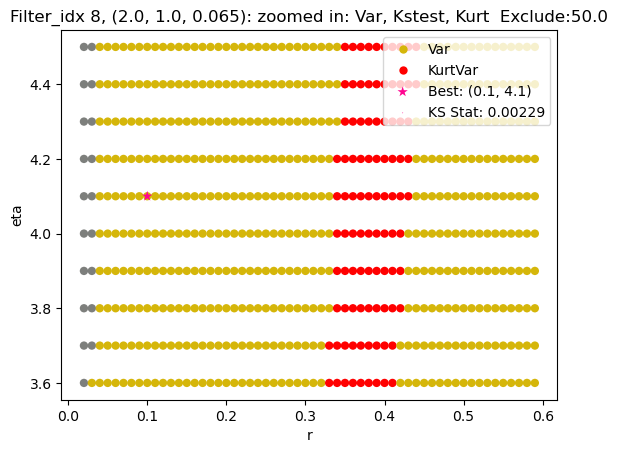

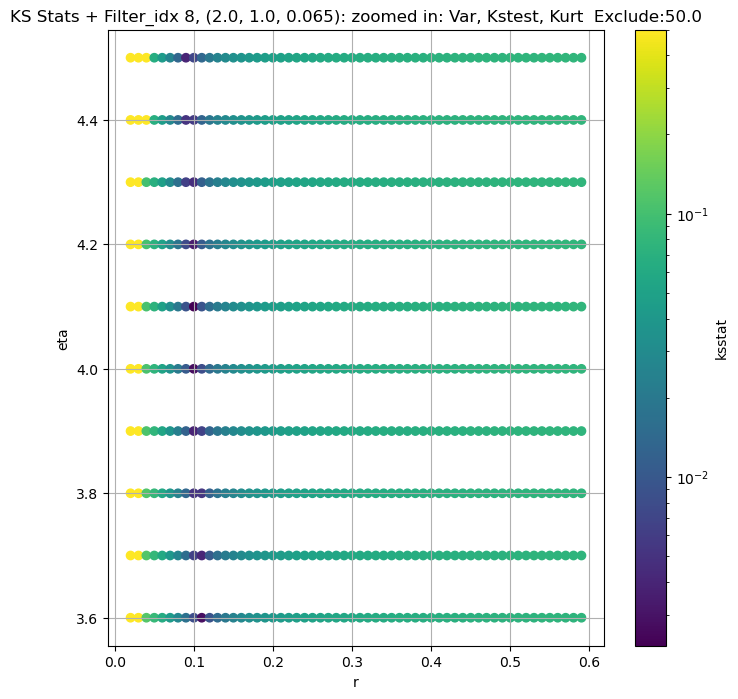

Filter_idx 9, (2.0, 1.0, 0.096):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + 100 = 300, ksstat: 0.004893298824698824, var: 4409.035096567044


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + 75 = 275, ksstat: 0.004491178982534302, var: 4484.7911216556895


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + 50 = 250, ksstat: 0.004128312853460714, var: 4565.164081791287


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + 25 = 225, ksstat: 0.0037850427692772033, var: 4650.7001852683425


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + 0 = 200, ksstat: 0.0034973506970178425, var: 4742.190611718667


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + -25 = 175, ksstat: 0.0036303930367290738, var: 4840.499898428843


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + -50 = 150, ksstat: 0.0035116534947670086, var: 4946.776666187183


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + -75 = 125, ksstat: 0.00416851398231366, var: 5062.703122695045


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + -100 = 100, ksstat: 0.004646650014934167, var: 5191.033947203585
Number of samples: 100000, Without approximation : 97416000.0


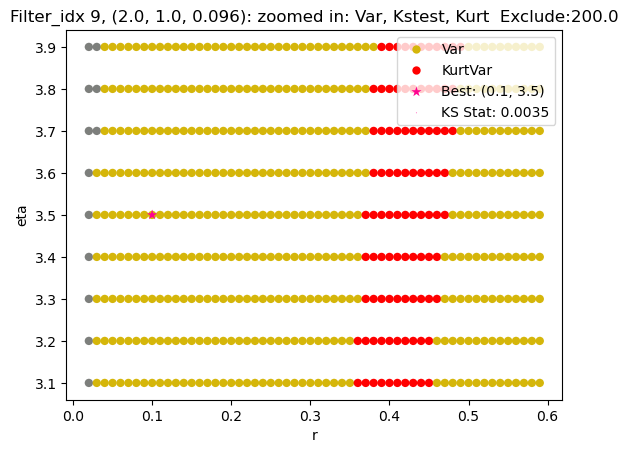

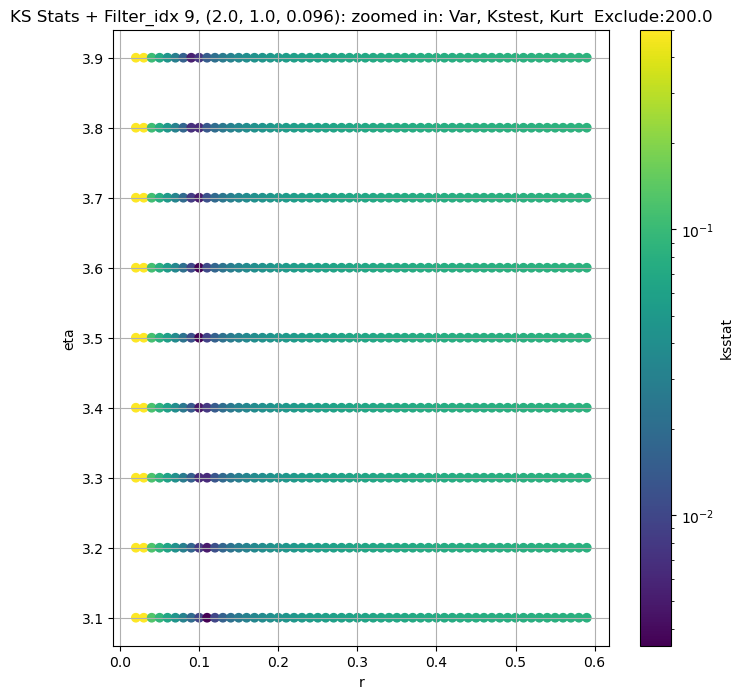

Filter_idx 10, (2.0, 1.0, 0.141):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + 100 = 300, ksstat: 0.00494974628578515, var: 1847.0916017647962


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + 75 = 275, ksstat: 0.004658492665473357, var: 1883.2425671023427


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + 50 = 250, ksstat: 0.004579834291446538, var: 1921.6409123548672


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + 25 = 225, ksstat: 0.0048034145786134685, var: 1962.585913049972


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + 0 = 200, ksstat: 0.005076207319843706, var: 2006.4522660370426


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + -25 = 175, ksstat: 0.005257055463537941, var: 2053.714229034486


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + -50 = 150, ksstat: 0.005793835498660527, var: 2104.978577438371


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + -75 = 125, ksstat: 0.0062814609925055664, var: 2161.084973606166


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + -100 = 100, ksstat: 0.006862245219822927, var: 2223.229418854002
Number of samples: 100000, Without approximation : 97416000.0


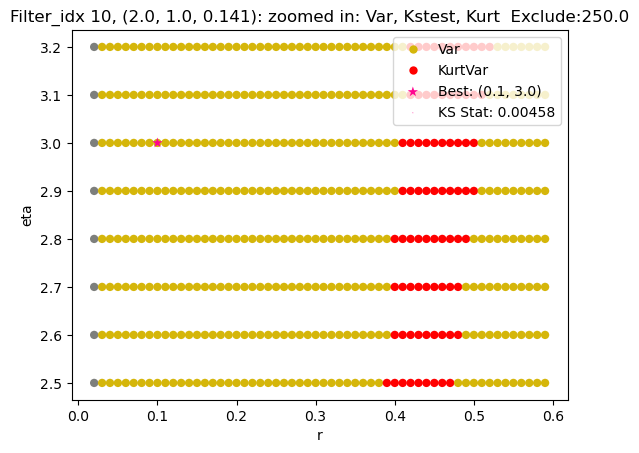

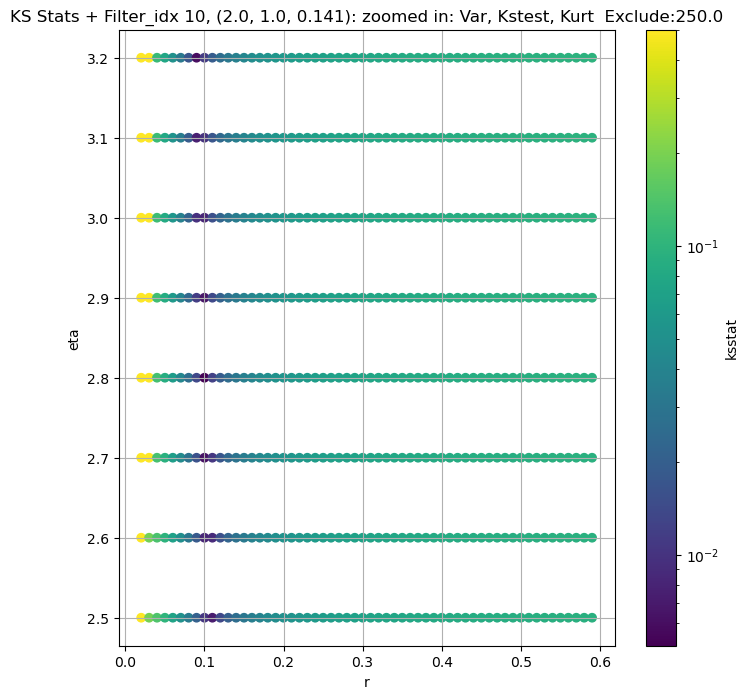

Filter_idx 11, (2.0, 1.0, 0.208):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 200.0 + 100 = 300, ksstat: 0.005695530405250504, var: 522.1951153016147


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 200.0 + 75 = 275, ksstat: 0.005368100302019112, var: 531.2736800430716


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 200.0 + 50 = 250, ksstat: 0.005022721687117279, var: 540.8669037428923


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 200.0 + 25 = 225, ksstat: 0.004731280035088048, var: 551.0376241789851


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 200.0 + 0 = 200, ksstat: 0.004574931193662701, var: 561.8632210918523


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 200.0 + -25 = 175, ksstat: 0.004989795160399879, var: 573.4399493468732


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 200.0 + -50 = 150, ksstat: 0.0055421749596830105, var: 585.8829076721618


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 200.0 + -75 = 125, ksstat: 0.006094487950995209, var: 599.3625699039555


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 200.0 + -100 = 100, ksstat: 0.006635635220158587, var: 614.109687174626
Number of samples: 100000, Without approximation : 97416000.0


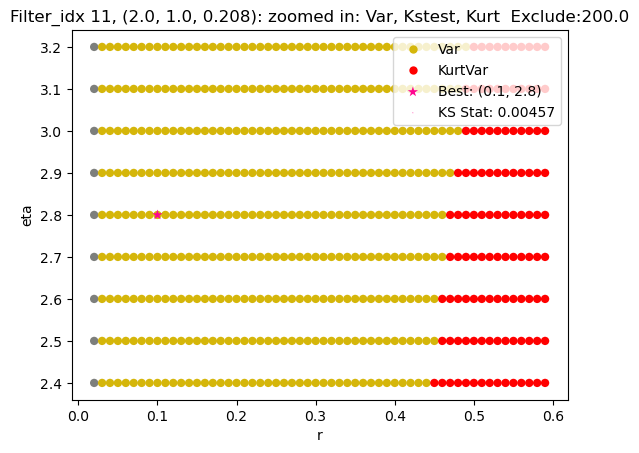

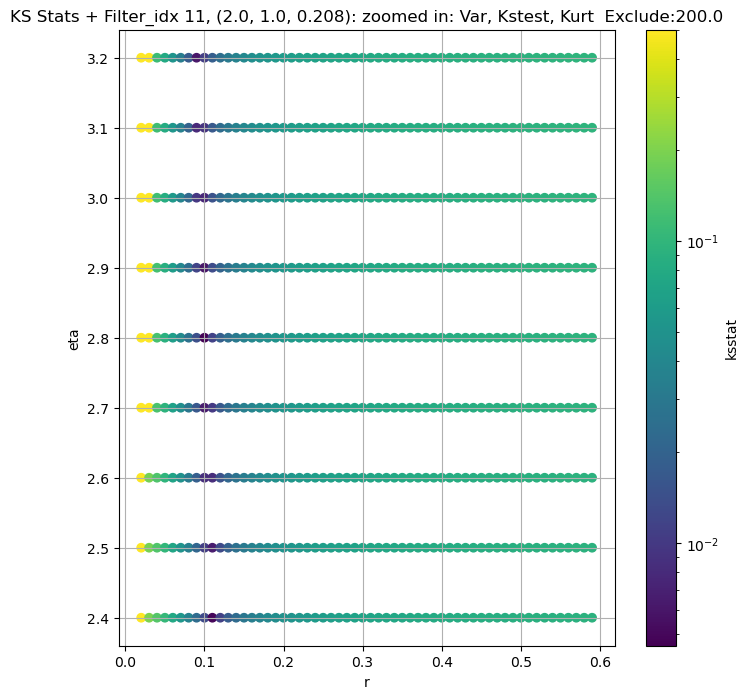

Filter_idx 12, (2.0, 1.0, 0.306):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + 100 = 300, ksstat: 0.006226895780964581, var: 105.63860331208855


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + 75 = 275, ksstat: 0.005903480471059819, var: 107.35053538273343


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + 50 = 250, ksstat: 0.005529375255794666, var: 109.15963702699497


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + 25 = 225, ksstat: 0.005145503888316468, var: 111.07848264843498


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + 0 = 200, ksstat: 0.004757295199074307, var: 113.12230962934582


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + -25 = 175, ksstat: 0.004412708968237755, var: 115.31140865724787


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + -50 = 150, ksstat: 0.004057678103831508, var: 117.67242155157837


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + -75 = 125, ksstat: 0.00429693143204074, var: 120.24368818148564


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + -100 = 100, ksstat: 0.004813787737416364, var: 123.07520864061804
Number of samples: 100000, Without approximation : 97416000.0


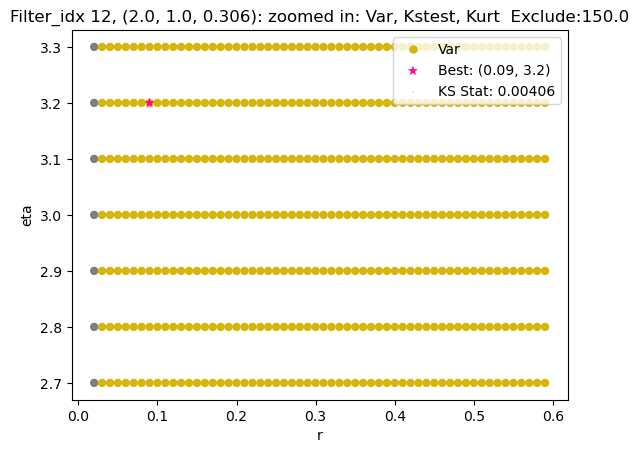

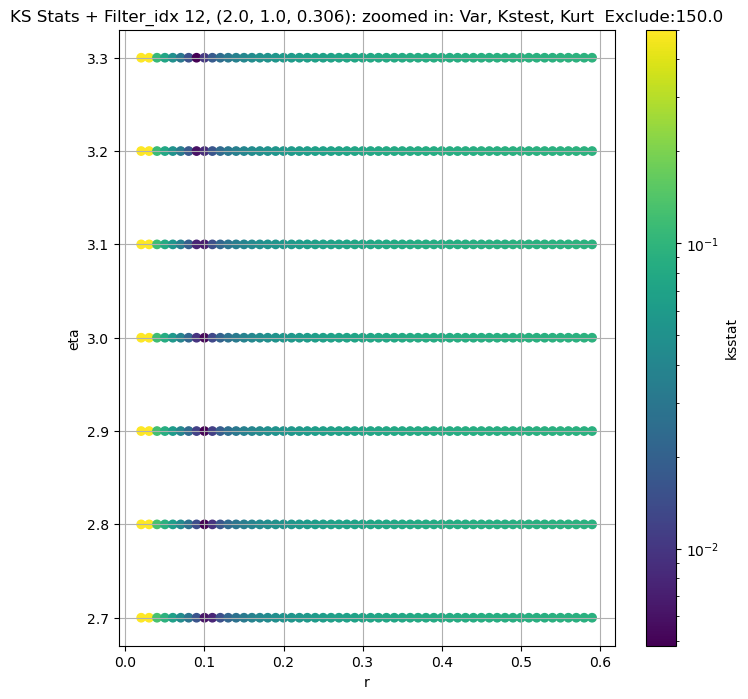

Filter_idx 13, (2.0, 1.0, 0.45):


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 13, 100.0 + 100 = 200, ksstat: 0.0052927219027167904, var: 27.655154475092704


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 13, 100.0 + 75 = 175, ksstat: 0.004850369182417137, var: 28.208894832687182


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 13, 100.0 + 50 = 150, ksstat: 0.004389475374063201, var: 28.8128399764489


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 13, 100.0 + 25 = 125, ksstat: 0.004420700275855394, var: 29.479689985262812


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 13, 100.0 + 0 = 100, ksstat: 0.004892293939625647, var: 30.2288152466905


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 13, 100.0 + -25 = 75, ksstat: 0.004556001518544739, var: 31.092786733914355


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 13, 100.0 + -50 = 50, ksstat: 0.004951065876999949, var: 32.13805821457728


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 13, 100.0 + -75 = 25, ksstat: 0.00630577424412182, var: 33.52779729370055


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 13, 100.0 + -100 = 0, ksstat: 0.007934096535576751, var: 37.364078359463335
Number of samples: 100000, Without approximation : 97416000.0


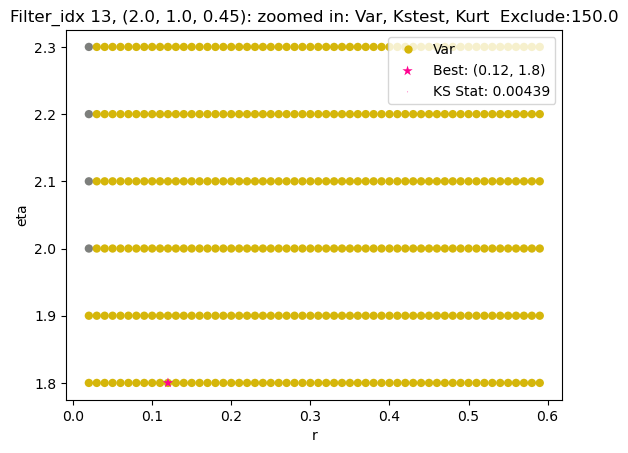

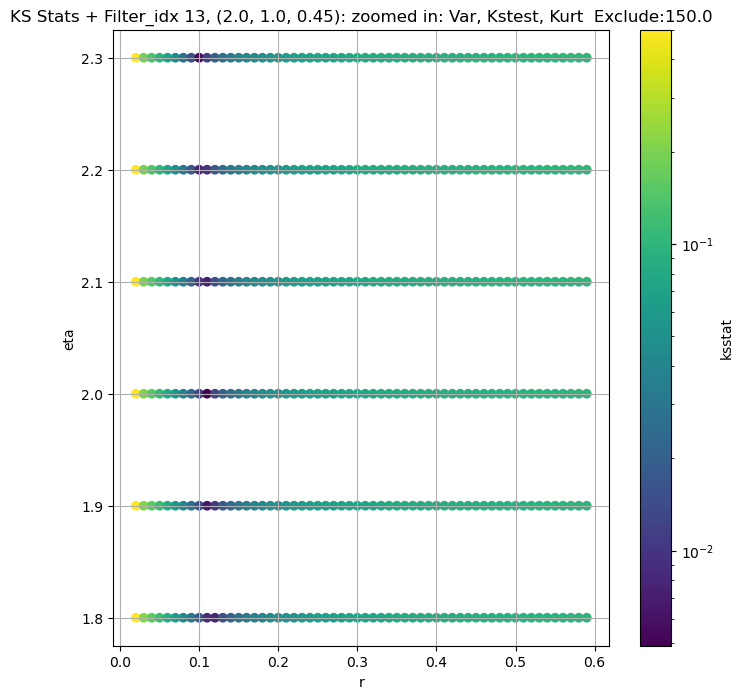

Filter_idx 14, (3.0, 0.5, 0.044):


  0%|          | 0/1611 [00:00<?, ?it/s]

Finding Minimum after computing 1611 CDFs
filter_idx 14, 0.0 + 100 = 100, ksstat: 0.005331947717913517, var: 15008.439013730573


  0%|          | 0/1611 [00:00<?, ?it/s]

Finding Minimum after computing 1611 CDFs
filter_idx 14, 0.0 + 75 = 75, ksstat: 0.004897089268794397, var: 15191.464489067452


  0%|          | 0/1611 [00:00<?, ?it/s]

Finding Minimum after computing 1611 CDFs
filter_idx 14, 0.0 + 50 = 50, ksstat: 0.004788277852177836, var: 15398.608496333367


  0%|          | 0/1611 [00:00<?, ?it/s]

Finding Minimum after computing 1611 CDFs
filter_idx 14, 0.0 + 25 = 25, ksstat: 0.0044011476839468655, var: 15647.195345433234


  0%|          | 0/1611 [00:00<?, ?it/s]

Finding Minimum after computing 1611 CDFs
filter_idx 14, 0.0 + 0 = 0, ksstat: 0.0039016672104396077, var: 16054.87645139801
Number of samples: 100000, Without approximation : 97416000.0


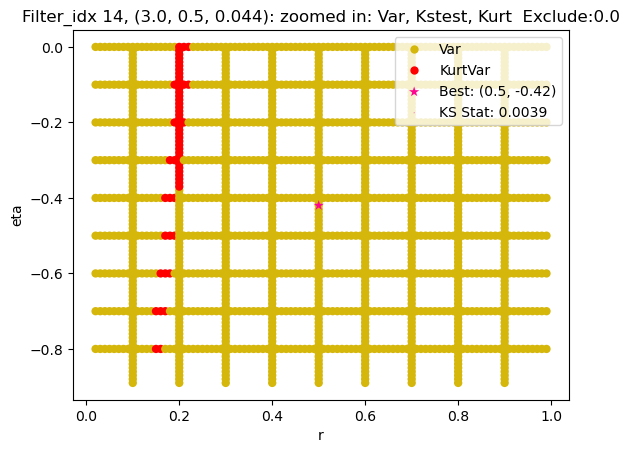

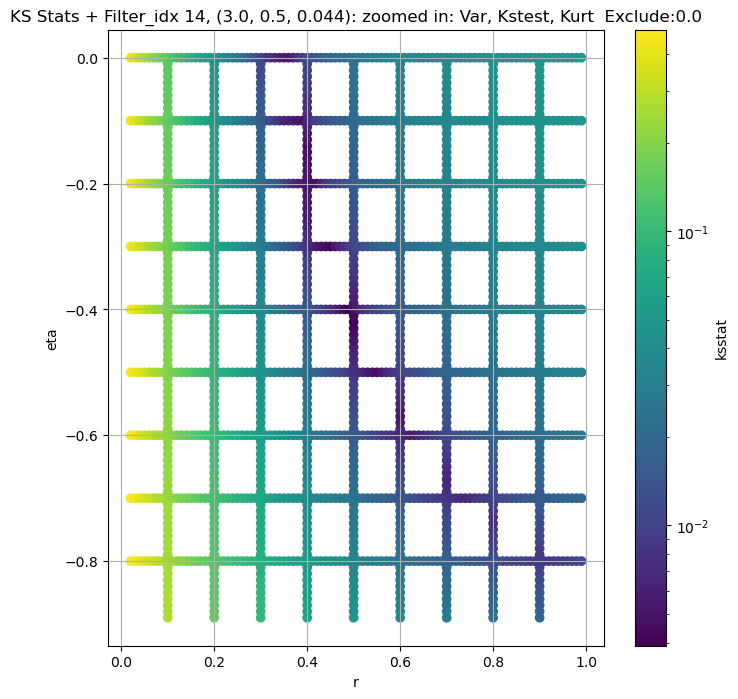

Filter_idx 15, (3.0, 0.5, 0.065):


  0%|          | 0/954 [00:00<?, ?it/s]

Finding Minimum after computing 954 CDFs
filter_idx 15, 0.0 + 100 = 100, ksstat: 0.004279294289760066, var: 6178.821393229562


  0%|          | 0/954 [00:00<?, ?it/s]

Finding Minimum after computing 954 CDFs
filter_idx 15, 0.0 + 75 = 75, ksstat: 0.0037902953197385125, var: 6278.9867114423405


  0%|          | 0/954 [00:00<?, ?it/s]

Finding Minimum after computing 954 CDFs
filter_idx 15, 0.0 + 50 = 50, ksstat: 0.0031419879037486442, var: 6395.776300715608


  0%|          | 0/954 [00:00<?, ?it/s]

Finding Minimum after computing 954 CDFs
filter_idx 15, 0.0 + 25 = 25, ksstat: 0.002702998584254712, var: 6540.68117800708


  0%|          | 0/954 [00:00<?, ?it/s]

Finding Minimum after computing 954 CDFs
filter_idx 15, 0.0 + 0 = 0, ksstat: 0.002153312329463475, var: 6784.055426653286
Number of samples: 100000, Without approximation : 97416000.0


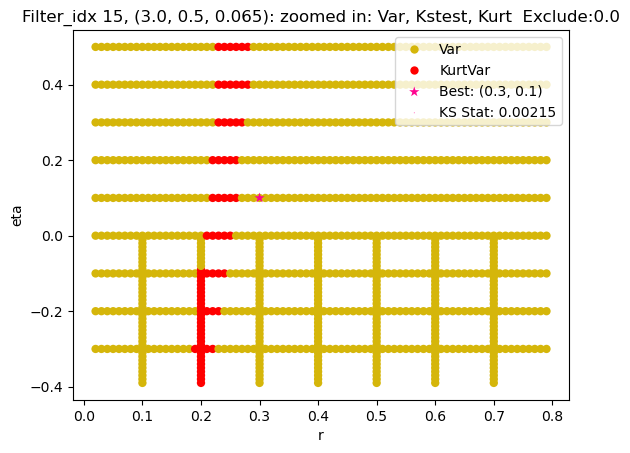

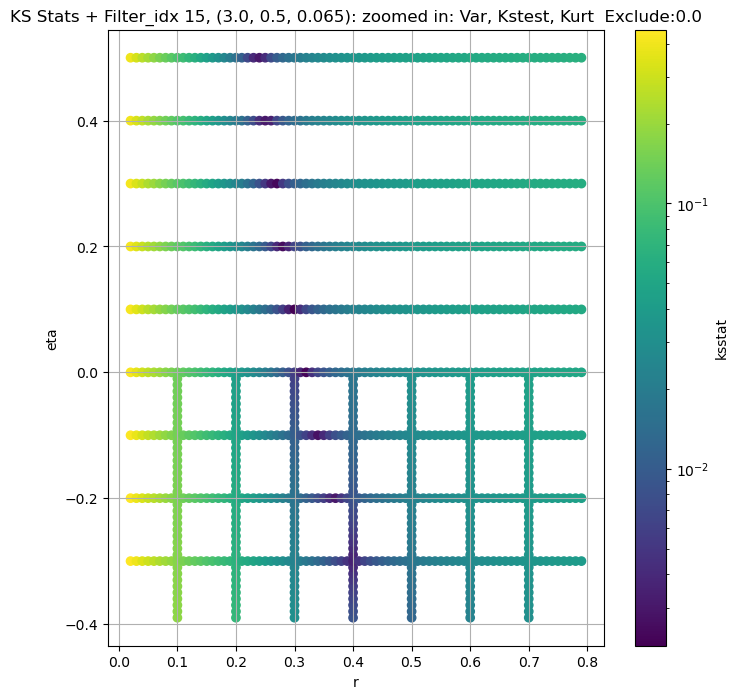

Filter_idx 16, (3.0, 0.5, 0.096):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 50.0 + 100 = 150, ksstat: 0.0034903821579519434, var: 2781.426368950493


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 50.0 + 75 = 125, ksstat: 0.0027673735709558486, var: 2849.592289348729


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 50.0 + 50 = 100, ksstat: 0.002345620437263496, var: 2924.5571974605705


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 50.0 + 25 = 75, ksstat: 0.0014836662813847434, var: 3007.606472234243


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 50.0 + 0 = 50, ksstat: 0.0012191375431911343, var: 3100.7004501580564


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 50.0 + -25 = 25, ksstat: 0.0015443198305730155, var: 3208.20766781012


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 50.0 + -50 = 0, ksstat: 0.001998622551234397, var: 3359.2172695191507
Number of samples: 100000, Without approximation : 97416000.0


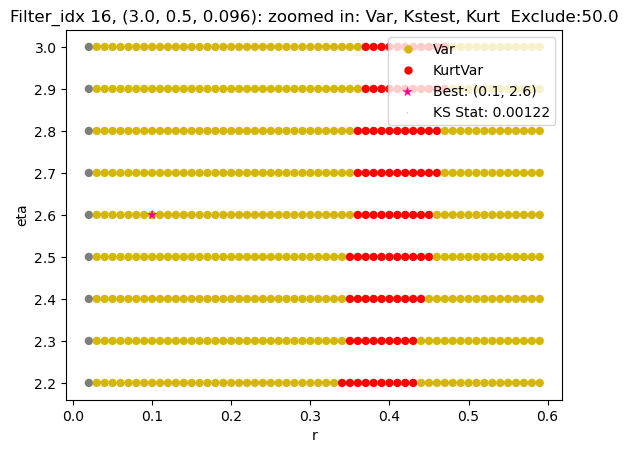

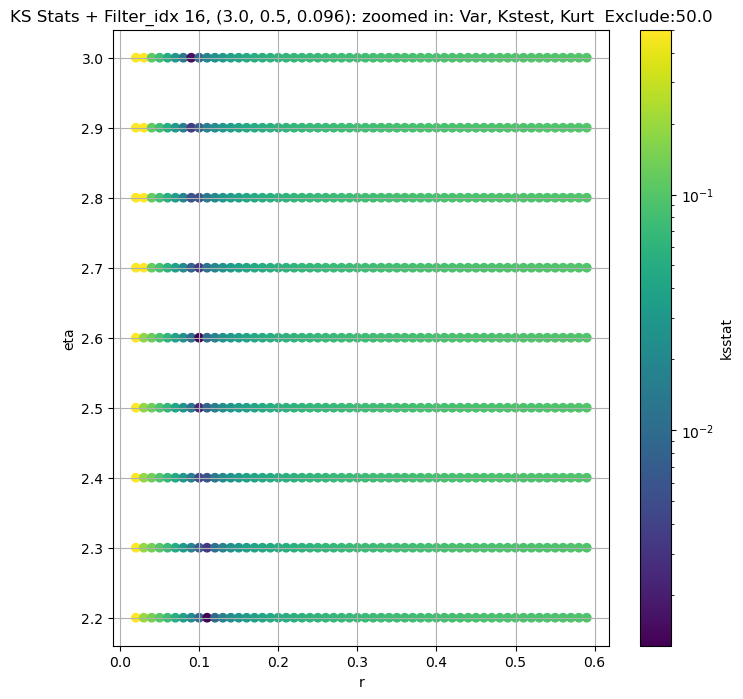

Filter_idx 17, (3.0, 0.5, 0.141):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 17, 200.0 + 100 = 300, ksstat: 0.004700003010715381, var: 831.2935457399483


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 17, 200.0 + 75 = 275, ksstat: 0.004266953083102876, var: 849.9955447581763


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 17, 200.0 + 50 = 250, ksstat: 0.0038197522847130717, var: 870.0472720009635


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 17, 200.0 + 25 = 225, ksstat: 0.0034773696948730004, var: 891.5907242980932


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 17, 200.0 + 0 = 200, ksstat: 0.00320500917433699, var: 914.8199985436313


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 17, 200.0 + -25 = 175, ksstat: 0.0030645444223966756, var: 939.9611133051026


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 17, 200.0 + -50 = 150, ksstat: 0.0035998150059226575, var: 967.3238007044221


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 17, 200.0 + -75 = 125, ksstat: 0.004142100695697759, var: 997.2920939254383


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 17, 200.0 + -100 = 100, ksstat: 0.004675594144930462, var: 1030.4215849100203
Number of samples: 100000, Without approximation : 97416000.0


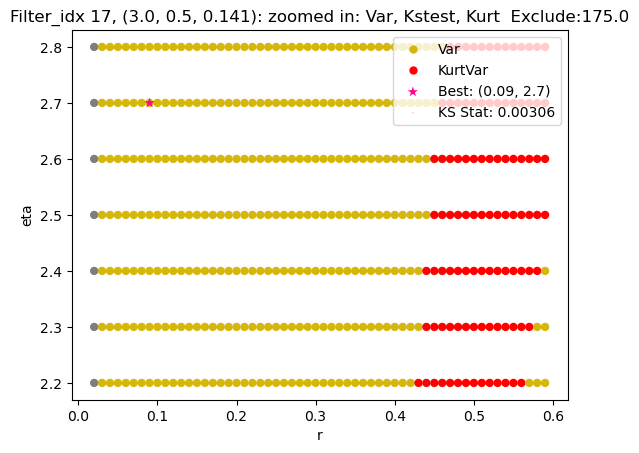

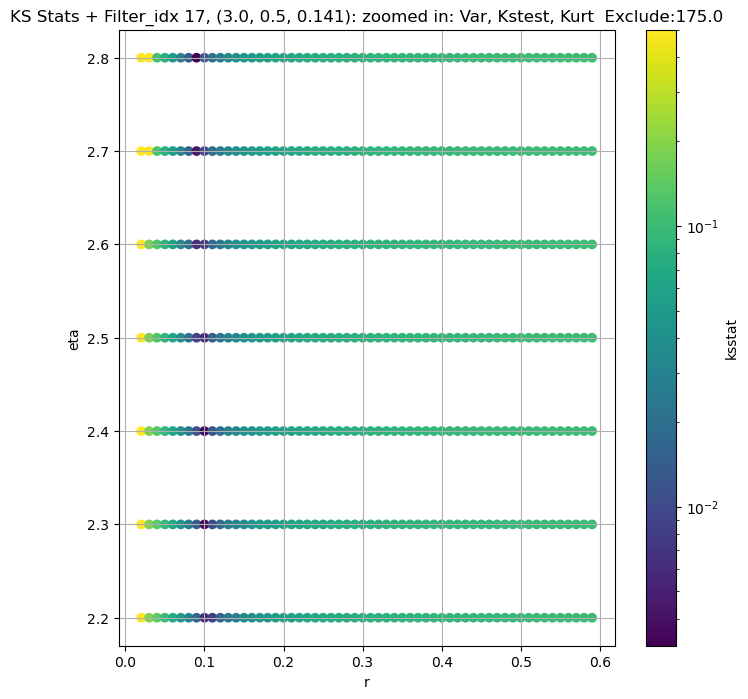

Filter_idx 18, (3.0, 0.5, 0.208):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 18, 200.0 + 100 = 300, ksstat: 0.005168990037050292, var: 162.93502110378975


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 18, 200.0 + 75 = 275, ksstat: 0.004770614058518419, var: 166.3183146793717


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 18, 200.0 + 50 = 250, ksstat: 0.0044066232523344295, var: 169.9310147987594


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 18, 200.0 + 25 = 225, ksstat: 0.004054517120617529, var: 173.79984566058477


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 18, 200.0 + 0 = 200, ksstat: 0.004353274601444079, var: 177.9566191723994


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 18, 200.0 + -25 = 175, ksstat: 0.004117614202492237, var: 182.4429857327284


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 18, 200.0 + -50 = 150, ksstat: 0.004577755351255319, var: 187.3085043729292


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 18, 200.0 + -75 = 125, ksstat: 0.00515241114454662, var: 192.61844516323185


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 18, 200.0 + -100 = 100, ksstat: 0.00572418216232673, var: 198.4594383137327
Number of samples: 100000, Without approximation : 97416000.0


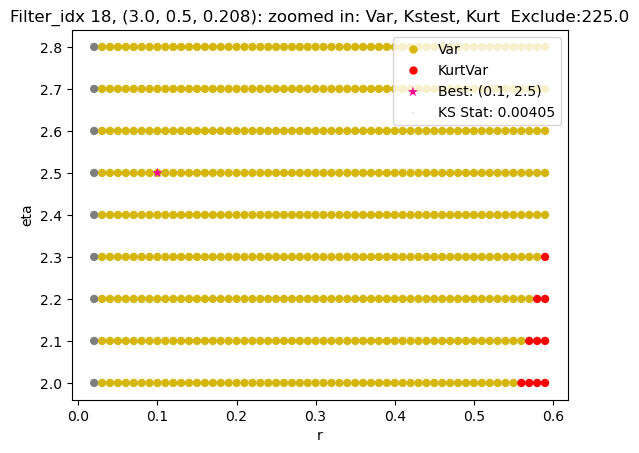

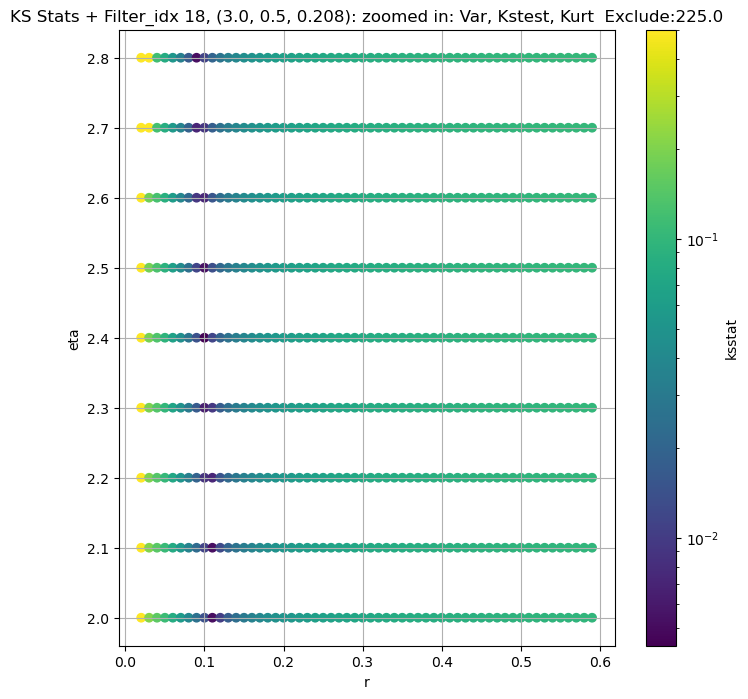

Filter_idx 19, (3.0, 0.5, 0.306):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 200.0 + 100 = 300, ksstat: 0.0060908411880349345, var: 23.340376798883653


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 200.0 + 75 = 275, ksstat: 0.00574067570463499, var: 23.74192775652414


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 200.0 + 50 = 250, ksstat: 0.005328777855589828, var: 24.16978097417362


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 200.0 + 25 = 225, ksstat: 0.004908349824818865, var: 24.627765920700103


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 200.0 + 0 = 200, ksstat: 0.004482362556793795, var: 25.12120094064649


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 200.0 + -25 = 175, ksstat: 0.0047132867630761965, var: 25.656301497714505


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 200.0 + -50 = 150, ksstat: 0.005124043082824659, var: 26.241352782638053


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 200.0 + -75 = 125, ksstat: 0.005535244906200443, var: 26.888983603869175


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 200.0 + -100 = 100, ksstat: 0.0058827666364894005, var: 27.617194903959884
Number of samples: 100000, Without approximation : 97416000.0


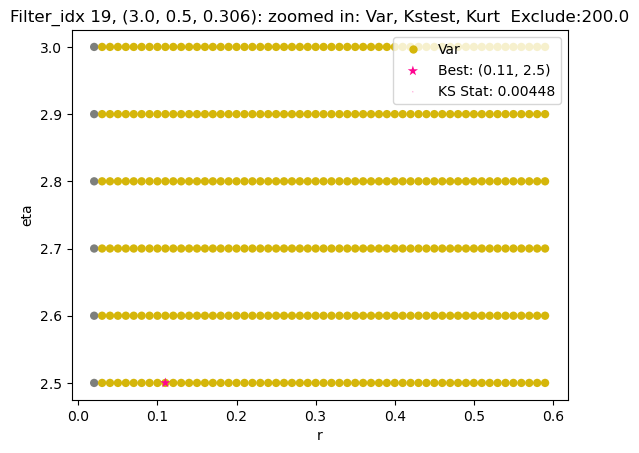

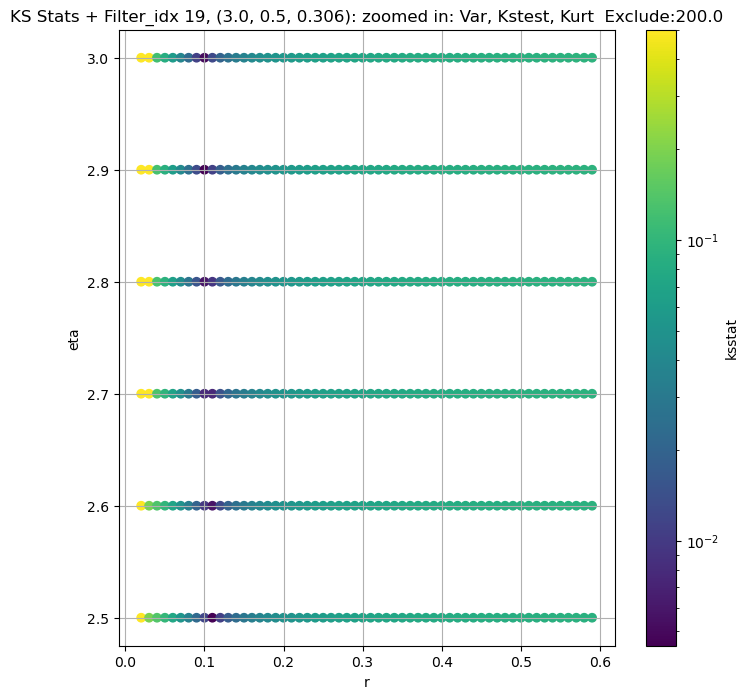

Filter_idx 20, (3.0, 0.5, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 200.0 + 100 = 300, ksstat: 0.006981260380609922, var: 11.047862319437577


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 200.0 + 75 = 275, ksstat: 0.0065293017572895, var: 11.237285197764715


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 200.0 + 50 = 250, ksstat: 0.006238295322392274, var: 11.43921107836493


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 200.0 + 25 = 225, ksstat: 0.005828055515143982, var: 11.655408462232758


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 200.0 + 0 = 200, ksstat: 0.005477387402030853, var: 11.888228593099846


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 200.0 + -25 = 175, ksstat: 0.005205879982911998, var: 12.140833653316248


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 200.0 + -50 = 150, ksstat: 0.005398150881023578, var: 12.417364054181252


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 200.0 + -75 = 125, ksstat: 0.005918773302489078, var: 12.723217577438751


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 200.0 + -100 = 100, ksstat: 0.006314874925561376, var: 13.066948117102886
Number of samples: 100000, Without approximation : 97416000.0


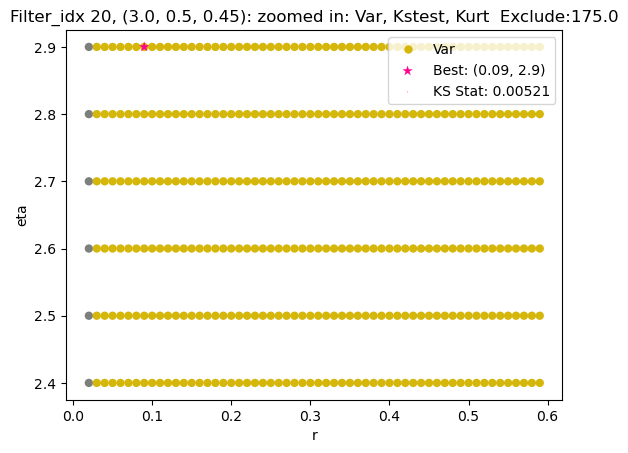

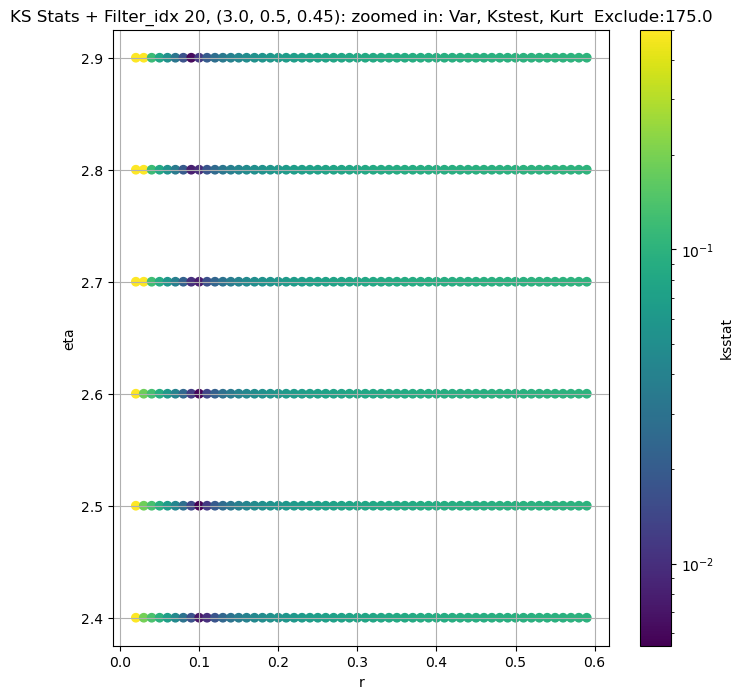

Filter_idx 21, (3.0, 1.0, 0.044):


  0%|          | 0/1384 [00:00<?, ?it/s]

Finding Minimum after computing 1384 CDFs
filter_idx 21, 0.0 + 100 = 100, ksstat: 0.0050551940912831675, var: 18191.512556446218


  0%|          | 0/1384 [00:00<?, ?it/s]

Finding Minimum after computing 1384 CDFs
filter_idx 21, 0.0 + 75 = 75, ksstat: 0.004867751415206567, var: 18418.113327652944


  0%|          | 0/1384 [00:00<?, ?it/s]

Finding Minimum after computing 1384 CDFs
filter_idx 21, 0.0 + 50 = 50, ksstat: 0.004554963810215029, var: 18672.24988496827


  0%|          | 0/1384 [00:00<?, ?it/s]

Finding Minimum after computing 1384 CDFs
filter_idx 21, 0.0 + 25 = 25, ksstat: 0.004379232062857535, var: 18971.91220980728


  0%|          | 0/1384 [00:00<?, ?it/s]

Finding Minimum after computing 1384 CDFs
filter_idx 21, 0.0 + 0 = 0, ksstat: 0.003819450216377529, var: 19461.664975436302
Number of samples: 100000, Without approximation : 97416000.0


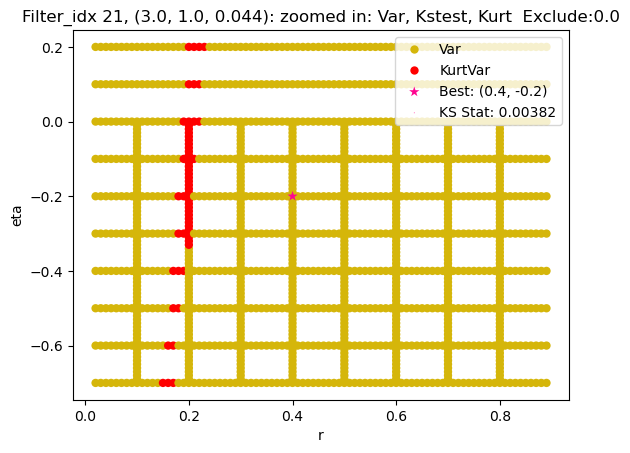

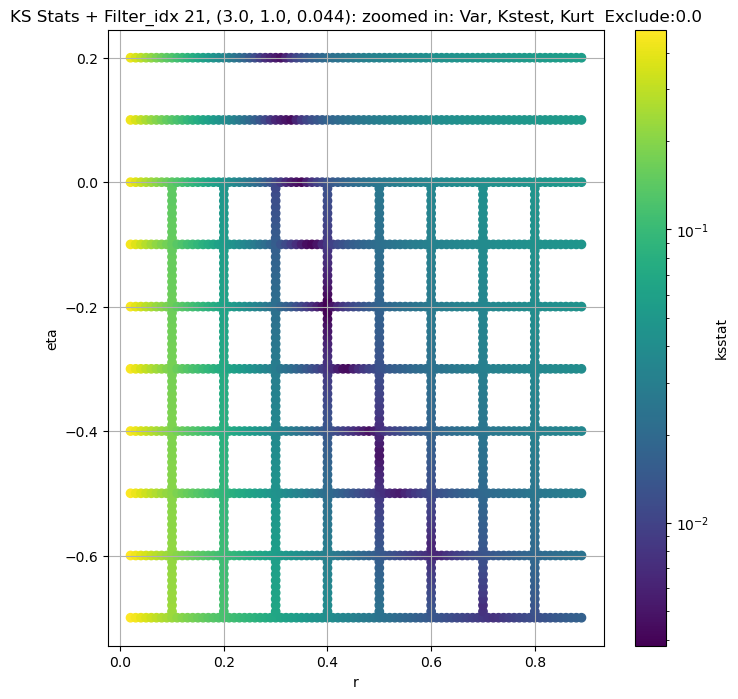

Filter_idx 22, (3.0, 1.0, 0.065):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 0.0 + 100 = 100, ksstat: 0.005868799377405615, var: 6838.241950354838


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 0.0 + 75 = 75, ksstat: 0.005349861911082124, var: 6946.797440670683


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 0.0 + 50 = 50, ksstat: 0.0049660392197965475, var: 7070.19921116048


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 0.0 + 25 = 25, ksstat: 0.00424698259995987, var: 7219.712002492082


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 0.0 + 0 = 0, ksstat: 0.0031244898424055423, var: 7502.823644872465
Number of samples: 100000, Without approximation : 97416000.0


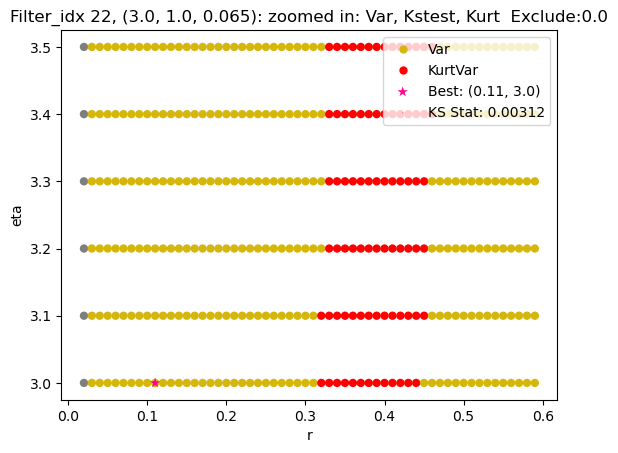

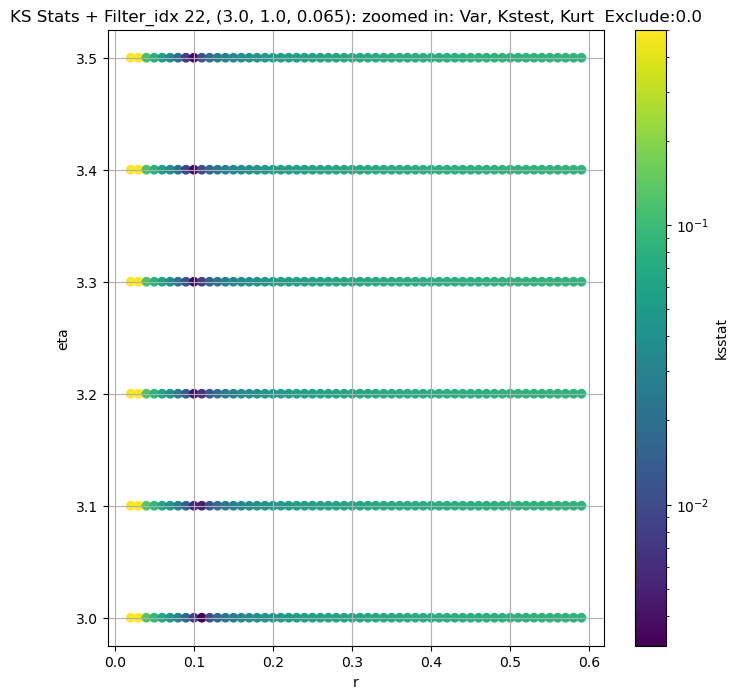

Filter_idx 23, (3.0, 1.0, 0.096):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 50.0 + 100 = 150, ksstat: 0.005490238444636614, var: 2655.1272501660033


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 50.0 + 75 = 125, ksstat: 0.004895813554710228, var: 2709.2957610590674


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 50.0 + 50 = 100, ksstat: 0.004287152275011974, var: 2772.2137947564306


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 50.0 + 25 = 75, ksstat: 0.0036521381279746024, var: 2848.167980655135


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 50.0 + 0 = 50, ksstat: 0.002798141003030552, var: 2944.9424610912633


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 50.0 + -25 = 25, ksstat: 0.002156812905990513, var: 3076.085903785219


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 50.0 + -50 = 0, ksstat: 0.0035821375884688145, var: 3292.0979166151396
Number of samples: 100000, Without approximation : 97416000.0


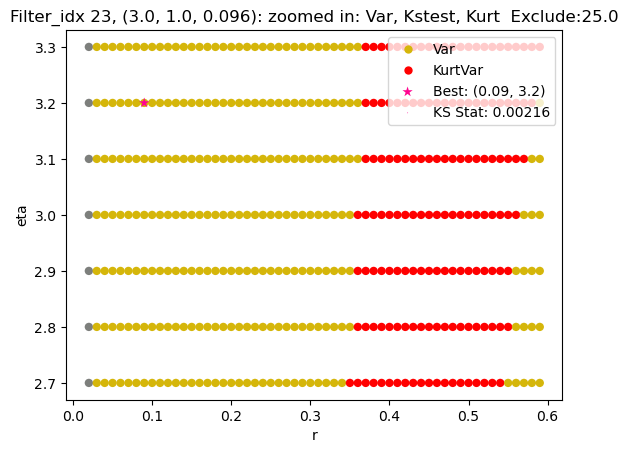

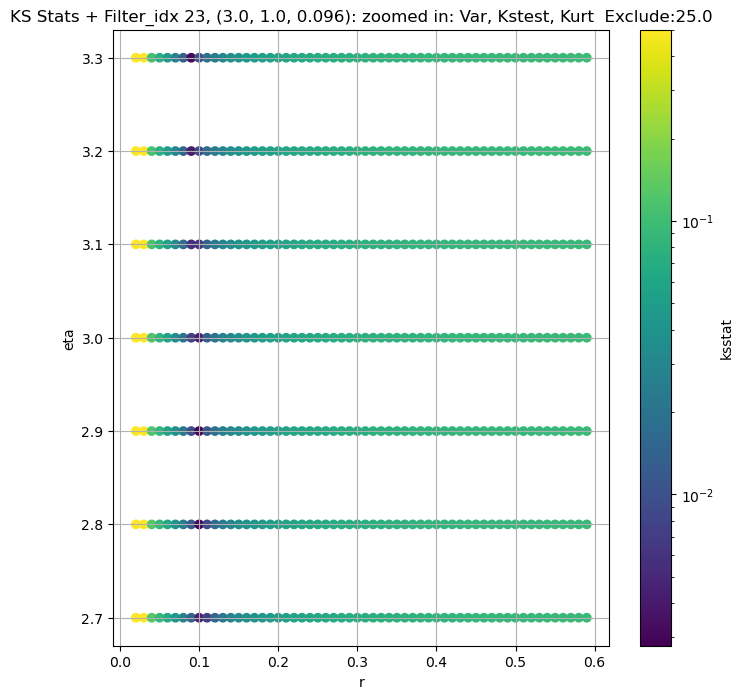

Filter_idx 24, (3.0, 1.0, 0.141):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + 100 = 300, ksstat: 0.005678734073515667, var: 864.6689955809026


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + 75 = 275, ksstat: 0.00519088645076329, var: 882.9750392083598


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + 50 = 250, ksstat: 0.0047338595012358375, var: 903.0265948253902


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + 25 = 225, ksstat: 0.004231701682858691, var: 925.1246612265613


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + 0 = 200, ksstat: 0.0040558922949313625, var: 949.6490696768172


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + -25 = 175, ksstat: 0.003823257585286677, var: 977.0913506410781


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + -50 = 150, ksstat: 0.004599813233573946, var: 1008.0385287847664


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + -75 = 125, ksstat: 0.0053174293538749695, var: 1043.23492743959


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + -100 = 100, ksstat: 0.006068862598529012, var: 1083.7082380663176
Number of samples: 100000, Without approximation : 97416000.0


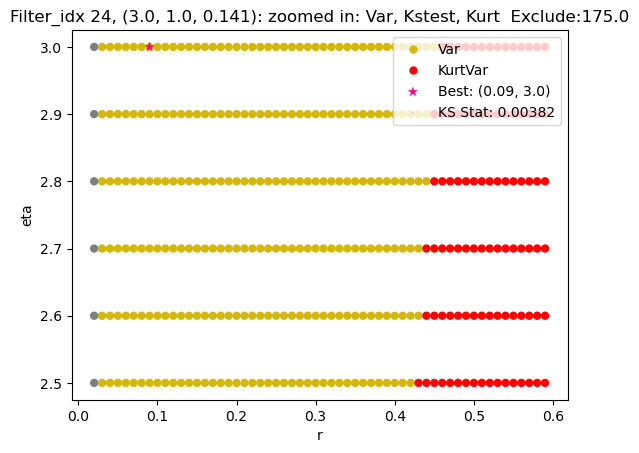

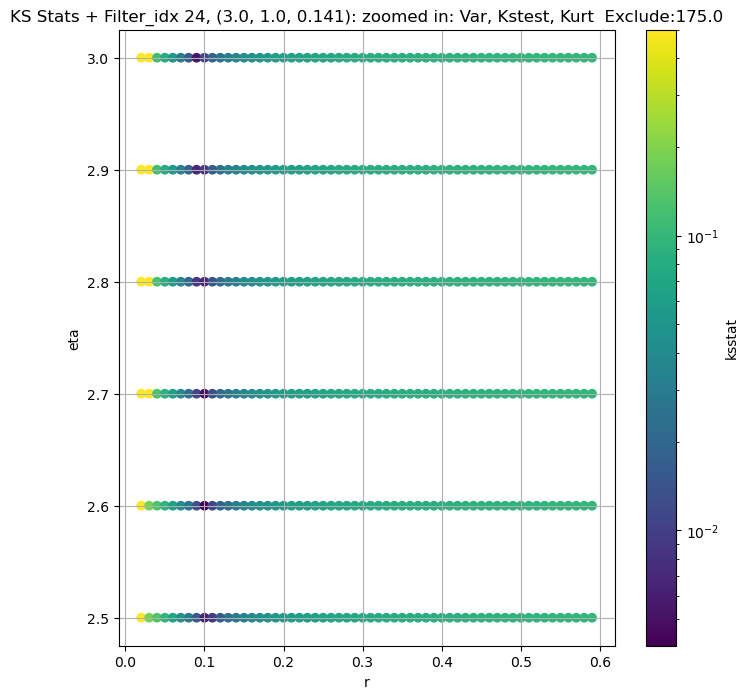

Filter_idx 25, (3.0, 1.0, 0.208):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + 100 = 300, ksstat: 0.005116220859221305, var: 205.53581231066332


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + 75 = 275, ksstat: 0.0047330030660017106, var: 210.24204806143953


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + 50 = 250, ksstat: 0.0053284582364372945, var: 215.34391185963938


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + 25 = 225, ksstat: 0.005947944714651099, var: 220.89625423740347


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + 0 = 200, ksstat: 0.006572257697692874, var: 226.9690110688713


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + -25 = 175, ksstat: 0.006216558511242115, var: 233.64703254699654


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + -50 = 150, ksstat: 0.007012346701554373, var: 241.0290155028409


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + -75 = 125, ksstat: 0.00791590479922688, var: 249.2506159278425


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + -100 = 100, ksstat: 0.008963691711216693, var: 258.47909919466144
Number of samples: 100000, Without approximation : 97416000.0


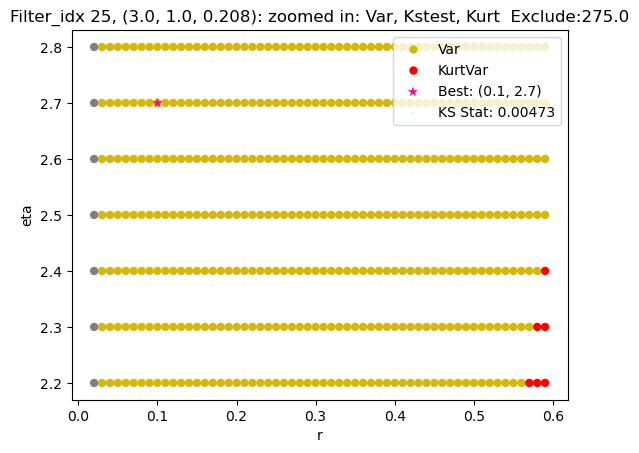

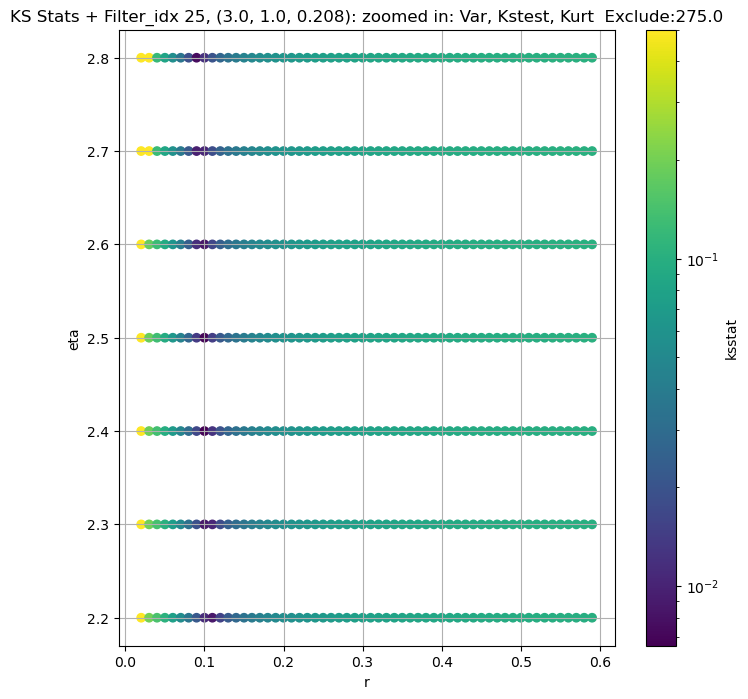

Filter_idx 26, (3.0, 1.0, 0.306):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 200.0 + 100 = 300, ksstat: 0.005573581300141368, var: 32.851298792163966


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 200.0 + 75 = 275, ksstat: 0.005175179090894655, var: 33.47544594278527


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 200.0 + 50 = 250, ksstat: 0.004771280334719075, var: 34.14487356839355


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 200.0 + 25 = 225, ksstat: 0.005179407946694692, var: 34.86597841837425


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 200.0 + 0 = 200, ksstat: 0.005495676293615415, var: 35.64720801703816


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 200.0 + -25 = 175, ksstat: 0.005594825002411485, var: 36.49923335358216


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 200.0 + -50 = 150, ksstat: 0.0062164425865367245, var: 37.43581705079244


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 200.0 + -75 = 125, ksstat: 0.006959691038419313, var: 38.47533585806092


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 200.0 + -100 = 100, ksstat: 0.007332500382422391, var: 39.646210474248186
Number of samples: 100000, Without approximation : 97416000.0


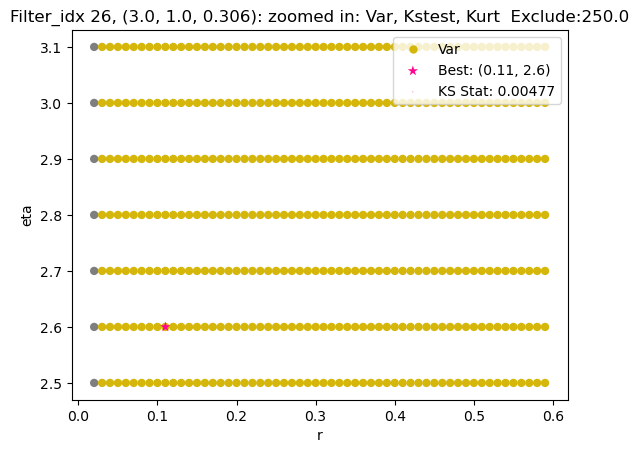

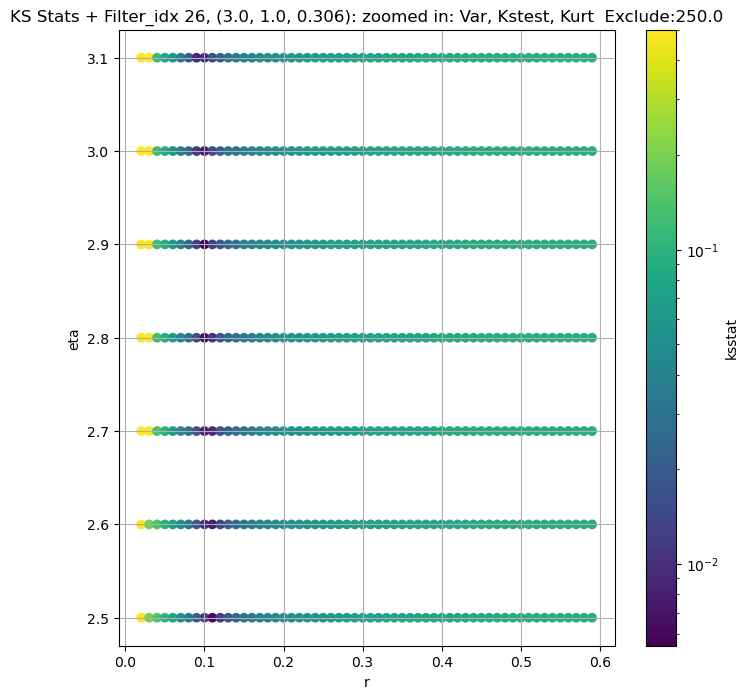

Filter_idx 27, (3.0, 1.0, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 200.0 + 100 = 300, ksstat: 0.006147646016765207, var: 10.694050623115304


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 200.0 + 75 = 275, ksstat: 0.0058166004413980725, var: 10.899879003514537


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 200.0 + 50 = 250, ksstat: 0.006431971772902445, var: 11.120134106044096


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 200.0 + 25 = 225, ksstat: 0.006394916474353751, var: 11.357150534943415


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 200.0 + 0 = 200, ksstat: 0.006367422575919046, var: 11.61416459339954


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 200.0 + -25 = 175, ksstat: 0.0069769928788425695, var: 11.895233462344079


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 200.0 + -50 = 150, ksstat: 0.007208467387467943, var: 12.205879189477068


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 200.0 + -75 = 125, ksstat: 0.007569851003384698, var: 12.554437507084984


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 200.0 + -100 = 100, ksstat: 0.008112117548603859, var: 12.954611661678335
Number of samples: 100000, Without approximation : 97416000.0


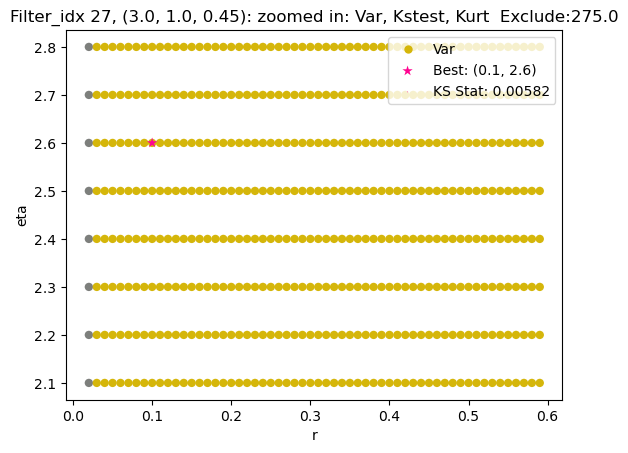

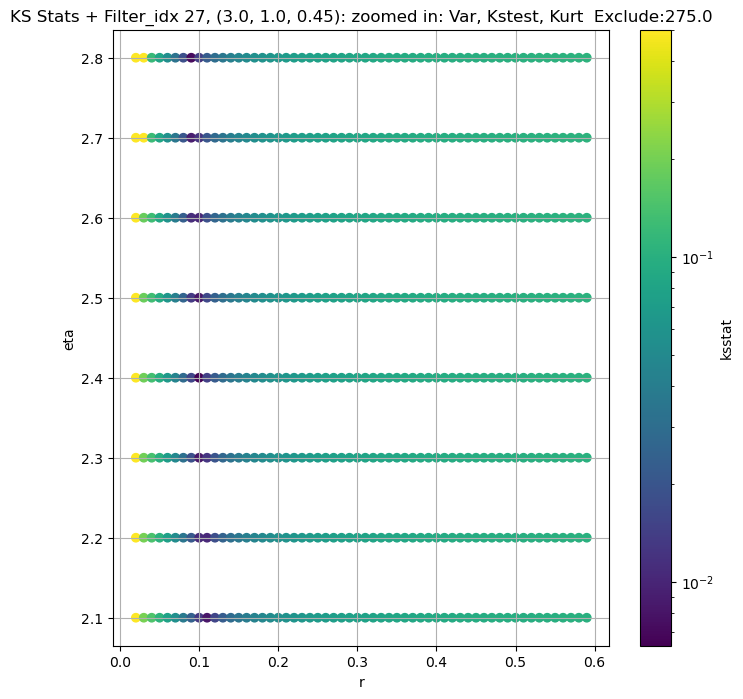

Filter_idx 28, (4.0, 0.5, 0.044):


  0%|          | 0/1547 [00:00<?, ?it/s]

Finding Minimum after computing 1547 CDFs
filter_idx 28, 0.0 + 100 = 100, ksstat: 0.004224832733720346, var: 14983.790858818911


  0%|          | 0/1547 [00:00<?, ?it/s]

Finding Minimum after computing 1547 CDFs
filter_idx 28, 0.0 + 75 = 75, ksstat: 0.003977376679777045, var: 15151.122187941035


  0%|          | 0/1547 [00:00<?, ?it/s]

Finding Minimum after computing 1547 CDFs
filter_idx 28, 0.0 + 50 = 50, ksstat: 0.003657240787669158, var: 15339.433814716229


  0%|          | 0/1547 [00:00<?, ?it/s]

Finding Minimum after computing 1547 CDFs
filter_idx 28, 0.0 + 25 = 25, ksstat: 0.0034439043201008393, var: 15563.526636571069


  0%|          | 0/1547 [00:00<?, ?it/s]

Finding Minimum after computing 1547 CDFs
filter_idx 28, 0.0 + 0 = 0, ksstat: 0.0028743030779969647, var: 15959.524379806357
Number of samples: 100000, Without approximation : 97416000.0


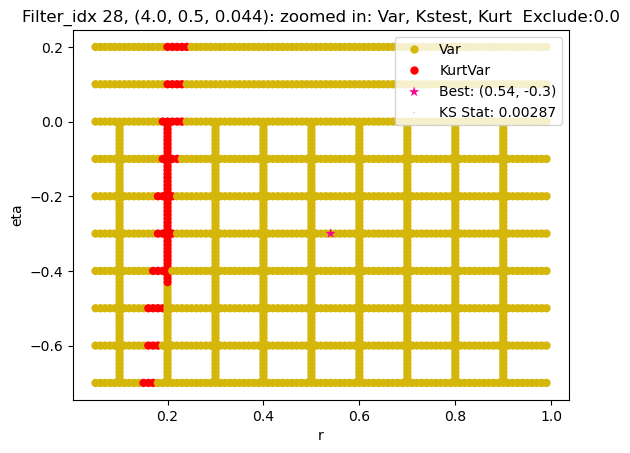

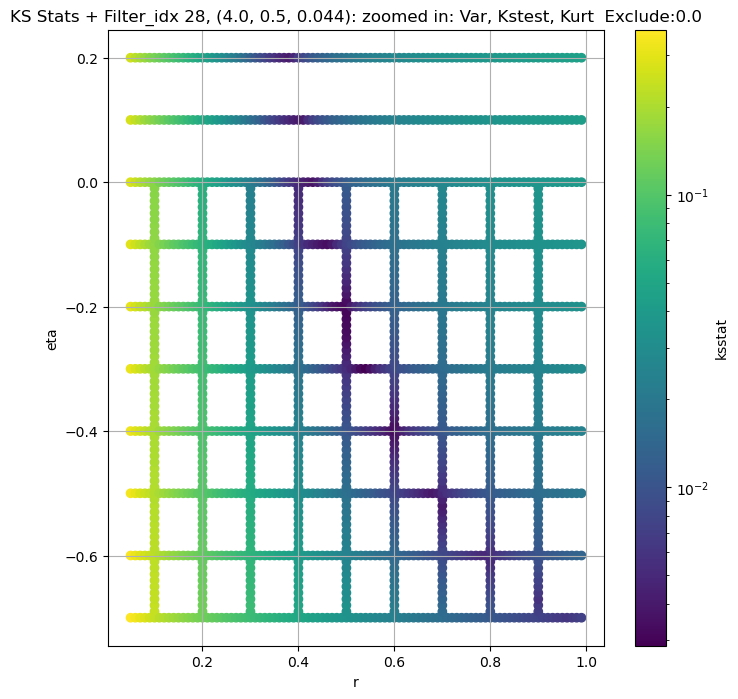

Filter_idx 29, (4.0, 0.5, 0.065):


  0%|          | 0/1224 [00:00<?, ?it/s]

Finding Minimum after computing 1224 CDFs
filter_idx 29, 0.0 + 100 = 100, ksstat: 0.003157415191531676, var: 5621.989691412358


  0%|          | 0/1224 [00:00<?, ?it/s]

Finding Minimum after computing 1224 CDFs
filter_idx 29, 0.0 + 75 = 75, ksstat: 0.0027422733972494173, var: 5699.172891704447


  0%|          | 0/1224 [00:00<?, ?it/s]

Finding Minimum after computing 1224 CDFs
filter_idx 29, 0.0 + 50 = 50, ksstat: 0.0024083688208080822, var: 5786.552070277564


  0%|          | 0/1224 [00:00<?, ?it/s]

Finding Minimum after computing 1224 CDFs
filter_idx 29, 0.0 + 25 = 25, ksstat: 0.0020452302025197044, var: 5891.761911690175


  0%|          | 0/1224 [00:00<?, ?it/s]

Finding Minimum after computing 1224 CDFs
filter_idx 29, 0.0 + 0 = 0, ksstat: 0.0016673312384977157, var: 6084.367494549321
Number of samples: 100000, Without approximation : 97416000.0


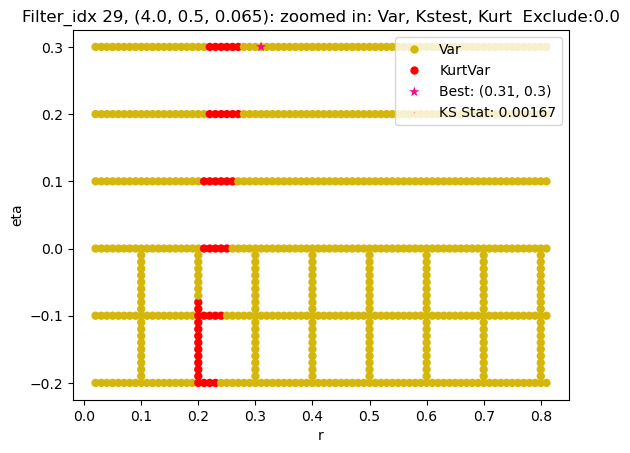

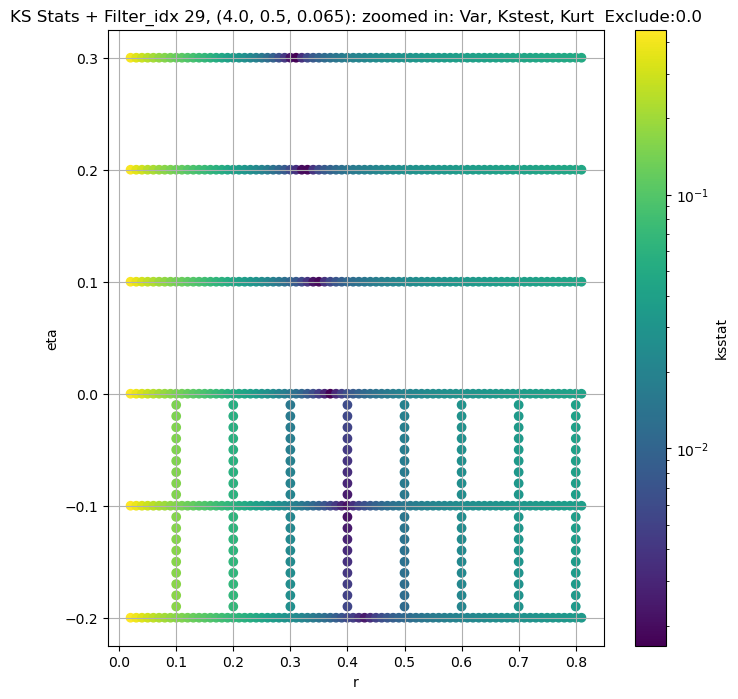

Filter_idx 30, (4.0, 0.5, 0.096):


  0%|          | 0/690 [00:00<?, ?it/s]

Finding Minimum after computing 690 CDFs
filter_idx 30, 0.0 + 100 = 100, ksstat: 0.003950242488287459, var: 2108.150250858724


  0%|          | 0/690 [00:00<?, ?it/s]

Finding Minimum after computing 690 CDFs
filter_idx 30, 0.0 + 75 = 75, ksstat: 0.0035641043307227394, var: 2144.5691908503345


  0%|          | 0/690 [00:00<?, ?it/s]

Finding Minimum after computing 690 CDFs
filter_idx 30, 0.0 + 50 = 50, ksstat: 0.0031567366215984327, var: 2186.7402905299086


  0%|          | 0/690 [00:00<?, ?it/s]

Finding Minimum after computing 690 CDFs
filter_idx 30, 0.0 + 25 = 25, ksstat: 0.0024466494687481743, var: 2239.925024962271


  0%|          | 0/690 [00:00<?, ?it/s]

Finding Minimum after computing 690 CDFs
filter_idx 30, 0.0 + 0 = 0, ksstat: 0.001378112978604129, var: 2342.4910108625904
Number of samples: 100000, Without approximation : 97416000.0


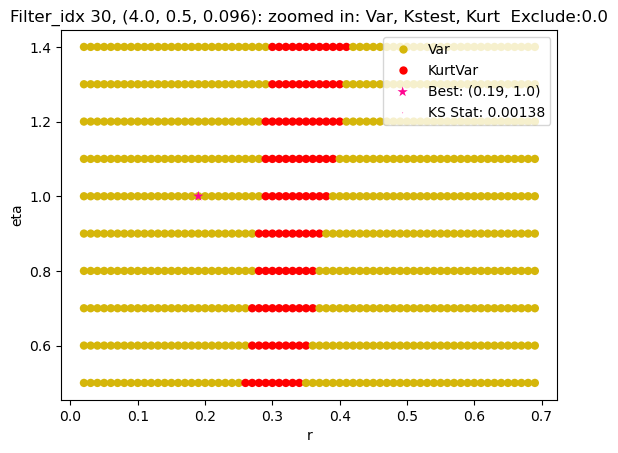

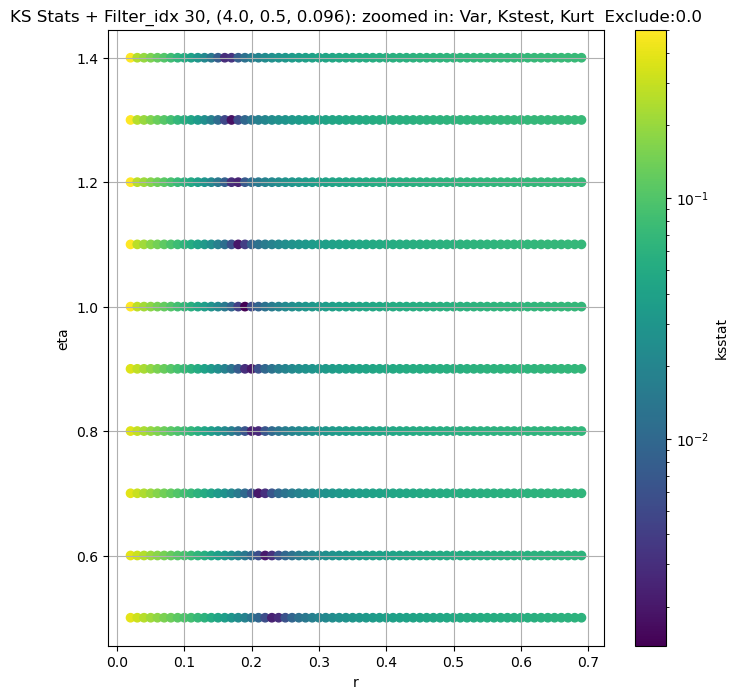

Filter_idx 31, (4.0, 0.5, 0.141):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + 100 = 200, ksstat: 0.0044524453972165645, var: 621.8594976690248


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + 75 = 175, ksstat: 0.004025333517934378, var: 634.964619397871


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + 50 = 150, ksstat: 0.0034623007993526134, var: 649.5595666340909


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + 25 = 125, ksstat: 0.002944888693975356, var: 666.008548773507


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + 0 = 100, ksstat: 0.0029946282234737664, var: 684.8335323470283


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + -25 = 75, ksstat: 0.0034560534874752413, var: 706.7224509525869


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + -50 = 50, ksstat: 0.0036212988724876882, var: 732.7362010654392


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + -75 = 25, ksstat: 0.004541373425926087, var: 765.0941424552499


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + -100 = 0, ksstat: 0.005708097097759102, var: 816.9889181116595
Number of samples: 100000, Without approximation : 97416000.0


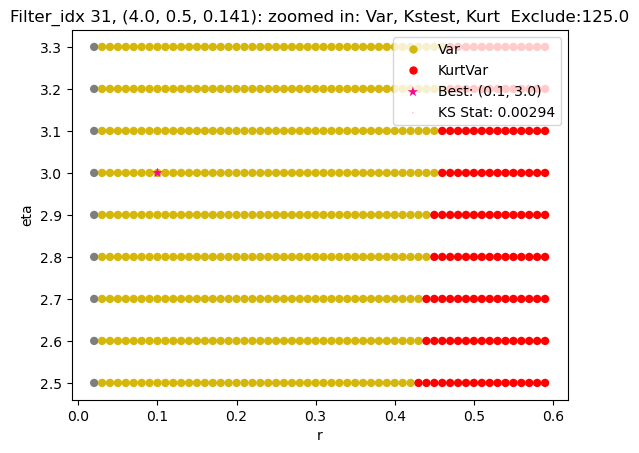

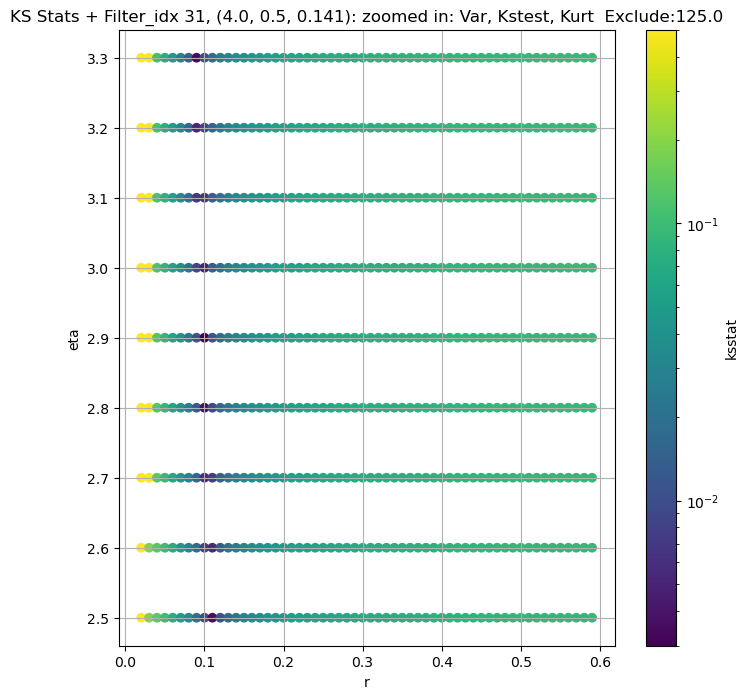

Filter_idx 32, (4.0, 0.5, 0.208):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 32, 200.0 + 100 = 300, ksstat: 0.005246229665339164, var: 103.1502375846697


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 32, 200.0 + 75 = 275, ksstat: 0.004838961712432144, var: 105.07874707117789


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 32, 200.0 + 50 = 250, ksstat: 0.004430834605039314, var: 107.15507063290462


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 32, 200.0 + 25 = 225, ksstat: 0.004054990290410232, var: 109.4019355198939


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 32, 200.0 + 0 = 200, ksstat: 0.003935524156814557, var: 111.8490808828572


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 32, 200.0 + -25 = 175, ksstat: 0.0038431195839054855, var: 114.52988168600783


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 32, 200.0 + -50 = 150, ksstat: 0.0046577155630537215, var: 117.48791599870523


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 32, 200.0 + -75 = 125, ksstat: 0.005107867397292631, var: 120.7833437925662


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 32, 200.0 + -100 = 100, ksstat: 0.005451779139571816, var: 124.49362956360899
Number of samples: 100000, Without approximation : 97416000.0


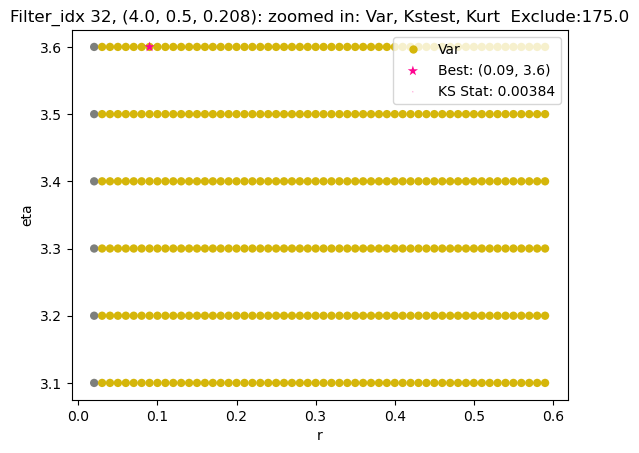

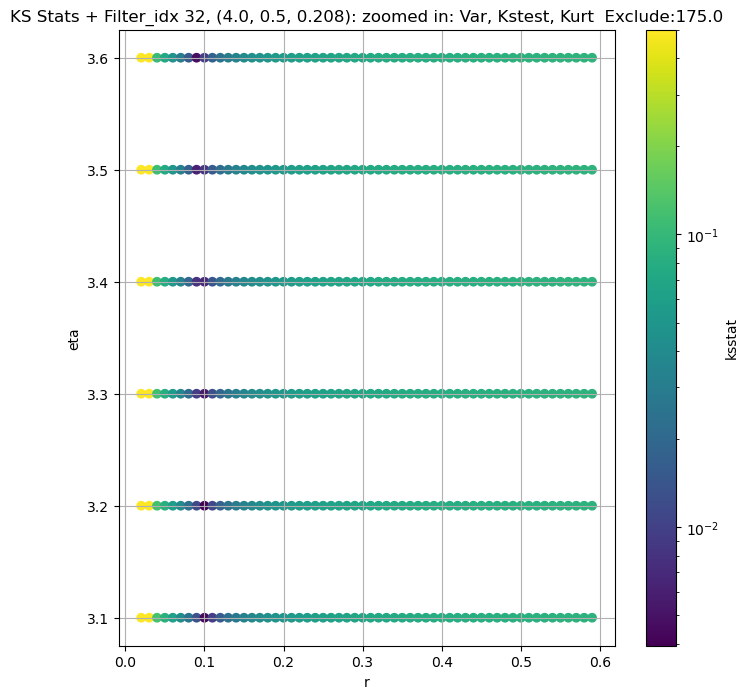

Filter_idx 33, (4.0, 0.5, 0.306):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + 100 = 300, ksstat: 0.0058049402462416085, var: 10.966171630341726


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + 75 = 275, ksstat: 0.005421728880925625, var: 11.128277489788111


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + 50 = 250, ksstat: 0.00500297019462026, var: 11.30116218633832


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + 25 = 225, ksstat: 0.004596866152349211, var: 11.486615842876517


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + 0 = 200, ksstat: 0.004205705761846867, var: 11.686811879972183


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + -25 = 175, ksstat: 0.003769159142669065, var: 11.904913375193981


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + -50 = 150, ksstat: 0.0037914304699076806, var: 12.145334554018486


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + -75 = 125, ksstat: 0.004544711786511724, var: 12.414711607294846


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + -100 = 100, ksstat: 0.0048120629149026595, var: 12.723865546210664
Number of samples: 100000, Without approximation : 97416000.0


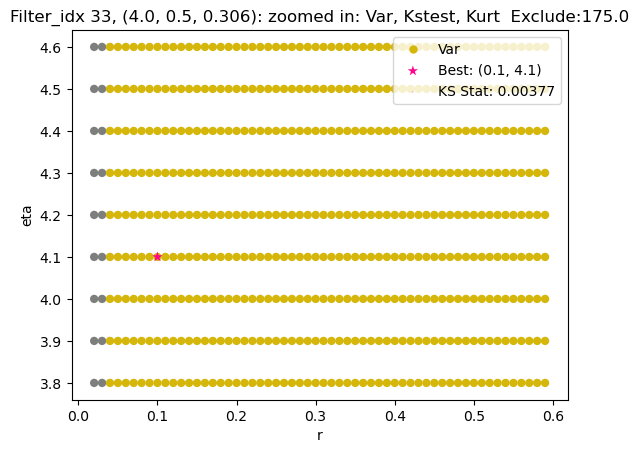

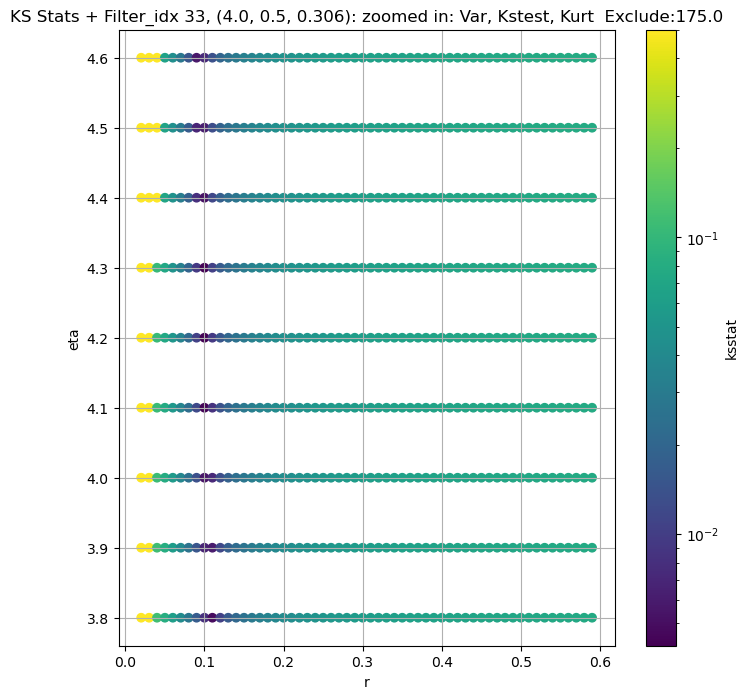

Filter_idx 34, (4.0, 0.5, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + 100 = 300, ksstat: 0.006323483901987888, var: 10.89388583130674


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + 75 = 275, ksstat: 0.005981351808725832, var: 11.088497978787787


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + 50 = 250, ksstat: 0.005646713542481918, var: 11.295666476705822


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + 25 = 225, ksstat: 0.005239894994762479, var: 11.517198005182339


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + 0 = 200, ksstat: 0.005565681117690624, var: 11.755219815401201


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + -25 = 175, ksstat: 0.005647031287027926, var: 12.012456024258817


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + -50 = 150, ksstat: 0.006226763890251064, var: 12.29281036076269


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + -75 = 125, ksstat: 0.006802071242307639, var: 12.601699692167433


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + -100 = 100, ksstat: 0.007211860925518954, var: 12.947061588160338
Number of samples: 100000, Without approximation : 97416000.0


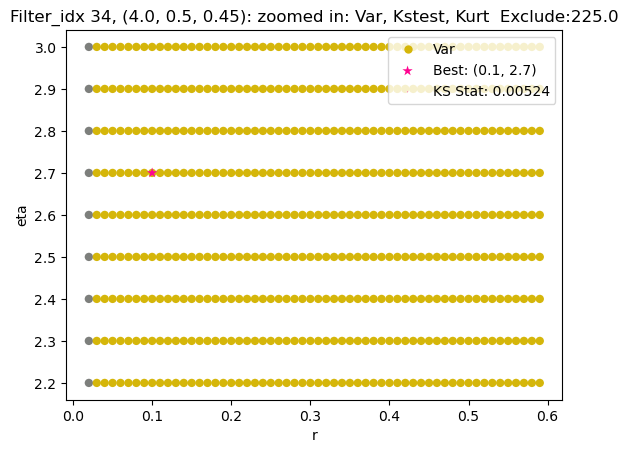

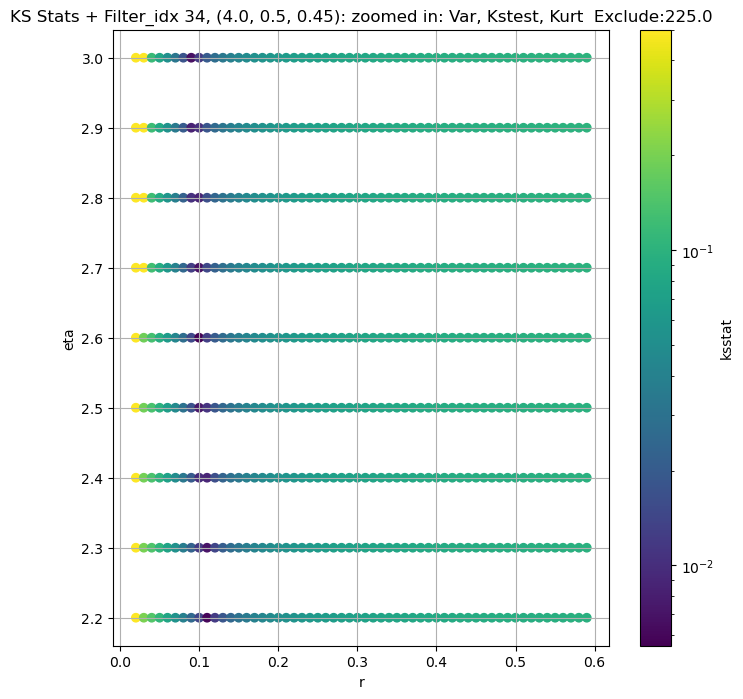

Filter_idx 35, (4.0, 1.0, 0.044):


  0%|          | 0/1710 [00:00<?, ?it/s]

Finding Minimum after computing 1710 CDFs
filter_idx 35, 0.0 + 100 = 100, ksstat: 0.0035288394974225534, var: 17999.83943532078


  0%|          | 0/1710 [00:00<?, ?it/s]

Finding Minimum after computing 1710 CDFs
filter_idx 35, 0.0 + 75 = 75, ksstat: 0.0032628088946196065, var: 18192.13949061196


  0%|          | 0/1710 [00:00<?, ?it/s]

Finding Minimum after computing 1710 CDFs
filter_idx 35, 0.0 + 50 = 50, ksstat: 0.002790936669814781, var: 18407.101118804818


  0%|          | 0/1710 [00:00<?, ?it/s]

Finding Minimum after computing 1710 CDFs
filter_idx 35, 0.0 + 25 = 25, ksstat: 0.0025718565343522404, var: 18661.114862111288


  0%|          | 0/1710 [00:00<?, ?it/s]

Finding Minimum after computing 1710 CDFs
filter_idx 35, 0.0 + 0 = 0, ksstat: 0.0021133731912075238, var: 19069.550394195438
Number of samples: 100000, Without approximation : 97416000.0


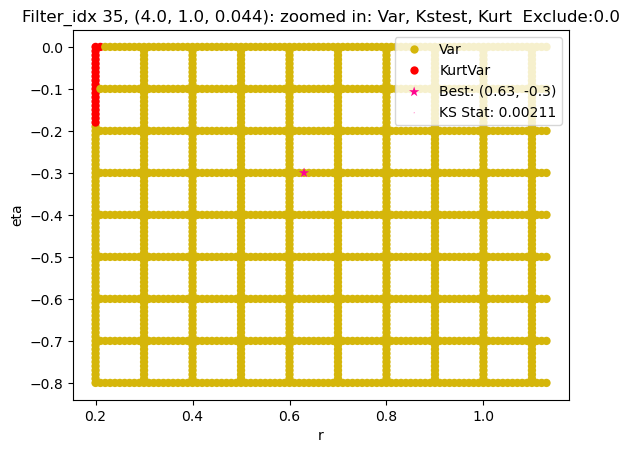

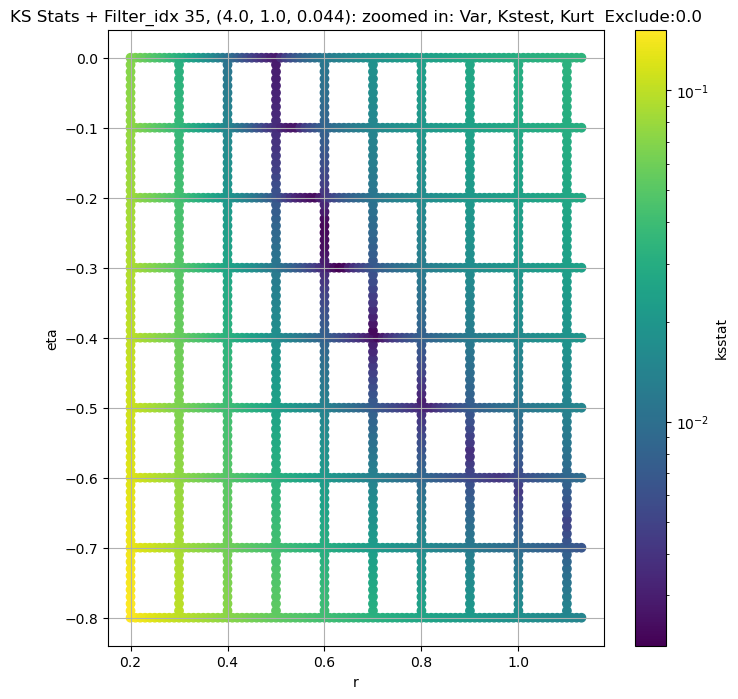

Filter_idx 36, (4.0, 1.0, 0.065):


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 36, 0.0 + 100 = 100, ksstat: 0.0037177690032725863, var: 6087.951811984357


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 36, 0.0 + 75 = 75, ksstat: 0.0031812441310881123, var: 6178.598816682962


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 36, 0.0 + 50 = 50, ksstat: 0.0026774304826384654, var: 6281.005340109118


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 36, 0.0 + 25 = 25, ksstat: 0.002107047609661298, var: 6402.992100096447


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 36, 0.0 + 0 = 0, ksstat: 0.0016842907963384168, var: 6604.594914861366
Number of samples: 100000, Without approximation : 97416000.0


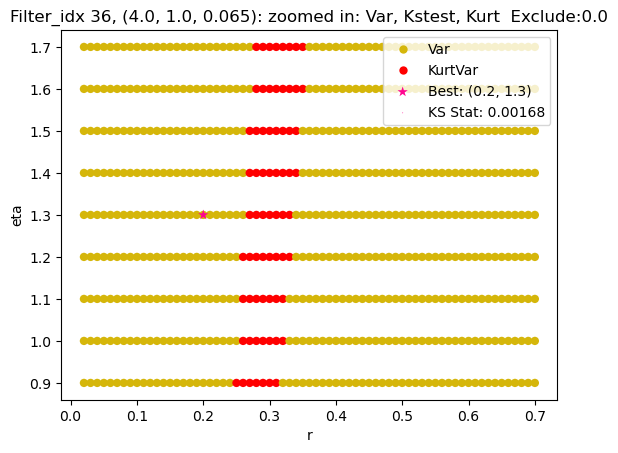

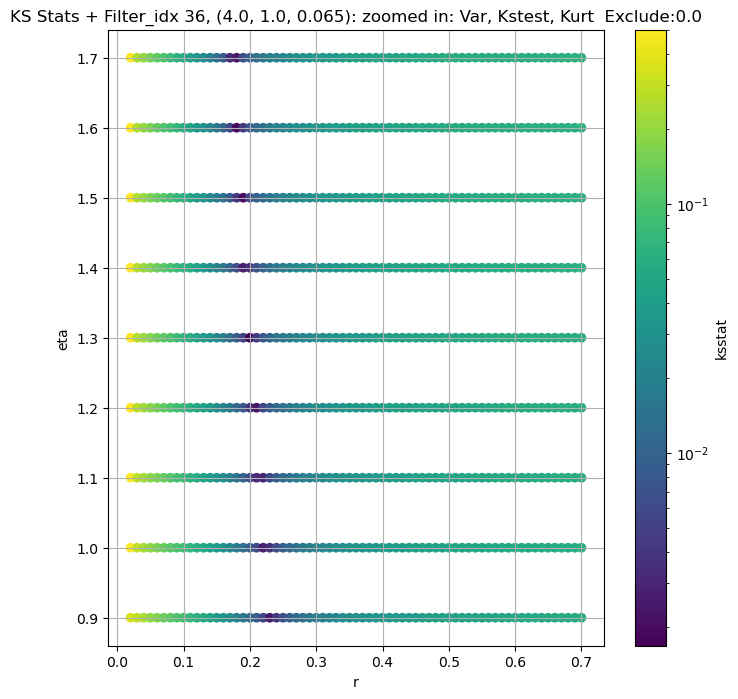

Filter_idx 37, (4.0, 1.0, 0.096):


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 37, 0.0 + 100 = 100, ksstat: 0.004512710707788414, var: 2187.4746829760684


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 37, 0.0 + 75 = 75, ksstat: 0.003937052741227354, var: 2226.1927250057192


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 37, 0.0 + 50 = 50, ksstat: 0.0034016917066120797, var: 2270.871661597697


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 37, 0.0 + 25 = 25, ksstat: 0.0025460989444722817, var: 2325.69766101142


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 37, 0.0 + 0 = 0, ksstat: 0.0014856848832985048, var: 2429.823945449952
Number of samples: 100000, Without approximation : 97416000.0


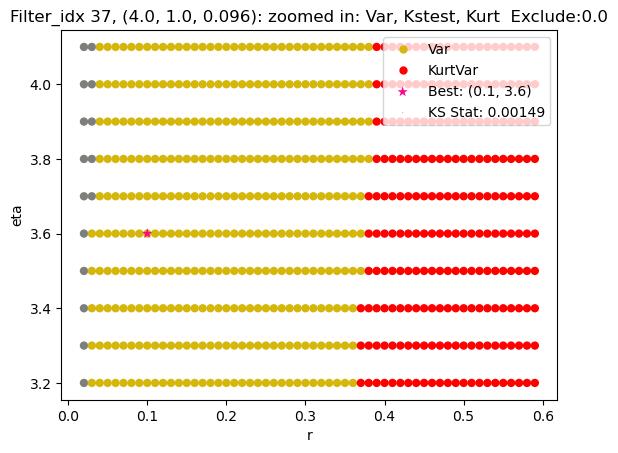

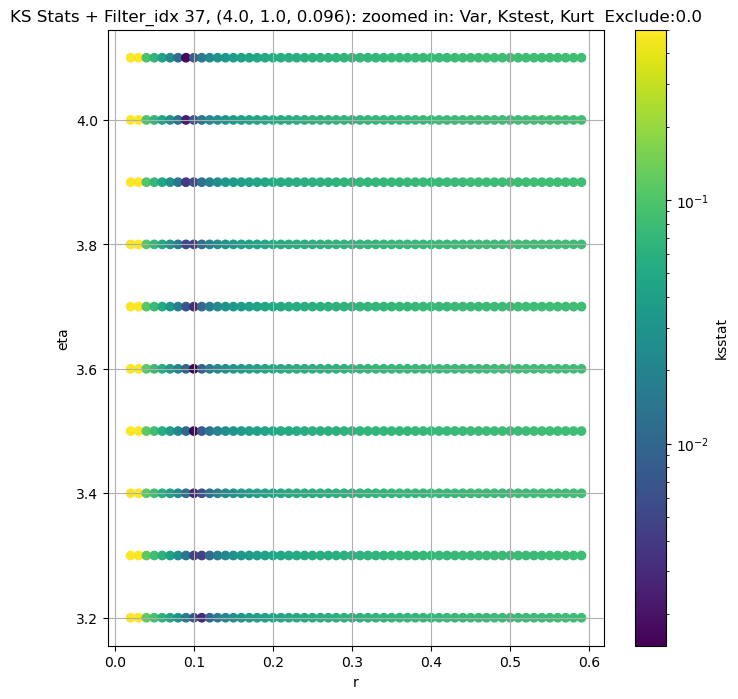

Filter_idx 38, (4.0, 1.0, 0.141):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + 100 = 200, ksstat: 0.004806407955201195, var: 613.161315029407


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + 75 = 175, ksstat: 0.004338909267960038, var: 624.6189191887721


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + 50 = 150, ksstat: 0.003918955857749585, var: 637.2693196030431


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + 25 = 125, ksstat: 0.0033897085614356115, var: 651.4657237717761


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + 0 = 100, ksstat: 0.003605751157281789, var: 667.7756238507421


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + -25 = 75, ksstat: 0.00416055283356398, var: 687.2386448403408


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + -50 = 50, ksstat: 0.004718549100214076, var: 711.9505025434802


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + -75 = 25, ksstat: 0.005918679466504456, var: 747.0531987575217


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + -100 = 0, ksstat: 0.0075166585632744365, var: 818.5766002915587
Number of samples: 100000, Without approximation : 97416000.0


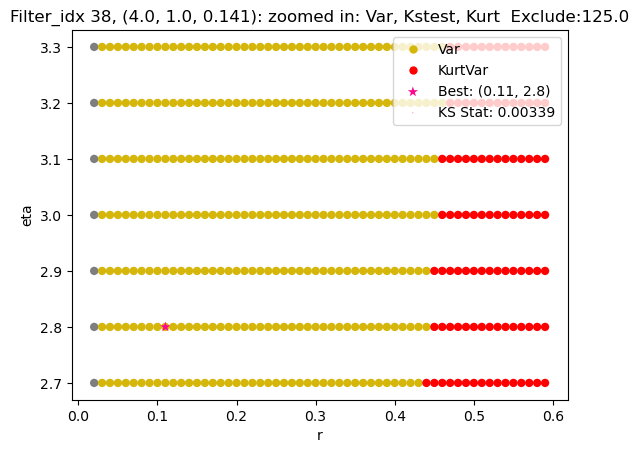

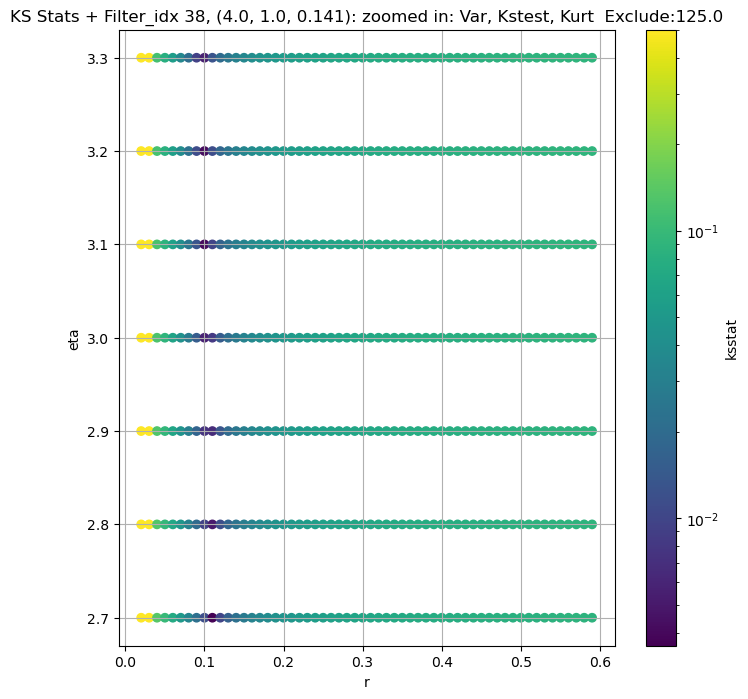

Filter_idx 39, (4.0, 1.0, 0.208):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + 100 = 300, ksstat: 0.0050839539829809904, var: 112.4032986335516


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + 75 = 275, ksstat: 0.004712864080502583, var: 114.57779597368825


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + 50 = 250, ksstat: 0.004368563388640589, var: 116.92834554895781


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + 25 = 225, ksstat: 0.004566629405942879, var: 119.48800364737934


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + 0 = 200, ksstat: 0.004765392429481541, var: 122.29492913228287


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + -25 = 175, ksstat: 0.005411461031835985, var: 125.40718681605345


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + -50 = 150, ksstat: 0.005798081267740285, var: 128.89694427512308


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + -75 = 125, ksstat: 0.006668416312331393, var: 132.86314489387658


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + -100 = 100, ksstat: 0.007403023382111629, var: 137.4529097026278
Number of samples: 100000, Without approximation : 97416000.0


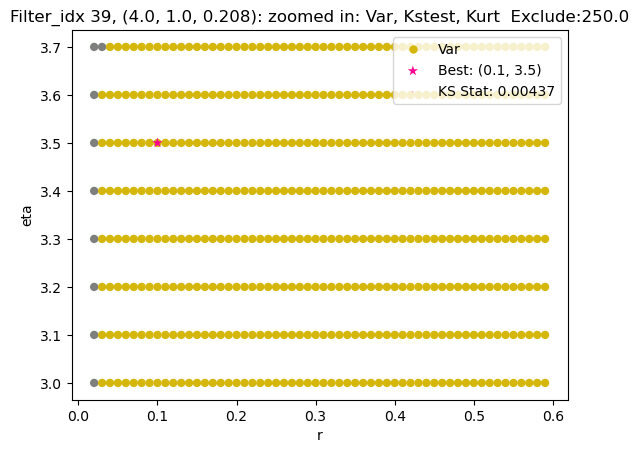

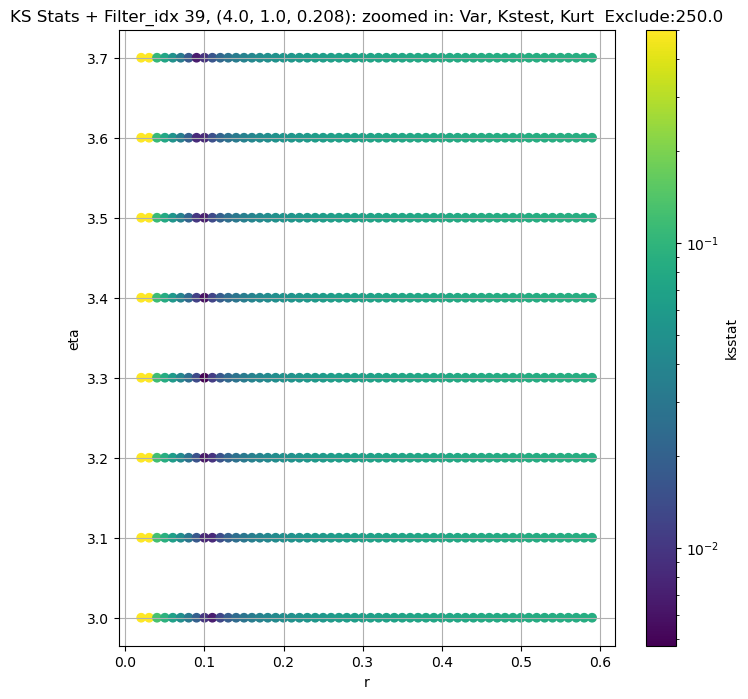

Filter_idx 40, (4.0, 1.0, 0.306):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + 100 = 300, ksstat: 0.005179297441249824, var: 12.972617289135027


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + 75 = 275, ksstat: 0.004807614644925889, var: 13.185403675272775


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + 50 = 250, ksstat: 0.004412087133631372, var: 13.414496881411543


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + 25 = 225, ksstat: 0.0040549835991835915, var: 13.662934460884376


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + 0 = 200, ksstat: 0.003768994717603391, var: 13.934427727040662


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + -25 = 175, ksstat: 0.004468554452494944, var: 14.23414373220409


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + -50 = 150, ksstat: 0.004528027966500647, var: 14.569158443300621


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + -75 = 125, ksstat: 0.00535049744224958, var: 14.94975209055635


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + -100 = 100, ksstat: 0.006008889325457373, var: 15.393014018312115
Number of samples: 100000, Without approximation : 97416000.0


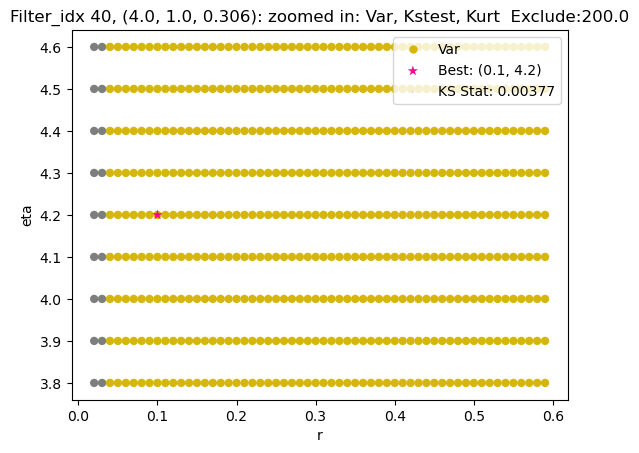

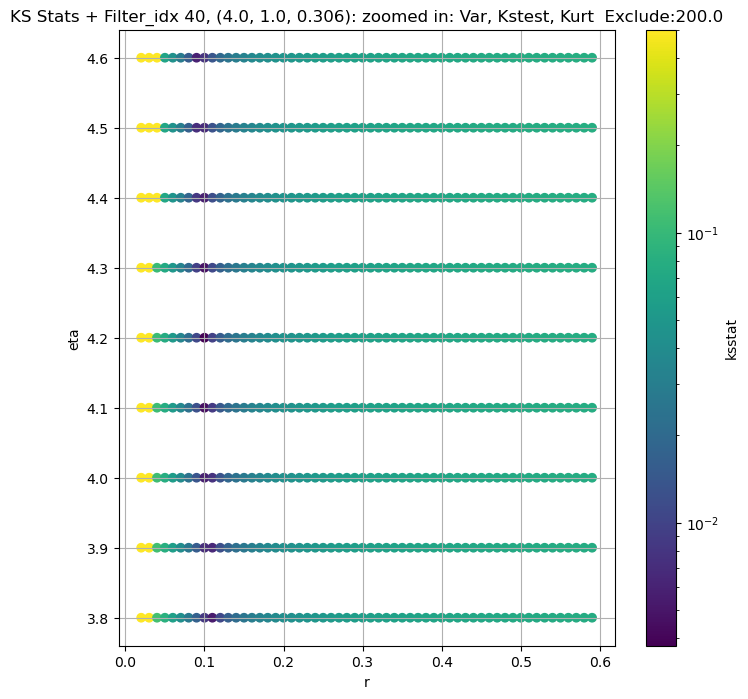

Filter_idx 41, (4.0, 1.0, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 100 = 300, ksstat: 0.009849432930072788, var: 8.39037929361786


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 75 = 275, ksstat: 0.010060484939637515, var: 8.609701849849138


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 50 = 250, ksstat: 0.010605234680149178, var: 8.84852158642641


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 25 = 225, ksstat: 0.011532461457070986, var: 9.110275366922929


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 0 = 200, ksstat: 0.011951142151984673, var: 9.39956658002136


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + -25 = 175, ksstat: 0.012746368098110056, var: 9.722680748839315


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + -50 = 150, ksstat: 0.01349544110014711, var: 10.087861575710077


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + -75 = 125, ksstat: 0.014261411352994524, var: 10.506979745162896


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + -100 = 100, ksstat: 0.014737119168559243, var: 10.997314081692126
Number of samples: 100000, Without approximation : 97416000.0


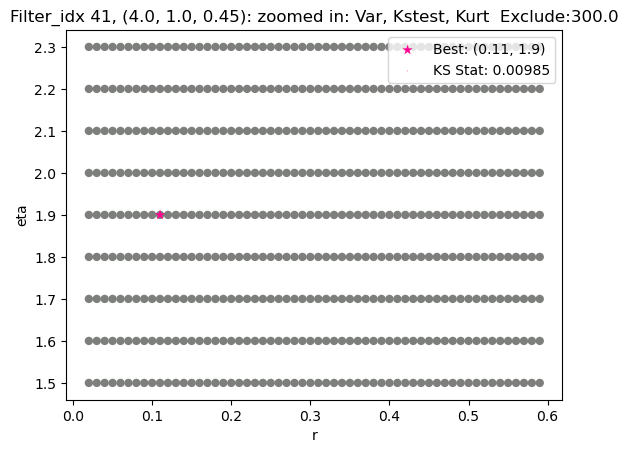

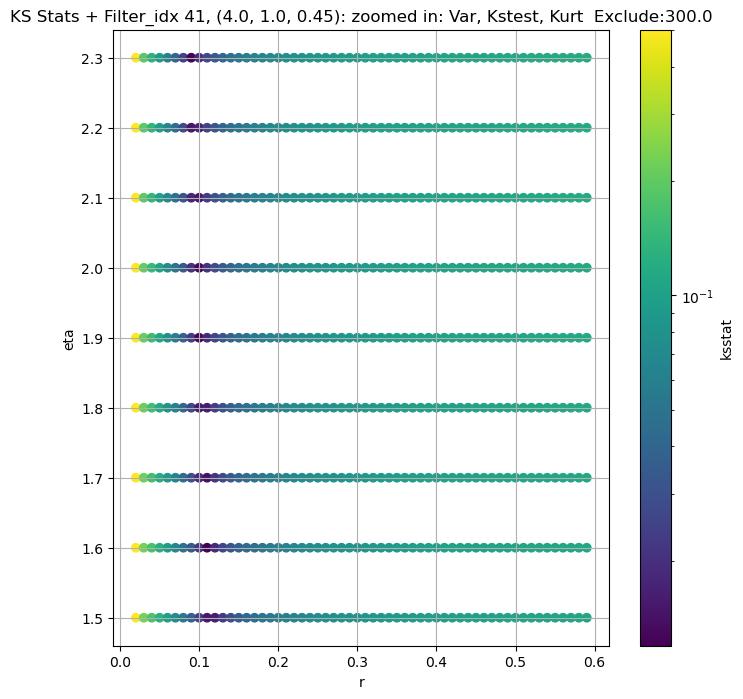

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff,n_pval_0.05
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",17819.649815,14133.666151,22397.163289,5.220748,2.292364,18.383724,97416000.0,"(2.0, 0.5, 0.044)",0.003477,...,4.263534e+02,0.0,17819.649815,0.000138,0.002663,0.40,-0.02,4.387065e+02,0.0,270901
1,"(2.0, 0.5, 0.065)",9613.998902,7362.581520,12698.829090,8.201643,3.945241,18.094728,97416000.0,"(2.0, 0.5, 0.065)",0.002452,...,2.339539e-14,50.0,9320.731672,0.000138,0.002138,0.10,3.70,2.848330e-14,25.0,406356
2,"(2.0, 0.5, 0.096)",5046.436757,3639.541954,6941.209191,14.557165,6.848337,22.125476,97416000.0,"(2.0, 0.5, 0.096)",0.004264,...,4.688553e-14,200.0,4244.786754,0.000138,0.003759,0.09,3.40,8.278913e-17,150.0,135450
3,"(2.0, 0.5, 0.141)",1729.833284,1220.814882,2365.257483,15.329418,7.572456,24.007473,97416000.0,"(2.0, 0.5, 0.141)",0.004407,...,3.729948e-14,200.0,1419.714175,0.000138,0.004139,0.09,3.00,6.578294e-17,175.0,107023
4,"(2.0, 0.5, 0.208)",404.015546,281.860747,555.373326,15.687551,7.403454,60.714712,97416000.0,"(2.0, 0.5, 0.208)",0.004552,...,8.742077e-15,200.0,339.335487,0.000138,0.003895,0.09,3.00,1.572323e-17,150.0,120400
5,"(2.0, 0.5, 0.306)",69.997681,47.011946,117.319540,29.976179,5.976963,184.701280,97416000.0,"(2.0, 0.5, 0.306)",0.004262,...,1.984647e-15,100.0,59.183832,0.000138,0.004075,0.09,2.90,3.442216e-18,100.0,107023
6,"(2.0, 0.5, 0.45)",33.089132,22.658990,72.773299,48.875998,5.926791,289.257781,97416000.0,"(2.0, 0.5, 0.45)",0.003932,...,7.400041e-16,100.0,28.246009,0.000138,0.003852,0.10,2.50,9.471904e-16,75.0,120400
7,"(2.0, 1.0, 0.044)",22268.466854,18051.940989,28577.944689,6.060725,2.436149,35.173910,97416000.0,"(2.0, 1.0, 0.044)",0.003769,...,2.765610e+01,0.0,22268.466854,0.000138,0.002899,0.38,0.00,3.770381e+02,0.0,214047
8,"(2.0, 1.0, 0.065)",10992.351839,8276.177786,14739.030290,9.817106,3.688564,32.816411,97416000.0,"(2.0, 1.0, 0.065)",0.002287,...,1.590383e-14,50.0,10331.210280,0.000138,0.002287,0.10,4.10,1.590383e-14,50.0,361203


In [14]:
master_df_optimized_path = Path(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))

NUM_ITERS = dict(zip(GROUPS, [1]*len(GROUPS))) # By default, does one iteration per group
NUM_SAMPLES_OPTIMIZE = 2000
EXCLUDE_CUTOFFS_OPTIMIZE = np.arange(100, -101, -25)

if RERUN or not master_df_optimized_path.exists():

    if SKIP_OPTIMIZE_STEP:

        master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
        master_df[f'best_r'] = master_df['initial_r']
        master_df[f'best_eta'] = master_df['initial_eta']
        master_df[f'best_scale'] = master_df['initial_scale']
        master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

    else:
        for group in GROUPS: # TODO For quick testing purposes
            print(f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}:")
            master_df.loc[group, 'kstest_stat_best'] = master_df.loc[group, 'kstest_stat_initial']
            master_df.loc[group, 'best_r'] = master_df.loc[group, 'initial_r']
            master_df.loc[group, 'best_eta'] = master_df.loc[group, 'initial_eta']
            master_df.loc[group, 'best_scale'] = master_df.loc[group, 'initial_scale']

            sample = group_data_map[group]
            if len(sample) == 0:
                continue
            initial_r, initial_eta = master_df.loc[group, 'initial_r'], master_df.loc[group, f'initial_eta']
            eps = 0.5
            group_cdfs_df = fine_cdfs_df[(np.abs(master_df.loc[group, 'initial_r'] - fine_cdfs_df['r']) < eps) & 
                                        (np.abs(master_df.loc[group, 'initial_eta'] - fine_cdfs_df['eta']) < eps)].reset_index(drop=True)
            group_cdfs = {x[0]:x[1] for x in group_cdfs_df['(r,eta),cdf']}

            for adjust_exclude_cutoff in EXCLUDE_CUTOFFS_OPTIMIZE: # -50, -25, 0, 25, 50
                
                exclude_cutoff = int(max(0, adjust_exclude_cutoff + master_df.loc[group, 'initial_exclude_cutoff']))
                
                if exclude_cutoff == 0:
                    augmented_var = np.var(group_data_map[group])
                else:
                    augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])                       

                group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
                ksstats, initial_param, min_stat = gridsearch(sample, group_cdfs, debug=True, scales=group_cdfs_df['scale'])
                
                cutoff_label = generate_cutoff_label(adjust_exclude_cutoff)

                augmented_var_df.loc[group, f"kstest_stat_{cutoff_label}"] = min_stat
                group_cdfs_df[f'ksstat_exclude_{cutoff_label}'] = ksstats
                
                print(f"{GROUP} {group}, {master_df.loc[group, 'initial_exclude_cutoff']} + {adjust_exclude_cutoff} = {exclude_cutoff}, ksstat: {min_stat}, var: {augmented_var}")
                best_adjust = 0

                if min_stat < master_df.loc[group, 'kstest_stat_best']:

                    inital_min_stat = min_stat
                    inital_best_param = initial_param
                    master_df.loc[group, 'kstest_stat_best'] = min_stat
                    initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                    master_df.loc[group, 'best_r'], master_df.loc[group, 'best_eta'] = initial_param
                    master_df.loc[group, 'best_scale'] = initial_scale
                    master_df.loc[group, 'best_exclude_cutoff'] = exclude_cutoff
                    master_df.loc[group, 'best_augmented_var'] = augmented_var
                    augmented_var_df.loc[group, 'best_augmented_var'] = augmented_var
                    best_adjust = adjust_exclude_cutoff

                if exclude_cutoff == 0:
                    break

            cutoff_label = generate_cutoff_label(best_adjust)
            ksstats = group_cdfs_df[f"ksstat_exclude_{cutoff_label}"]
            
            print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
            
            cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
            master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

            best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

            group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
            group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

            group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

            group_dict = rEtaKsstats_dict[group]
            group_dict.update({'r_optimize' : group_cdfs_df['r'], 'eta_optimize' : group_cdfs_df['eta'], f'ksstat_exclude_{cutoff_label}' : ksstats})
            rEtaKsstats_dict[group] = group_dict

            cols = ['pass_var', 'pass_kstest', 'pass_kurt']
            fig = combo_test_plot(group_cdfs_df, cols, 
                                plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: zoomed in: {', '.join([col[5:].capitalize() for col in cols])}  Exclude:{master_df.loc[group, 'best_exclude_cutoff']}",
                                best_param=(master_df.loc[group, 'best_r'], master_df.loc[group, f'best_eta']),
                                best_ksstat=master_df.loc[group, 'kstest_stat_best'])
            fig.figure.savefig(os.path.join(CWD, "plots", f"optimized_full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)
            
    master_df['n_pval_0.05'] = master_df.apply(lambda row : find_n_fixed_pval_stat(row.loc['kstest_stat_best'], row.loc['total_samples']), axis = 1)    
    master_df[['total_samples', 'initial_r', 'initial_eta', 'kstest_stat_initial', 'initial_exclude_cutoff', 'best_r', 'best_eta', 'best_scale', 'kstest_stat_best', 'best_exclude_cutoff', 'n_pval_0.05']].to_csv(os.path.join(CWD, "CSVs", 'optimized_params.csv'))
    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))
    augmented_var_df.to_csv(augmented_var_df_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)

rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df = pd.read_csv(master_df_optimized_path, index_col = GROUP)
augmented_var_df = pd.read_csv(augmented_var_df_path, index_col = GROUP)
master_df

## Comparing Empirical and Computed CDF/PDF

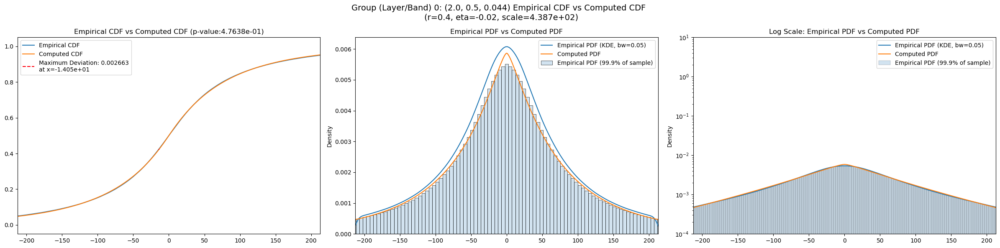

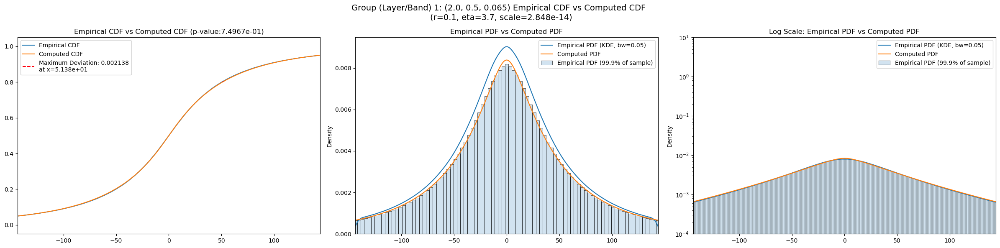

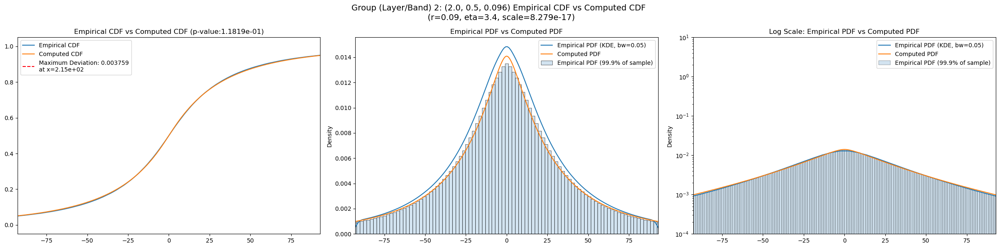

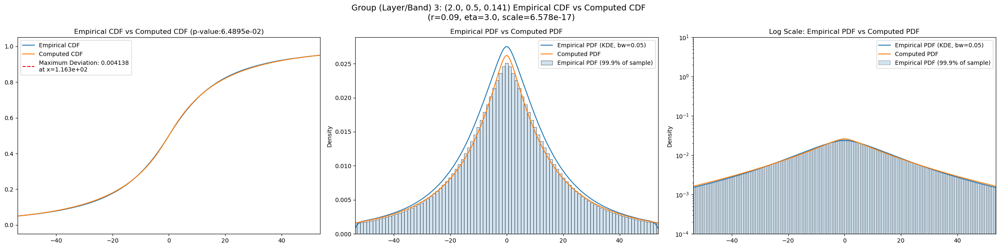

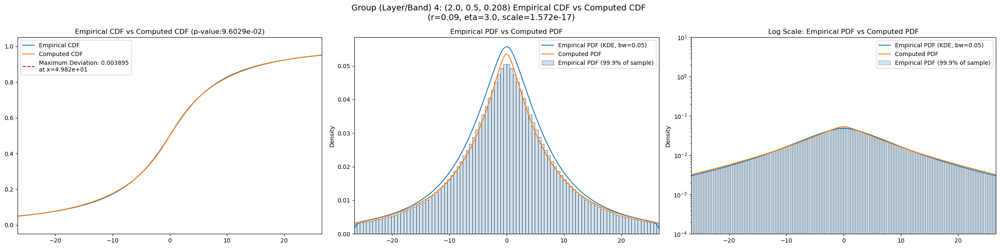

...

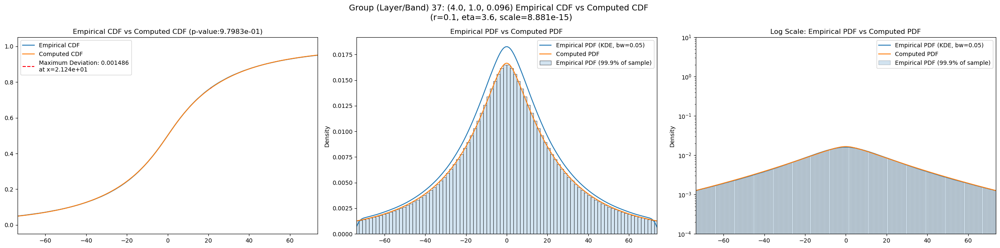

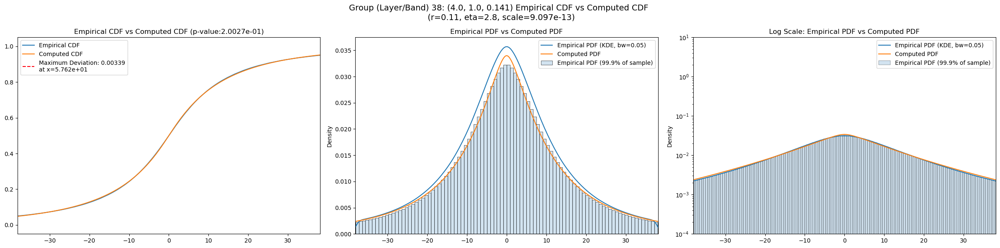

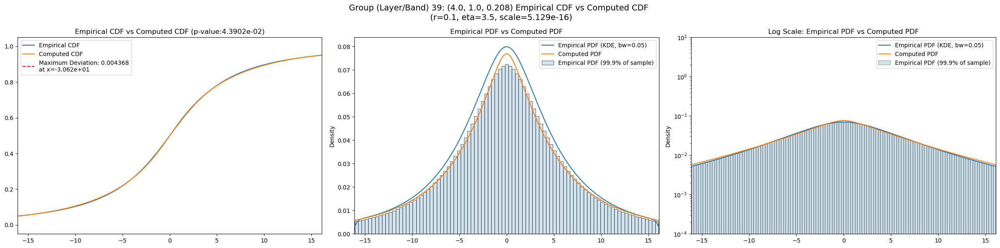

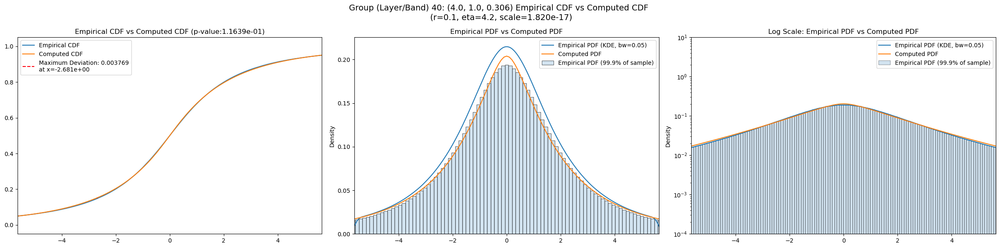

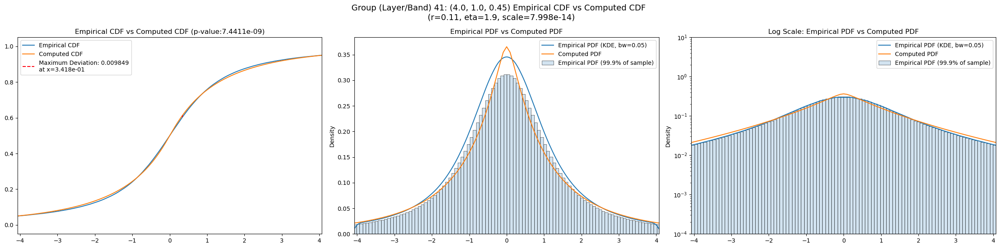

In [15]:
for group in GROUPS:
    group_info = master_df.loc[group]
    best_r = group_info['best_r']
    best_eta = group_info['best_eta']
    best_scale = group_info['best_scale']
    fig = visualize_cdf_pdf(sample = group_data_map[group], 
                    params = (best_r, best_eta, best_scale), 
                    log_scale = True,
                    group = f"{group}: {filter_group_map[group]}")
    fig.savefig(os.path.join(CWD, "plots", f'compare_cdf_pdf_layer_{group}.jpg'), bbox_inches = 'tight', dpi = 100)

## Comparing with Gaussian and Laplace Priors

In [16]:
def generate_func(sample, distro, *args, n_samples=200):
    if distro == 'gaussian' or distro == 'normal':
        def var_func(var):
            cdf = scipy.stats.norm(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'laplace':
        def var_func(var):
            cdf = scipy.stats.laplace(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 't':
        def var_func(var):
            cdf = scipy.stats.t(df=2, scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'prior_r':
        eta = args[0]
        def r_func(r):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return r_func
    elif distro == 'prior_eta':
        r = args[0]
        def eta_func(eta):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return eta_func
    elif distro == 'prior':
        def r_eta_func(params):
            r = params[0]
            eta = params[1]
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample, cdf)
        return r_eta_func
    elif distro == 'prior_with_scale':
        def r_eta_scale_func(params):
            r = params[0]
            eta = params[1]
            scale = params[2]
            print(r, eta, scale)
            cdf = compute_prior_cdf(r = r, eta = eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample/ np.sqrt(scale), cdf)
        return r_eta_scale_func

    print("Please enter a valid argument for `distro`: 'gaussian', 'laplace', 'prior_r', 'prior_eta', 'prior','prior_with_scale', 't'")

In [17]:
master_df_path = Path(os.path.join(CWD, "CSVs", 'master_df.csv'))

if RERUN or not master_df_path.exists():
    upper_bound = int(1e6)
    for group in GROUPS:
        if len(group_data_map[group]) == 0:
            continue
        norm_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'gaussian'), method = 'bounded', bounds = (0, upper_bound))
        laplace_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'laplace'), method = 'bounded', bounds = (0, upper_bound))
        t_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 't'), method = 'bounded', bounds = (0, upper_bound))
        
        master_df.loc[group, 'param_gaussian'] = round_to_sigfigs(norm_result['x'], 6)
        master_df.loc[group, 'kstest_stat_gaussian'] = round_to_sigfigs(norm_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_gaussian'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_gaussian']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6) 

        master_df.loc[group, 'param_t'] = round_to_sigfigs(t_result['x'], 6)
        master_df.loc[group, 'kstest_stat_t'] = round_to_sigfigs(t_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_t'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_t']), 6) 

        master_df.loc[group, 'kstest_pval_gengamma'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_best']))

    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df.csv'))
    
master_df = pd.read_csv(os.path.join(CWD, "CSVs", 'master_df.csv'), index_col = GROUP)
master_df

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,param_gaussian,kstest_stat_gaussian,kstest_pval_gaussian,param_laplace,kstest_stat_laplace,kstest_pval_laplace,param_t,kstest_stat_t,kstest_pval_t,kstest_pval_gengamma
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",17819.649815,14133.666151,22397.163289,5.220748,2.292364,18.383724,97416000.0,"(2.0, 0.5, 0.044)",0.003477,...,98.43310,0.035896,0.0,85.80850,0.008557,0.0,70.63740,0.008619,0.0,0.000000e+00
1,"(2.0, 0.5, 0.065)",9613.998902,7362.581520,12698.829090,8.201643,3.945241,18.094728,97416000.0,"(2.0, 0.5, 0.065)",0.002452,...,66.11070,0.035827,0.0,58.00190,0.010348,0.0,47.13570,0.007362,0.0,0.000000e+00
2,"(2.0, 0.5, 0.096)",5046.436757,3639.541954,6941.209191,14.557165,6.848337,22.125476,97416000.0,"(2.0, 0.5, 0.096)",0.004264,...,41.52320,0.038082,0.0,36.66070,0.013311,0.0,29.40210,0.008831,0.0,0.000000e+00
3,"(2.0, 0.5, 0.141)",1729.833284,1220.814882,2365.257483,15.329418,7.572456,24.007473,97416000.0,"(2.0, 0.5, 0.141)",0.004407,...,23.24320,0.040714,0.0,20.55560,0.015747,0.0,16.38440,0.011180,0.0,0.000000e+00
4,"(2.0, 0.5, 0.208)",404.015546,281.860747,555.373326,15.687551,7.403454,60.714712,97416000.0,"(2.0, 0.5, 0.208)",0.004552,...,11.40290,0.041516,0.0,10.07360,0.016395,0.0,8.04066,0.011777,0.0,0.000000e+00
5,"(2.0, 0.5, 0.306)",69.997681,47.011946,117.319540,29.976179,5.976963,184.701280,97416000.0,"(2.0, 0.5, 0.306)",0.004262,...,4.71408,0.042411,0.0,4.16287,0.016981,0.0,3.32791,0.012663,0.0,0.000000e+00
6,"(2.0, 0.5, 0.45)",33.089132,22.658990,72.773299,48.875998,5.926791,289.257781,97416000.0,"(2.0, 0.5, 0.45)",0.003932,...,3.26741,0.043119,0.0,2.88112,0.017426,0.0,2.30917,0.013263,0.0,0.000000e+00
7,"(2.0, 1.0, 0.044)",22268.466854,18051.940989,28577.944689,6.060725,2.436149,35.173910,97416000.0,"(2.0, 1.0, 0.044)",0.003769,...,109.02000,0.036636,0.0,95.04010,0.009464,0.0,78.04910,0.008832,0.0,0.000000e+00
8,"(2.0, 1.0, 0.065)",10992.351839,8276.177786,14739.030290,9.817106,3.688564,32.816411,97416000.0,"(2.0, 1.0, 0.065)",0.002287,...,71.75500,0.034545,0.0,62.66200,0.009276,0.0,51.21380,0.005756,0.0,0.000000e+00


## Results

In [18]:
import pandas as pd
import os
master_df = pd.read_csv(os.path.join(os.getcwd(), "CSVs", 'master_df.csv'), index_col = 0)

In [19]:
master_df.filter(regex="kstest_stat.*")

,kstest_stat_initial,kstest_stat_cutoff_0.05,kstest_stat_best,kstest_stat_gaussian,kstest_stat_laplace,kstest_stat_t
filter_idx,,,,,,
0,0.003477,0.000138,0.002663,0.035896,0.008557,0.008619
1,0.002452,0.000138,0.002138,0.035827,0.010348,0.007362
2,0.004264,0.000138,0.003759,0.038082,0.013311,0.008831
3,0.004407,0.000138,0.004139,0.040714,0.015747,0.011180
4,0.004552,0.000138,0.003895,0.041516,0.016395,0.011777
5,0.004262,0.000138,0.004075,0.042411,0.016981,0.012663
6,0.003932,0.000138,0.003852,0.043119,0.017426,0.013263
7,0.003769,0.000138,0.002899,0.036636,0.009464,0.008832
8,0.002287,0.000138,0.002287,0.034545,0.009276,0.005756


In [20]:
master_df.filter(regex="best.*")

,best_augmented_var,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff
filter_idx,,,,,,
0,17819.649815,0.002663,0.40,-0.02,4.387065e+02,0.0
1,9320.731672,0.002138,0.10,3.70,2.848330e-14,25.0
2,4244.786754,0.003759,0.09,3.40,8.278913e-17,150.0
3,1419.714175,0.004139,0.09,3.00,6.578294e-17,175.0
4,339.335487,0.003895,0.09,3.00,1.572323e-17,150.0
5,59.183832,0.004075,0.09,2.90,3.442216e-18,100.0
6,28.246009,0.003852,0.10,2.50,9.471904e-16,75.0
7,22268.466854,0.002899,0.38,0.00,3.770381e+02,0.0
8,10331.210280,0.002287,0.10,4.10,1.590383e-14,50.0
